In [1]:
import pandas as pd
import xml.etree.ElementTree as ET
import os
from urllib.request import urlretrieve as download
from glob import glob as g
from Bio.Blast import NCBIWWW, NCBIXML
from mypdb import PDB_file as mypdb
from Bio.Blast.Applications import NcbipsiblastCommandline
from time import time as t
from tqdm import tqdm


import glob
import xml.etree.ElementTree as ET
from collections import defaultdict

import re
import MDAnalysis as mda
from time import time as t

d:\miniforge3\envs\proj\Lib\site-packages\Bio\Application\__init__.py:39: BiopythonDeprecationWarning: The Bio.Application modules and modules relying on it have been deprecated.

Due to the on going maintenance burden of keeping command line application
wrappers up to date, we have decided to deprecate and eventually remove these
modules.

We instead now recommend building your command line and invoking it directly
with the subprocess module.
  warnings.warn(


In [ ]:
#Class to handle and download the hits from a blast search



def merge_dicts(dict1, dict2):
    for k2, v2 in dict2.items():
        if k2 in dict1:
            if isinstance(dict1[k2], list):
                dict1[k2].append(v2)
            else:
                dict1[k2] = [dict1[k2], v2]
        else:
            print(f"New Key : {k2}")
            dict1[k2] = v2
    return dict1

class hit:
    def __init__(self, xml_hit):
        self.hit_num = xml_hit[0].text
        pdb_info = xml_hit[1].text.split("|")[1:]
        self.pdb_id = pdb_info[0]
        self.pdb_chain = pdb_info[1]
        self.description = xml_hit[2].text
        data = [[y.tag.replace("Hsp_", ""), y.text] for y in xml_hit[5][0]]
        self.data = dict(data)
        self.pdb = None
        self._not_exists = False

    @staticmethod
    def download2(code, pdir=None):
        base_url = "https://files.rcsb.org/download"
        pdb_url = f"{base_url}/{code}.pdb"
        f_p = os.path.join(pdir, f"{code}.pdb")
        try:
            download(pdb_url, f_p)
            return f_p  # Return the file path if succeeded
        except Exception:
            print(f"File {code} not found.")
            return None  # Return None if failed

    def _assign(self, f_p):
        self.pdb_path = f_p
        self.pdb = mypdb(f_p)
        
    def check_for_pdb(self, pdir=None):
        if pdir is None:
            pdir = "./pdbs/"
        elif pdir[-1] != "/":
            pdir += "/"
        if not os.path.isdir(pdir):
            os.makedirs(pdir, exist_ok=True)
        matches = g(pdir + f"{self.pdb_id}*")
        if matches:
            if not self.pdb:
                self._assign(matches[0])
            return True
        else:
            return False

In [ ]:
#Class to handle the blast search
class blast:
    def __init__(self, sequence, name, database, path, program="blastp", hitlen=10000):
        self.sequence = sequence
        self.program = program
        self.database = database
        self.path = path
        self.name = name
        self.hitlen = hitlen

        if program == "blastp" and (self.path and os.path.isfile(self.path)):
            self.parse_search()
        elif program == "psiblast":
            self.psiblast_search()
        else:
            self.bsearch()

    def bsearch(self):
        # Perform the initial BLASTP search
        if self.program == "blastp":
            print("Searching BLASTP...")
            t1 = t()
            self.results = NCBIWWW.qblast(self.program, self.database, self.sequence, hitlist_size=self.hitlen)
            t2 = t()
            print(f"BLASTP took {round(t2-t1,4)} seconds")
            if not self.path:
                self.path = f"{self.name}-blast.xml"
            with open(self.path, "w") as output_xml:
                output_xml.write(self.results.read())
            self.parse_search()

    def psiblast_search(self):
        # Run local PSI-BLAST using NcbipsiblastCommandline
        print(f"Running PSI-BLAST on {self.name}...")
        input_fasta = f"{self.name}.fasta"
        with open(input_fasta, "w") as f:
            f.write(f">query\n{self.sequence}\n")

        psiblast_cline = NcbipsiblastCommandline(
            query=input_fasta,
            db="/home/marmatt/ncbi-blast-2.16.0+/bin/pdbaa",
            evalue=10,
            num_iterations=3,
            out_ascii_pssm=f"{self.name}.pssm",
            out=f"{self.name}-psiblast.xml",
            outfmt=5
        )
        stdout, stderr = psiblast_cline()
        if stderr:
            print(f"PSI-BLAST ERROR: {stderr}")
        else:
            print("PSI-BLAST search completed.")
            self.parse_search(xml_file=f"{self.name}-psiblast.xml")

    def parse_search(self, xml_file=None):
        xml_file = xml_file or self.path
        if not xml_file:
            raise Exception("No XML file path provided.")
        t1 = t()
        tree = ET.parse(xml_file)
        iteration = tree.findall("./BlastOutput_iterations/Iteration/")
        self.query_length = iteration[3].text
        hits = [hit(x) for x in iteration[-2]] #returns hit objects
        self.hits = hits
        mega_dict = hits[0].data
        for x in hits[1:]:
            mega_dict = merge_dicts(mega_dict, x.data)
        mega_dict["PDB ID"] = [x.pdb_id for x in hits]
        mega_dict["Chain"] = [x.pdb_chain for x in hits]
        mega_dict["Description"] = [x.description for x in hits]
        self.df = pd.DataFrame.from_dict(mega_dict)
        print(self.df)
        t2 = t()
        print(f"Time taken to parse {t2-t1}")
    
    def download_pdbs(self, pdir=None):
        default_dir = "./PDBs"
        pdir = os.path.abspath(pdir if pdir else default_dir)
        if not os.path.isdir(pdir):
            os.makedirs(pdir, exist_ok=True)
        
        files = [os.path.splitext(f)[0] for f in os.listdir(pdir)]
        hit_bar = tqdm(self.hits, desc="Processing Hits")
        
        for x in hit_bar:
            if x.pdb_id not in files:
                hit_bar.set_description(f"Downloading {x}")
                
                try:
                    file_path = x.download2(x.pdb_id, pdir=pdir)

                    if file_path:
                        x._assign(file_path)
                    else:
                        # In case download2 does not return a valid path
                        raise Exception("Download failed")
                except Exception as e:
                    # Print a message if download fails or file path is invalid
                    print(f"Structure {x.pdb_id} was not found...")

## Actually running the blast search

In [ ]:

"""
Here we perform a blast search on:
 1.   The BRAF monomer
"""
with open("./fastas.txt") as f:
    fastas = f.readlines()

braf_fasta = fastas[1]
name = "braf"

# Directory for storing blast search results
output_dir = "./blast_search"
# Ensure the directory exists
os.makedirs(output_dir, exist_ok=True)

res_path = os.path.join(output_dir, f"{name}-blast.xml")  # Path for the results file

# Check for saved results in the specified directory
if os.path.exists(res_path):
    bs = blast(braf_fasta, name, database="pdb", path=res_path)
else:
    bs = blast(braf_fasta, name, database="pdb", path=None)

bs.download_pdbs()

## Counting the number of pdb files in the directory

In [ ]:


import glob
def count_pdb_files(directory):
    # Ensure the directory path ends with a slash
    directory = os.path.join(directory, '')

    # Use glob to find all .pdb files in the directory
    pdb_files = glob.glob(os.path.join(directory, '*.pdb'))

    # Return the count of .pdb files
    return len(pdb_files)

# Specify the directory
pdb_directory = 'PDBs'

# Get the count of PDB files
pdb_count = count_pdb_files(pdb_directory)

print(f"There are {pdb_count} PDB files in the directory '{pdb_directory}'.")

## Counting the number of pdb hits in the xml file and checking which ones have not been downloaded


In [ ]:


def count_pdb_files(directory):
    # Use glob to find all .pdb files in the directory
    pdb_files = glob.glob(os.path.join(directory, '*.pdb'))

    # Extract the base filenames (without extension) to compare with PDB IDs
    pdb_file_ids = {os.path.splitext(os.path.basename(f))[0] for f in pdb_files}

    return pdb_file_ids

def find_unique_and_duplicate_pdb_hit_ids(xml_file):
    # Parse the XML file
    tree = ET.parse(xml_file)
    root = tree.getroot()

    # Dictionary to count occurrences of each PDB hit ID
    hit_id_counts = defaultdict(int)

    # Iterate over all Hit elements in the XML
    for hit in root.findall('.//Hit'):
        # Extract the Hit_id text
        hit_id = hit.find('Hit_id').text

        # Assuming the Hit_id format is 'pdb|PDB_ID|Chain', extract the PDB_ID
        pdb_id = hit_id.split('|')[1]

        # Increment the count for this PDB_ID
        hit_id_counts[pdb_id] += 1

    # Find all PDB IDs (unique and duplicates)
    all_hit_ids = set(hit_id_counts.keys())

    return all_hit_ids

# Specify the directory and XML file
pdb_directory = 'PDBs'
xml_file = 'braf-blast.xml'

# Get the PDB file IDs from the directory
pdb_file_ids = count_pdb_files(pdb_directory)

# Get all PDB hit IDs from the XML
all_pdb_ids = find_unique_and_duplicate_pdb_hit_ids(xml_file)

# Calculate the number of total PDB hits
total_pdb_hits = len(all_pdb_ids)

# Find PDB IDs in XML that are not in the directory
missing_pdb_ids = all_pdb_ids - pdb_file_ids

print(f"There are {total_pdb_hits} total PDB hits in the file '{xml_file}'.")
print(f"There are {len(missing_pdb_ids)} PDB IDs in the XML not found in the directory '{pdb_directory}':")
print(missing_pdb_ids)


## Here we are stripping the downloaded pdb files to only contain the chain of interest


In [ ]:
import os
from glob import glob
import re
import MDAnalysis as mda
from time import time as t
!ls
def sglob(fp, absolute=True):
    fps = sorted(glob(fp))
    if absolute:
        fps = [os.path.abspath(f) for f in fps]
    return fps

def strip_to_chain(pdb_file, chain_ID):
    u = mda.Universe(pdb_file)
    print(f"Loaded trajectory from {pdb_file} with {len(u.atoms)} atoms.")

    chain = u.select_atoms(f"protein and chainID {chain_ID}")
    if len(chain) == 0:
        print(f"Chain {chain_ID} not found in {pdb_file}.")
        return None
    return chain

def post_process(fname):
    with open(fname, "r") as f_o:
        initial_lines = f_o.readlines()

    print(f"File {fname} before post_process, first few lines:")
    print("".join(initial_lines[:20]))

    final_lines = initial_lines[-2:].copy()
    no_ter = [line for line in initial_lines if line[:3] != "TER" or line in final_lines]

    if len(no_ter) != len(initial_lines):
        with open(fname, "w") as f_o:
            print(f"Rewriting {fname}, lines reduced from {len(initial_lines)} to {len(no_ter)}")
            f_o.write("".join(no_ter))

    print(f"File {fname} after post_process, first few lines:")
    with open(fname, "r") as f_r:
        print("".join(f_r.readlines()[:20]))

def parse_xml(xml_file):
    hit_id = re.compile(r"<Hit_id>(.*?)<.Hit_id>")
    with open(xml_file, "r") as f:
        text = f.read()
        results = [h.split("|")[1:] for h in hit_id.findall(text)]
        pdb_chain_dict = {}
        for r in results:
            pdb_chain_dict[r[0]+f"_{r[1]}"] = r[1]
    return pdb_chain_dict

def get_pdb_id(fp):
    fp = fp.rsplit(".", 1)[0]
    if "/" in fp:
        fp = fp.rsplit("/", 1)[1]
    return fp

def target_name(fp, target_dir, chain):
    orig_path, file_name = fp.rsplit("/", 1)
    fp = fp.replace(orig_path, target_dir)
    fp = fp.split(".")[0] + f"_{chain}.pdb"
    return fp

def find_pdb_file(PDB_chain_id, files):
    print(files)
    if "_" in PDB_chain_id:
        PDB_id = PDB_chain_id.split("_")[0]
    assert len(PDB_id) == 4
    for f in files:
        filename = os.path.basename(f).split('.')[0]
        if filename.startswith(PDB_id):
            print(f"Found file: {f} for PDB ID: {PDB_id}")
            return f

print("BEGIN")
t1 = t()
xml = "braf-blast.xml"
pdb_dir = "PDBs"
target_dir = "Results/activation_segments/unaligned"

# Ensure the target directory exists
os.makedirs(target_dir, exist_ok=True)

xml_chain_dict = parse_xml(xml)
print(xml_chain_dict)

pdb_files = sorted(sglob("PDBs/*.pdb"))
print(pdb_files)
keys = sorted([*xml_chain_dict.keys()], key=get_pdb_id)

print(keys)
files = [find_pdb_file(k, pdb_files) for k in keys]
print(files)
chain_IDs = [xml_chain_dict[k] for k in keys]
print(len(chain_IDs))

valid_file_chain_pairs = [(f, c) for f, c in zip(files, chain_IDs) if f is not None]
print(len(valid_file_chain_pairs))
new_file_paths = [target_name(f, target_dir, c) for f, c in valid_file_chain_pairs]
print(new_file_paths)
file_paths = [f for f, c in valid_file_chain_pairs]
print(file_paths)
print(len(file_paths))

for (fp, chain_ID, tp) in zip(file_paths, chain_IDs, new_file_paths):
    if fp is not None:
        try:
            print(fp, chain_ID, tp)
            chain = strip_to_chain(fp, chain_ID)
            if chain is not None:
                with mda.Writer(tp) as w:
                    w.write(chain)
                post_process(tp)
        except Exception as e:
            print(f"An error occurred while processing {fp} with chain {chain_ID}: {e}")
        
t2 = t()
t_t = round(t2 - t1, 3) // 60
t_t = str((t_t // 60)) + ":" + str(t_t % 60)
print(f"Time taken {t_t} for sequential processing")


## Counting again how many pdb files are in the directory after stripping the chains

In [ ]:
import glob

def count_pdb_files(directory):
    # Ensure the directory path ends with a slash
    directory = os.path.join(directory, '')

    # Use glob to find all .pdb files in the directory
    pdb_files = glob.glob(os.path.join(directory, '*.pdb'))

    # Return the count of .pdb files
    return len(pdb_files)

# Specify the directory
pdb_directory = 'Results/activation_segments/unaligned'

# Get the count of PDB files
pdb_count = count_pdb_files(pdb_directory)

print(f"There are {pdb_count} PDB files in the directory '{pdb_directory}'.")

In [ ]:
#Extracting the full sequence from the pdb files, checking if there are any non-natural amino acids and substituting them and selecting only sequences with a maximum gap length of 4 amino acids to be reconstructed
from Bio.PDB import PDBParser, PPBuilder
from Bio.SeqUtils import seq1
from glob import glob
from tqdm import tqdm
import os

def substitute_non_natural_amino_acid(residue, aligned_atom, index):
    """Substitute non-natural amino acids with their natural counterparts."""
    substitutions = {
        'X': 'G',  # Glycine
        'B': 'N',  # Asparagine
        'Z': 'Q',  # Glutamine
        'J': 'L'   # Leucine
    }
    
    if residue == 'X':
        # Check if 'X' is surrounded by missing amino acids in aligned_atom
        if index > 0 and aligned_atom[index - 1] == '-':
            return residue
        if index < len(aligned_atom) - 1 and aligned_atom[index + 1] == '-':
            return residue

    return substitutions.get(residue, residue)

def extract_seqres_sequence(pdb_file):
    """Extract SEQRES sequences for each chain from a PDB file."""
    seq_dict = {}
    with open(pdb_file, "r") as file:
        lines = file.readlines()

    current_chain = None
    current_seq = []

    for line in lines:
        if line.startswith("SEQRES"):
            parts = line.split()
            chain_id = parts[2]
            if chain_id != current_chain:
                if current_chain is not None:
                    seq_dict[current_chain] = ''.join(seq1(residue) for residue in current_seq)
                current_chain = chain_id
                current_seq = []
            current_seq.extend(parts[4:])

    if current_chain is not None:
        seq_dict[current_chain] = ''.join(seq1(residue) for residue in current_seq)

    return seq_dict

def extract_atom_sequence(pdb_file, chain_id):
    """Extract sequence from atomic coordinates for a specific chain."""
    parser = PDBParser(QUIET=True)
    structure = parser.get_structure('PDB', pdb_file)
    
    for model in structure:
        chain = model[chain_id]
        
        ppb = PPBuilder()
        sequence = ''
        for pp in ppb.build_peptides(chain):
            sequence += pp.get_sequence()
        return sequence
    return None

def find_motif_indices(sequence, motif):
    """Find the start index of a motif in a sequence."""
    index = sequence.find(motif)
    return index if index != -1 else None

def align_and_highlight_gaps(seqres_segment, atom_segment):
    """Align SEQRES and ATOM segments and highlight gaps in ATOM."""
    aligned_seqres = ''
    aligned_atom = ''
    atom_index = 0
    max_gap_length = 0
    current_gap_length = 0

    for res_seqres in seqres_segment:
        if atom_index < len(atom_segment) and res_seqres == atom_segment[atom_index]:
            aligned_seqres += res_seqres
            aligned_atom += atom_segment[atom_index]
            atom_index += 1
            current_gap_length = 0
        else:
            aligned_seqres += res_seqres
            aligned_atom += '-'
            current_gap_length += 1
            max_gap_length = max(max_gap_length, current_gap_length)

    return aligned_seqres, aligned_atom, max_gap_length

def main():
    target_dir = "Results/activation_segments/unaligned"
    pdb_dir = "PDBs"
    fasta_output_file = "seqres_sequences.fasta"  # File to store full sequences
    text_output_file = "seqres_info.txt"
    aligned_sequences = {}
    satisfying_structures_count = 0

    pdb_files = glob(os.path.join(target_dir, "*.pdb"))

    with open(text_output_file, "w") as text_output, open(fasta_output_file, "w") as fasta_output:
        for pdb_file in tqdm(pdb_files, desc="Processing PDB files"):
            pdb_name = os.path.basename(pdb_file)
            pdb_id, chain_id_file = os.path.splitext(pdb_name)[0].split('_')
            chain_id = chain_id_file

            full_pdb_path = os.path.join(pdb_dir, pdb_id + '.pdb')
            if not os.path.isfile(full_pdb_path):
                print(f"Corresponding full PDB for {pdb_id} not found.")
                continue

            seqres_seqs = extract_seqres_sequence(full_pdb_path)
            atom_seq = extract_atom_sequence(full_pdb_path, chain_id)

            if chain_id in seqres_seqs and atom_seq:
                seqres_sequence = seqres_seqs[chain_id]
                seqres_dfg_index = find_motif_indices(seqres_sequence, 'DFG')
                seqres_ape_index = find_motif_indices(seqres_sequence, 'APE')
                atom_dfg_index = find_motif_indices(atom_seq, 'DFG')
                atom_ape_index = find_motif_indices(atom_seq, 'APE')

                # Determine the start and end indices for the segments
                if None not in [seqres_dfg_index, seqres_ape_index, atom_dfg_index, atom_ape_index]:
                    seqres_start = min(seqres_dfg_index, seqres_ape_index)
                    seqres_end = max(seqres_dfg_index + 3, seqres_ape_index + 3)
                    atom_start = min(atom_dfg_index, atom_ape_index)
                    atom_end = max(atom_dfg_index + 3, atom_ape_index + 3)

                    seqres_segment = seqres_sequence[seqres_start:seqres_end]
                    atom_segment = atom_seq[atom_start:atom_end]

                    aligned_seqres, aligned_atom, max_gap_length = align_and_highlight_gaps(seqres_segment, atom_segment)
                    
                    # Check for differences and substitute non-natural amino acids
                    exclude_due_to_non_natural_diff = False
                    corrected_seqres = ''
                    for index, (res_seqres, res_atom) in enumerate(zip(aligned_seqres, aligned_atom)):
                        if res_seqres != res_atom:
                            corrected_residue = substitute_non_natural_amino_acid(res_seqres, aligned_atom, index)
                            corrected_seqres += corrected_residue
                            if corrected_residue != res_seqres:
                                print(f"Substituting non-natural amino acid '{res_seqres}' with '{corrected_residue}' in SEQRES for {pdb_id}_{chain_id}.")
                        else:
                            corrected_seqres += res_seqres

                    if not exclude_due_to_non_natural_diff and max_gap_length <= 4:
                        satisfying_structures_count += 1
                        info = (f"Aligned Sequences for {pdb_id}_{chain_id}: (Max gap length: {max_gap_length})\n"
                                f"SEQRES Segment: {corrected_seqres}\n"
                                f"ATOM Segment:   {aligned_atom}\n\n")
                        print(info)
                        text_output.write(info)
                        
                        aligned_sequences[f"{pdb_id}_{chain_id}_SEQRES"] = corrected_seqres
                        aligned_sequences[f"{pdb_id}_{chain_id}_ATOM"] = aligned_atom

                        # Write full SEQRES and ATOM sequences to the FASTA file
                        fasta_output.write(f">{pdb_id}_{chain_id}_SEQRES\n{seqres_sequence}\n")
                        fasta_output.write(f">{pdb_id}_{chain_id}_ATOM\n{atom_seq}\n")
                    else:
                        exclusion_msg = f"Excluding {pdb_id}_{chain_id} due to gap length: {max_gap_length} or non-natural amino acid difference.\n"
                        print(exclusion_msg)
                        text_output.write(exclusion_msg)
                else:
                    motif_msg = f"Motifs not found in {pdb_id}_{chain_id}.\n"
                    print(motif_msg)
                    text_output.write(motif_msg)
            else:
                chain_msg = f"Chain {chain_id} not found in SEQRES of {pdb_id} or no atomic sequence available.\n"
                print(chain_msg)
                text_output.write(chain_msg)
                
        count_msg = f"Total structures satisfying the condition: {satisfying_structures_count}"
        text_output.write(count_msg)
        print(count_msg)

if __name__ == '__main__':
    main()


In [ ]:
#COunting how many seqences are in the fasta file
def count_total_pdb_ids(file_path):
    total_pdb_ids = 0

    with open(file_path, 'r') as file:
        for line in file:
            if line.startswith('>'):
                total_pdb_ids += 1

    print(f"Total number of PDB IDs: {int(total_pdb_ids/2)} in {file_path}") #here we divide by 2 because we have two lines per PDB ID

# Provide the path to your seqres_sequence.fasta file
file_path = "seqres_sequences.fasta"
count_total_pdb_ids(file_path)


In [ ]:
#Code to use MODELLER to reconstruct the sequences that have a gap length of 4 or less, if there are no differences between the SEQRES and ATOM sequences, the original PDB file is copied to the target directory
# FIX was to eliminate remarks from the pdb file
import os
import shutil
from Bio.PDB import PDBParser, PPBuilder
from modeller import *
from modeller.automodel import *

def read_fasta_sequences(fasta_file):
    """Read sequences from a FASTA file into a dictionary."""
    sequences = {}
    with open(fasta_file, "r") as f:
        lines = f.readlines()
        header = None
        sequence = []
        for line in lines:
            line = line.strip()
            if line.startswith(">"):
                if header:
                    sequences[header] = ''.join(sequence)
                header = line[1:]
                sequence = []
            else:
                sequence.append(line)
        if header:
            sequences[header] = ''.join(sequence)
    return sequences

def extract_atom_sequence(pdb_file):
    """Extract sequence from atomic coordinates for the first chain found in the PDB file."""
    parser = PDBParser(QUIET=True)
    structure = parser.get_structure('PDB', pdb_file)
    
    for model in structure:
        for chain in model:
            ppb = PPBuilder()
            sequence = ''
            for pp in ppb.build_peptides(chain):
                sequence += pp.get_sequence()
            return str(sequence)
    return None

def find_motif_indices(sequence, motif):
    """Find the start index of a motif in a sequence."""
    index = sequence.find(motif)
    return index if index != -1 else None

def reconstruct_with_modeller(pdb_chain_id, pdb_path, target_path, full_sequence, atom_sequence):
    print(f"Processing {pdb_chain_id}")

    # Find indices of the DFG and APE motifs
    seqres_dfg_index = find_motif_indices(full_sequence, 'DFG')
    seqres_ape_index = find_motif_indices(full_sequence, 'APE')
    atom_dfg_index = find_motif_indices(atom_sequence, 'DFG')
    atom_ape_index = find_motif_indices(atom_sequence, 'APE')

    # Determine if reconstruction is needed
    if None not in [seqres_dfg_index, seqres_ape_index, atom_dfg_index, atom_ape_index]:
        seqres_start = min(seqres_dfg_index, seqres_ape_index)
        seqres_end = max(seqres_dfg_index + 3, seqres_ape_index + 3)
        atom_start = min(atom_dfg_index, atom_ape_index)
        atom_end = max(atom_dfg_index + 3, atom_ape_index + 3)

        seqres_segment = full_sequence[seqres_start:seqres_end]
        atom_segment = atom_sequence[atom_start:atom_end]

        # Check for differences in the segment
        if seqres_segment != atom_segment:
            print(f"Reconstructing full sequence for {pdb_chain_id} using MODELLER")

            # Setting up MODELLER
            env = environ()
            aln = alignment(env)
            
            # Read the structure to work on
            mdl = model(env, file=pdb_path)
            aln.append_model(mdl, align_codes='template', atom_files=pdb_path)

            # Append the full target sequence
            aln.append_sequence(full_sequence)
            aln[-1].code = 'target'
            
            # Perform the alignment
            aln.align2d(max_gap_length=50)

            # Create AutoModel object and build models
            a = automodel(env, alnfile=aln, knowns='template', sequence='target')
            a.starting_model = 1
            a.ending_model = 1
            
            # Build the model
            a.make()
            
            # Save the best model to the target directory
            model_path = os.path.join(target_path, f"{pdb_chain_id}_filled.pdb")
            os.rename(a.outputs[0]['name'], model_path)
            print(f"Reconstruction completed for {pdb_chain_id}. File saved at {model_path}")

            # Post-process to remove REMARK lines
            remove_remark_lines(model_path)
        else:
            # No reconstruction needed, copy original PDB
            shutil.copy(pdb_path, os.path.join(target_path, f"{pdb_chain_id}.pdb"))
            print(f"No differences found for {pdb_chain_id}. Original PDB copied to target directory.")
    else:
        print(f"Motifs not found in {pdb_chain_id}.")

def remove_remark_lines(pdb_file):
    """Remove lines starting with 'REMARK' from the PDB file."""
    with open(pdb_file, 'r') as file:
        lines = file.readlines()
    
    with open(pdb_file, 'w') as file:
        for line in lines:
            if not line.startswith("REMARK"):
                file.write(line)
    
    print(f"Removed REMARK lines from {pdb_file}")

def main():
    seqres_fasta = "seqres_sequences.fasta"
    pdb_dir = "Results/activation_segments/unaligned"
    target_dir = "Results/activation_segments/reconstructedModeller"

    # Read the sequences from the FASTA file
    seqres_sequences = read_fasta_sequences(seqres_fasta)

    for header, full_sequence in seqres_sequences.items():
        if "_SEQRES" in header:  # Only consider SEQRES entries
            pdb_chain_id = header.replace("_SEQRES", "")
            pdb_file_path = os.path.join(pdb_dir, f"{pdb_chain_id}.pdb")

            # Extract the atomic sequence
            atom_sequence = extract_atom_sequence(pdb_file_path)

            if atom_sequence is None:
                print(f"Could not extract sequence for {pdb_chain_id}. Skipping...")
                continue

            if not os.path.exists(target_dir):
                os.makedirs(target_dir)
            
            reconstruct_with_modeller(pdb_chain_id, pdb_file_path, target_dir, full_sequence, atom_sequence)

    print("Processing complete!")

if __name__ == '__main__':
    main()


In [1]:
#Counting the number of pdb files in the directory after reconstruction
import glob
import os
def count_pdb_files(directory):
    # Ensure the directory path ends with a slash
    directory = os.path.join(directory, '')

    # Use glob to find all .pdb files in the directory
    pdb_files = glob.glob(os.path.join(directory, '*.pdb'))

    # Return the count of .pdb files
    return len(pdb_files)

# Specify the directory
pdb_directory = 'Results/activation_segments/reconstructedModeller'

# Get the count of PDB files
pdb_count = count_pdb_files(pdb_directory)

print(f"There are {pdb_count} PDB files in the directory '{pdb_directory}'.")

There are 3845 PDB files in the directory 'Results/activation_segments/reconstructedModeller'.


In [2]:
#Fast checking if reconstruction was successful, need to just change the pdb id and chain id
import MDAnalysis as mda
import nglview as nv
from Bio.PDB import PDBParser
from MDAnalysis.analysis import align

# Dictionary to convert three-letter amino acid codes to one-letter codes
three_to_one = {
    'ALA': 'A', 'ARG': 'R', 'ASN': 'N', 'ASP': 'D',
    'CYS': 'C', 'GLU': 'E', 'GLN': 'Q', 'GLY': 'G',
    'HIS': 'H', 'ILE': 'I', 'LEU': 'L', 'LYS': 'K',
    'MET': 'M', 'PHE': 'F', 'PRO': 'P', 'SER': 'S',
    'THR': 'T', 'TRP': 'W', 'TYR': 'Y', 'VAL': 'V'
}

def extract_sequence_and_mapping(pdb_file):
    """Extract sequence and create a mapping from sequence index to PDB residue ID."""
    parser = PDBParser(QUIET=True)
    structure = parser.get_structure('PDB', pdb_file)
    
    sequence = []
    index_to_resid = {}
    
    for model in structure:
        for chain in model:
            for residue in chain:
                if 'CA' in residue:  # Check if it's an amino acid
                    resname = residue.get_resname()
                    if resname in three_to_one:
                        sequence.append(three_to_one[resname])
                        index_to_resid[len(sequence) - 1] = residue.get_id()[1]  # Map sequence index to PDB resid
            break
        break

    return sequence, index_to_resid

def find_motif_indices(sequence, motif):
    """Find the start index of a motif in a sequence."""
    sequence_str = ''.join(sequence)
    index = sequence_str.find(motif)
    return index if index != -1 else None

# Extract the sequence and mapping for the single chain
atom_sequence, index_to_resid = extract_sequence_and_mapping("Results/activation_segments/unaligned/7OPO_A.pdb")

# Find indices of DFG and APE motifs
dfg_index = find_motif_indices(atom_sequence, 'DFG')
ape_index = find_motif_indices(atom_sequence, 'APE')

# Ensure indices are found and select the residues between them
if dfg_index is not None and ape_index is not None:
    # Use the mapping to get the correct residue IDs
    dfg_resid = index_to_resid[dfg_index]
    ape_resid = index_to_resid[ape_index + 2]  # +2 to include the entire 'APE' motif

    u_missing = mda.Universe("Results/activation_segments/unaligned/7OPO_A.pdb")
    selected_atoms = u_missing.select_atoms(f"resid {dfg_resid}:{ape_resid}")

    print("Number of Atoms Selected:", selected_atoms.n_atoms)

    u_reconstructed = mda.Universe("Results/activation_segments/reconstructedModeller/7OPO_A_filled.pdb")
    print("Number of Atoms Reconstructed:", u_reconstructed.select_atoms(f"all").n_atoms)

    # Merge the aligned atoms for visualization
    merged = mda.Merge(selected_atoms, u_reconstructed.atoms)
    print(merged.residues)

    # Create NGLView widget
    w = nv.show_mdanalysis(merged)

    # Add a representation for each residue name with the corresponding color
    w.clear()
    w.add_cartoon(color="resname")

    

else:
    print("Motifs not found in the sequence.")

w

d:\miniforge3\envs\proj\Lib\site-packages\Bio\Application\__init__.py:39: BiopythonDeprecationWarning: The Bio.Application modules and modules relying on it have been deprecated.

Due to the on going maintenance burden of keeping command line application
wrappers up to date, we have decided to deprecate and eventually remove these
modules.

We instead now recommend building your command line and invoking it directly
with the subprocess module.
  warnings.warn(


Number of Atoms Selected: 206
Number of Atoms Reconstructed: 2558
<ResidueGroup [<Residue ASP, 211>, <Residue PHE, 212>, <Residue GLY, 213>, ..., <Residue GLY, 315>, <Residue ARG, 316>, <Residue PRO, 317>]>


NGLWidget()

In [7]:
#Helper functions and function to run MUSTANG on the reconstructed pdb files

import subprocess
import os
from glob import glob as g
import mdtraj as md
from mpi4py import MPI
from time import time as t
from tqdm import tqdm


def sg(f_p):
    return sorted(g(f_p))


def find_pdbs(directory):
    """
    Find topologies in a directory.
    Currently excludes cif files.
    """
    return sg(directory+"/*.pdb")


def fname(file):
    return file.rsplit(".", 1)[0].rsplit("/", 1)[-1]


def ifnotmake(dir_path):
    if not os.path.isdir(dir_path):
        os.makedirs(dir_path)
    return dir_path


def run_mustang(f1, f2, name=None):
    """
    Writes a MUSTANG input file which aligns
    file1 to file 2.
    If no name defaults to the second file.
    """
    if name is None:
        name = fname(f2)
    if not os.path.isdir(f"./{name}"):
        os.makedirs(f"./{name}")
    new_fp = f"./{name}/{name}"
    structs = f"{f1} {f2} "
    command = f"/home/marmatt/Downloads/MUSTANG_v3.2.4/bin/mustang-3.2.4 -i {structs} -o {new_fp} -F fasta -s ON" #here you should change the path to where you install MUSTANG
    command = command.split()
    new_fp = f"{new_fp}.pdb"
    try:
        result = subprocess.run(command, capture_output=True, text=True)
        print(f"Running command: {' '.join(command)}")
        print(f"STDOUT: {result.stdout}")
        print(f"STDERR: {result.stderr}")
        if result.returncode != 0:
            print("Error in MUSTANG execution")
            return None
    except Exception as e:
        print(f"Exception occurred: {e}")
        return None
    return new_fp


def postprocess(file_path):
    """
    file_path is the name of a pdb file.
    It deletes the first chain which is always the alignment structures
    """
    structure = md.load(file_path)
    aligned_chain_idx = [[atom.index for atom in res.atoms] for res in
                         structure.top._chains[1]._residues]
    aligned_chain_idx = sum(aligned_chain_idx, [])
    structure = structure.atom_slice(aligned_chain_idx)
    structure.save(file_path)

In [ ]:
#Perform MUSTANG alignment on the sequences that have not been reconstructed, I need to fix this bug

#from mustang import *
import subprocess
from mpi4py import MPI

# Constants (most to be made variable)

comm = MPI.COMM_WORLD
rank = comm.Get_rank()
size = comm.Get_size()
# Define the paths explicitly
pdb_path = "Results/activation_segments/reconstructedModeller"
target_dir = "Results/activation_segments/mustangs"
template_pdb = "6UAN_chainD.pdb"
# Ensure the target directory exists
ifnotmake(target_dir)
pdb_path = os.path.abspath(pdb_path)
target_dir = os.path.abspath(target_dir)
template_pdb = os.path.abspath(template_pdb)
print(pdb_path, target_dir, template_pdb)
os.chdir(target_dir)
os.system("pwd")
if rank == 0:
    pdbs = find_pdbs(pdb_path)
    n_files = len(pdbs)
    n_slices = (n_files // size)
    step = int(n_files / n_slices)
    if n_files % n_slices != 0:
        n_slices += 1
    slices = [slice(i*n_slices, (i+1)*n_slices) for i in range(step)]
    pdbs = [pdbs[s] for s in slices]
else:
    pdbs = None

pdbs = comm.scatter(pdbs, root=0)
print("RANK:\t", rank, "DATA SIZE:\t", len(pdbs))
t1 = t()
failures = []
for pdb in tqdm(pdbs):
    name = fname(pdb)
    new_fp = run_mustang(template_pdb, pdb, name=name)
    if new_fp:
        if os.path.isfile(new_fp):
            postprocess(new_fp)
        else:
            failures.append(pdb)
    else:
        failures.append(pdb)
t2 = t()
print("FINISHED RANK:\t", rank, "DATA SIZE:\t", len(pdbs),
      "TIME:\t", round(t2-t1, 4))
failures = comm.gather(failures, root=0)
if rank == 0:
    failures = sum(failures, [])
    with open("./failures.txt", "w") as f_o:
        f_o.write("\n".join(f for f in failures))
    t2 = t()
    print(round(t2-t1, 3))


In [6]:
#Counting the number of directories representing the number of pdb files that have been aligned
import os
def count_directories(directory):
    # List all entries in the given directory
    entries = os.listdir(directory)

    # Use os.path.join to get the full path and os.path.isdir to check if it's a directory
    directories = [entry for entry in entries if os.path.isdir(os.path.join(directory, entry))]

    # Return the count of directories
    return len(directories)

# Specify the directory
directory_path = 'Results/activation_segments/mustangs'

# Get the count of directories
directory_count = count_directories(directory_path)

print(f"There are {directory_count} directories in the directory '{directory_path}'.")


There are 3845 directories in the directory 'Results/activation_segments/mustangs'.


In [7]:
#Counting the number of files representing the number of pdb files that did not need reconstruction
import os
from glob import glob as g

def count_non_filled_pdbs(directory):
    # Find all PDB files in the directory
    pdb_files = g(os.path.join(directory, "*.pdb"))

    # Filter out files with '_filled' in their names
    non_filled_pdbs = [pdb for pdb in pdb_files if "_filled" not in os.path.basename(pdb)]

    # Return the count of non '_filled' PDB files
    return len(non_filled_pdbs)

# Specify the directory
pdb_directory_path = 'Results/activation_segments/reconstructedModeller'

# Get the count of non '_filled' PDB files
non_filled_pdb_count = count_non_filled_pdbs(pdb_directory_path)

print(f"There are {non_filled_pdb_count} PDB files without '_filled' in the directory '{pdb_directory_path}'.")


There are 1977 PDB files without '_filled' in the directory 'Results/activation_segments/reconstructedModeller'.


In [2]:
import re
import os
# import h5py
import numpy as np
import mdtraj as md
import pickle as p
from tqdm import tqdm
from glob import glob
from pprint import pprint as pp
alignment_dir = "Results/activation_segments/mustangs"

class alignment:
    """
    Class to hold alignments.
    Currently only supports braf_monomers!
    """
    def __init__(self,name,seq1,seq2):
        self.name = name
        self.seq1 = seq1
        self.seq2 = seq2
        self.aligned = self.find_aligned()

    def find_pdb(self):
        pdb_files = []
        for root, dirs, files in os.walk(alignment_dir):
            pdb_files += [os.path.join(root, file) for file in files if file.endswith('.pdb')]
        
        pdb = [f for f in pdb_files if self.name in f]
        print(pdb)
        if len(pdb) == 1:
            return pdb[0]
        

    def find_aligned(self):
        aligned = []
        for char1, char2 in zip(self.seq1,self.seq2):
            if char1 != "-":
                aligned.append((char1,char2))
        return aligned

    def aligned_res(self):
        seq1, seq2 = self.seq1, self.seq2
        aligned = [[*item] for item in self.aligned]
        seq_length = len(aligned)
        pdb2_top = self.load_pdb()
        full_seq2 = "".join(char for char in seq2 if char != "-")
        residues = pdb2_top.top._residues
        n_res = len(residues)
        res_counter = 0
        for i in range(seq_length):
            if res_counter >= n_res:
                break
            if aligned[i][1] != "-":
                aligned[i][1] = residues[res_counter]
                res_counter += 1
            else:
                continue
        return [tuple(a) for a in aligned]

    def aligned_xyz(self):
        """
        Return xyz of aligned residues
        """
        xyz = self.load_pdb()._xyz[0] # Only one frame
        aligned = [[*item] for item in self.aligned]
        for k,(_,res) in enumerate(self.residues):
            if not isinstance(res,str):
                idxs = []
                for atom in res._atoms:
                    idxs.append(atom.index)
                res_xyz = xyz[idxs]
                aligned[k][1] = res_xyz
            else:
                continue
        return [tuple(a) for a in aligned]

    def aligned_ca_xyz(self):
        """
        Return xyz of aligned residues
        """
        xyz = self.load_pdb()._xyz[0] # Only one frame
        aligned = [[*item] for item in self.aligned]
        for k,(_,res) in enumerate(self.residues):
            if not isinstance(res,str):
                for atom in res._atoms:
                    if atom.name == "CA":
                        idxs = atom.index
                        break
                try:
                    res_xyz = xyz[idxs]
                except Exception as e:
                    print(e)
                    print("ERROR FOR:")
                    print(self.name)
                    return None
                aligned[k][1] = res_xyz
            else:
                continue
        return [tuple(a) for a in aligned]

    def load_pdb(self):
        return md.load(self.pdb_file)

    def __getitem__(self,idx):
        return (self.seq1[idx],self.seq2[idx])

    def __repr__(self):
        return self.name

    def find_match_id(self):
        seq1, seq2 = self.seq1, self.seq2
        full_seq2 = "".join(char for char in seq2 if char != "-")
        pp(full_seq2)
        aligned = self.aligned
        actv_low = 155
        actv_hgh = 181
        match_residues = aligned[actv_low:actv_hgh] # These are what we need
        seq2_Seq = [a[1] for a in match_residues if a[1] != "-"]
        begin_idx = 0

In [3]:
def afasta_parse(file):
    """
    Parse mustang afasta format output file.
    Returns two lists of equal length
    """
    with open(file,"r") as f:
        lines = f.readlines()
    names = [l.split(".")[0][1:] for l in lines if l[0] == ">"]
    for i in range(1,len(lines)):
        if lines[i].isspace():
            lines[i] = "BREAK"
            break
        elif lines[i][0] == ">":
            lines[i] = "BREAK" + lines[i]
            break
    lines = [l.strip() for l in lines if l[0] != ">"]
    lines = "".join(lines)
    fastas = lines.split("BREAK")
    fastas = [*filter(None,fastas)]
    return fastas[0], fastas[1]

def load_alignments(kind="mustang"):
    if kind=="mustang":
        #ppath = "/home/marmatt/Documents/projects/BRAF/myWork/reproduceBRAFWork/Results/activation_segments/mustangs/mustang_alignments.fasta"
        ppath = "Results/activation_segments/mustangs/mustang_alignments.fasta"
        
        #print("Loading pickled alignments...")
    elif kind=="blast":
        ppath = "blast_alignments.fasta"
    if os.path.isfile(ppath):
        with open(ppath,"rb") as pickled:
            #print("Loading pickled alignments...")
            return p.load(pickled)
    else:
        make_align_pickle()
        #print("No pickled alignments found. Creating...")
        return load_alignments()
    
def make_align_pickle(kind="mustang"):
    if kind == "mustang":

        alignments = []

        # Iterate over directories in the alignment directory
        for directory_name in os.listdir(alignment_dir):
            directory_path = os.path.join(alignment_dir, directory_name)

            # Ensure we are working with directories
            if os.path.isdir(directory_path):
                #print(f"Processing directory: {directory_name}")
                fasta_files = tqdm(glob(os.path.join(directory_path, "*.afasta")), desc=f"Processing {directory_name} .afasta files")
                
                for fasta_file in fasta_files:
                    name = os.path.splitext(os.path.basename(fasta_file))[0]
                    fasta_files.set_description(f"Working on {name}")

                    # Simulate the alignment logic
                    aligned = alignment(name, *afasta_parse(fasta_file))  # Assuming `alignment` and `afasta_parse` are predefined
                    alignments.append(aligned)

        # Define a path for the output pickle file
        ppath = os.path.join(alignment_dir, "mustang_alignments.fasta")
        with open(ppath, "wb") as pickled:
            p.dump(alignments, pickled)
    
    elif kind == "blast":
        b = BLAST_results()
        alignments = []
        for k, dicti in tqdm(b.alignments.items(),total=len(b.alignments)):
            seq1 = dicti["Query"]
            seq2 = dicti["Subject"]
            alignments.append(alignment(k,seq1,seq2))
        ppath = "blast_alignments.fasta"
        with open(ppath, "wb") as pickled:
            p.dump(alignments, pickled)

In [4]:
import pickle
import numpy as np
from matplotlib import pyplot as plt
from sklearn.decomposition import PCA
from glob import glob as g
import os
import matplotlib as mpl
from tqdm.notebook import tqdm
mpl.rcParams['figure.dpi'] = 300
mpl.rcParams.update({'font.size': 8})
kind = "mustang"
make_align_pickle(kind) #create MSA file --> important, substituted .p with .html in alignment class
aligned = load_alignments(kind)

Processing 1A9U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1AD5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1AD5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1AGW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1APM_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ATP_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1B38_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1B39_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BI7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BI8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BI8_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BKX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BL6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BL7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BLX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BMK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BUH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BX6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1CDK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1CDK_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1CM8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1CM8_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1CMK_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1CTP_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1DI9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1E1V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1E1X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1E9H_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1E9H_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1F5Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1F5Q_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FGI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FGK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FIN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FIN_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FMO_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FOT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FPU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FPU_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FQ1_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FVV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FVV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1G3N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1G3N_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GAG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GJO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GNG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GNG_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GOL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GY3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GY3_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GZ8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H01_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H07_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H0V_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1P_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1P_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1Q_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1Q_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1R_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1R_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1S_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1S_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H24_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H24_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H25_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H25_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H26_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H26_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H27_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H27_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H28_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H28_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H8F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H8F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1HCK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1HCL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1I09_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1I09_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1IA8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1IEP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1IEP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1IG1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1IR3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1IRK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1J1B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1J1B_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1J1C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1J1C_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1J3H_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1J3H_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JBP_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JKK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JKL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JKS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JKT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JKT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JLU_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JOW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JST_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JST_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JSU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JSV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1KOA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1KOB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1KOB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1KSW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1L3R_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1M52_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1M52_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1M7Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1NVQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1NVR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1NVS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1O6K_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1O6L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1O9U_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OEC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OGU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OGU_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OI9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OI9_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OIR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OIU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OIU_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OIY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OIY_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OKV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OKV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OKW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OKW_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OL1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OL1_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OL2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OL2_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OPJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OPJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OPK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OPL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OPL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OUK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OUY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OVE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OZ1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1P4F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1P5E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1P5E_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PF8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PHK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PKD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PKD_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PKG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PME_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PW2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PYX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PYX_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q24_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q3D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q3D_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q3W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q3W_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q41_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q41_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q4L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q4L_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q5K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q5K_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q61_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q62_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q8T_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q8U_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q8W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QCF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QL6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QMZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QMZ_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QPC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QPD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QPE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QPJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1R0E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1R0E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1R39_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1R3C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1RDQ_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1RE8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1REJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1REK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1RJB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1RQQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1RQQ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1S9I_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SMH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1STC_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SVE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SVG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SVH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SYK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SYK_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SZM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SZM_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1T45_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1T46_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1TVO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U46_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U4D_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U54_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U54_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U59_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U5Q_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U5Q_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U5R_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U5R_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1UA2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1UA2_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1UA2_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1UA2_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1URC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1URC_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1UV5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1VEB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1VYW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1VYW_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1W7H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1W82_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1W83_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1W84_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1W8C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1W98_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WBN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WBO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WBS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WBT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WBV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WBW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_H .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WVW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WVX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WVY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WZY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XBA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XBB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XBC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XH4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XH5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XH6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XH7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XH8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XH9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XHA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XJD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XO2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Y57_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Y8Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YDR_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YDS_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YDT_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YHV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YHW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YI6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YI6_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YKR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YQJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YRP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YRP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YVJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Z57_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Z9X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Z9X_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Z9X_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZLT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_H .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZYS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZZL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A0C_X .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_H .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A2A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A2A_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A2A_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A2A_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A4L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2AUH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2AYP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2B4S_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2B4S_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2B53_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2B54_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2B7A_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2B7A_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BAJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BKZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BKZ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BPM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BPM_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BR1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BRB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BRG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BRH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BRM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BRN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BRO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BVA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BVA_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C1A_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C1B_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C30_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C3J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C3K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C3L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C4G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C4G_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5N_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5O_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5V_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5X_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C68_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C69_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6T_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6T_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CCH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CCH_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CCI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CCI_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CDZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CGU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CGV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CGW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CGX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CJM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CJM_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CKE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CKE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CKE_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CKE_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CLX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CN5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CN8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CPK_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2DQ7_X_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2DS1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E2B_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E2B_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E9N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E9O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E9P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E9U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E9V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E9V_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ERK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ERZ_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2EUF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2EXM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F2C_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F4J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F57_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F57_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F7E_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F7X_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F7Z_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2FGI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2FO0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2FVD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2FYS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G01_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G01_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G1T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G1T_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G1T_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G1T_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G2F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G2F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G2H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G2H_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G2I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G2I_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G9X_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G9X_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GCD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GCD_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GDO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GFC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GHG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GMX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GMX_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GNF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GNG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GNH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GNI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GNJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GNL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GPH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GQG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GQG_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GTM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GU8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2H8H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2H96_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2H96_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HAK_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HAK_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HCK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HCK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HIW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HIW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HK5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HOG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HXL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HXQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HY0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HY8_1 .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HYY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HYY_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HYY_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HYY_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZ0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZ4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZ4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZ4_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZI_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I0E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I0E_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I0H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I0V_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I0Y_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I1M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I40_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I40_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2IW6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2IW6_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2IW8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2IW8_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2IW9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2IW9_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2J0I_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2J0L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2J51_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2J7T_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2J90_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JAM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JAM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JDO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JDR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JDS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JDT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JDV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JED_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JED_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JFL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JFM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JGZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JLD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JLD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2LGC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NO3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NO3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NRU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NRU_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NRU_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NRU_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NRY_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2O5K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OF2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OF4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OFU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OGV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OH0_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OH4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OIB_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OIB_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OIC_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OJF_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OJG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OJI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OJJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ONL_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ONL_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OU7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OW3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OW3_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OWB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OZA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2P2H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2P2I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PHK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PL0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PSQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PSQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PVF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PVY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PVY_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PVY_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PVY_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PWL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PWL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PY3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PY3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PZ5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PZ5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PZP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PZP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PZR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PZR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Q0B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Q0B_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Q0N_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QCS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QHM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QHN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QLU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QNJ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QOH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QOH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QR7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QR8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QU5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QU6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QUR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QVS_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R0U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R2P_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R5T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2RKU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2RL5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2SRC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UUE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UUE_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UVX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UVY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UVZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW0_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZB_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZD_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZE_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZL_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZU_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZW_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V0D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V22_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V22_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V5Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V5Q_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V7A_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V7A_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VAG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VNW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VNY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VO0_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VO3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VO6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VO7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VTL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VTM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VTR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VU3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W0J_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W1I_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W1I_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W4J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W4K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W7X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W96_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W99_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W9Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WAJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WEI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WEV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WEV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WFY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WFY_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WHB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WHB_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WIH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WIH_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WIP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WIP_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMA_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMB_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WPA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WPA_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WTC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WTD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WTI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WTJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WXV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WXV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WZJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WZJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WZJ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WZJ_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WZJ_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WZJ_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X0G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X1N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X1N_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X39_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X4F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X4F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X4Z_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X8D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X8E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X8I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XA4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XA4_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XBJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XEY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XEZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XF0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XH5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XIK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XK9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XM8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XM9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XMY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XNB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XUU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XYN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XYN_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XYN_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XZS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XZS_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Y0A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Y7J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Y7J_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Y7J_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Y7J_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Y9Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YA9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YA9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YAA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YAA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YAB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YAB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YAC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YAK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YCF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YCQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YCR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YCS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YDI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YDJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YDJ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YDK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YER_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YEX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YIQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YIR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YIT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YIX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YM3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YM4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YM5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YM6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YM7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YM8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YWP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Z60_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Z7L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Z8C_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZAZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZB0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZB1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZM1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZM4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZOQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZOQ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZV2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZVA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZYB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3A7G_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3A7G_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3A7H_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3A7H_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3A7I_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3A7J_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AC1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AC2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AC3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AC4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AC5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AC8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ACJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ACK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AD4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AD5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AD6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AG9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AG9_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AGL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AGL_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AGM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ALO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AMA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AMB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3B2T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3B2T_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3B2W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3B8R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BE2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BEA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHT_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHU_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHV_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BKB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BQR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BU3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BU5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BU6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BWJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BYM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BYO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3C4F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3C4F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CBL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CD3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CKX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CLY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3COM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3COM_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CP9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CQU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CQW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CS9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CS9_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3D0E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3D0E_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3D5U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3D5W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3D7Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3D83_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DB6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DBE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DDP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DDP_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DDQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DDQ_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DFA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DFC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DGK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DK3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DK3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DK6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DK6_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DK7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DK7_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DLS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DLS_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DLS_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DLS_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DLS_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DLS_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DND_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DNE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DOG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DOG_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DPK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DQW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DQW_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DQW_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DQW_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DS6_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DS6_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DT1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DU8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DU8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E3P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E3P_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E62_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E63_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E64_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E7O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E87_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E87_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E88_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E88_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8C_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8C_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8C_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8C_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8C_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8C_F_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8D_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8D_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8E_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8E_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8E_I_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8E_L_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8E_P_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E92_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E93_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EB0_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EB0_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EFL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EH9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EHA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EID_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EID_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EJ1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EJ1_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EKN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EMG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EOC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EOC_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EQP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EQP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EQR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EQR_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ERK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ETA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ETA_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EWH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EYG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EYH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F5G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F5U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F5X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F5X_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F7Z_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F7Z_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F88_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F88_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F9N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_F_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_H_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_I_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_J_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_K_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_L_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_M_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_N_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FC2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FE3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FE3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FHI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FI4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FJQ_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FKN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FKO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FL4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FLN_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FLQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FLS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FLW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FLY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FLZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FMH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FMJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FMK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FMM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FMN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FPM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FQE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FQH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FQH_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FQS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FSF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FUP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FUP_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FXZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FY0_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3G0E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3G0F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3G0F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3G33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3G33_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GB2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GC7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GC8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GC8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GFE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GQI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GU4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GU5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GU6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GU7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GU8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GUB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GVU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3H4J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3H4J_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HAM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HAM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HAV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HAV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HAV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HDM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HDN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HMI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HNG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HRB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HX4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3I4B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3I4B_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3I79_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3I7B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3I7C_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IDB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IDC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IEC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IEC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IEC_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IEC_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IGG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IK3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IK3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IO7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IOK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IPH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ITZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IW4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IW4_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IW4_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3J4Q_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3J4Q_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3J4R_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3J4R_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3JS2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3JS2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3JVR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3JVS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3JY9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3K2L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3K5V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3K5V_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KB7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KCK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KF4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KF4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KFA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KFA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KKV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KMM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KQ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KRJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KRL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KRR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KU2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KUL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KUL_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KVW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KXX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KXX_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KXX_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KXX_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KXZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KY2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L1S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L1S_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L9L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L9L_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L9M_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L9M_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L9N_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LCD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LCK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LCO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LE6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LFQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LFS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LIJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LLT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LPB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LPB_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LXK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LXL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LXN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LXP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3M1S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3M1S_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MA6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MA6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MFR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MFS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MFT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MFU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MPM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MPT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MS9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MS9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MSS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MSS_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MSS_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MSS_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MV5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MVH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MVJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MVJ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MVJ_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MW1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MWU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MY5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MY5_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3N51_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NLB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NNU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NNV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NNW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NPC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NPC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NR9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NR9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NR9_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NS9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NX8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NYV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NYX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NZ0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3O17_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3O17_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3O2M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3O2M_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3O7L_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3O7L_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OCB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OCB_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OD6_X .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OOG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OT3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OT8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OVV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OW3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OW4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OW4_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OWP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OXT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OY3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OY3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3P0M_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PA3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PA5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PJC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3POO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PPZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PPZ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PUP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PUP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PVB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PXF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PXQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PXR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PXY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PXZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PY0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PY1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PY3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PYY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q32_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q32_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q3B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q3B_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q4T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q4T_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q4Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q52_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q53_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q5I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QAL_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QHR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QHR_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QHW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QHW_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QKK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QKL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QKM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QL8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QQF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QQG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QQH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QQJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QQK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QQL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRI_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QTQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QTU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QTW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QTX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QTZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QU0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QWJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QWK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QX2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QX4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QXO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QXP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QYW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QYZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QZF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QZG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QZH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QZI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R1Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R1S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R1Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R28_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R63_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R6X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R71_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R73_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R7E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R7V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R7Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R83_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R8L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R8P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R8U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R8V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R8Z_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R9D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R9H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RAI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RHX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RI1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RI1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RIN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RJC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RK5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RK7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RK9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RKB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RM6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RM7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RNI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ROY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RPO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RPV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3S00_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3S3I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SA0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SAY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SAY_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SD0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SD0_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_F_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_H_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_I_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_J_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_K_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_L_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_M_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_N_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_F_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SKC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SOC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SOC_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SRV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SRV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SX9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SXF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SXR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SXR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SXS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3T3U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3T3V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3THB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TI1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TIY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TIZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TJC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TJC_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TJD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TJD_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TKH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TKI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TL8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TL8_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TL8_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TL8_H_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TNP_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TNP_F_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TNQ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TNW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TNW_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TT0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TV4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TV6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3U4W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3U6J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3U8W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3U9N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UE4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UE4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UIM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UJG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ULZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UNJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UNK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UPX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UPZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UTO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UTO_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UZR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3V3V_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3V51_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3V5P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3V5T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3V6R_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3V6S_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VF8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VF9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VN9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VQH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VUD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VUG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VUH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VUI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VUK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3WE4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3WF5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3WF6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3WF7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3WF8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3WF9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3WZD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3X2U_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3X2V_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3X2W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZC6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZC6_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZC6_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZC6_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZDI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZEP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZEP_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZEP_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZEP_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZEW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZHP_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZMM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZMM_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZO1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZO2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZO3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZO4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZRK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZRK_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZRL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZRL_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZRM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZRM_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZU7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZUV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZUV_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4A4L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4A4O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4A9R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4A9S_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4A9T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4A9U_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AA5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AAC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AE6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AE6_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AE9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AE9_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AFJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AFJ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4APP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AQC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AQC_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ASX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ASX_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AXA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AZF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4B4L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4B6L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4B7T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBE_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBE_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBF_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBF_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCK_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCM_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCN_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCO_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCP_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCQ_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C33_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C34_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C35_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C36_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C37_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C38_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C3F_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C61_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C61_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C62_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C62_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFE_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFF_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFM_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFN_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFU_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFV_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFW_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFX_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CRS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZT_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZT_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZU_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZU_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZU_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0L_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0L_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0M_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0M_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0M_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0M_I_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0M_M_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0M_O_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0M_Q_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0M_S_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0M_W_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0M_Y_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0X_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D28_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D28_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D28_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D4R_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D9T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D9U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DAW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DCA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DFL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DFN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DFX_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DFZ_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DG0_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DG2_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DG3_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DH1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DH3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DH5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DH7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DH8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DIN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E1Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E20_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4L_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4L_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4L_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4M_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4M_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4M_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4M_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4N_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4N_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4X_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E5W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E5W_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E6D_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E6D_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E6Q_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E6Q_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E7W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EHE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EHZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EHZ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EHZ_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EHZ_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EI4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EI4_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EK3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EK4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EK5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EKK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EKK_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EKL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EL9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOI_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOJ_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOK_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOL_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOM_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EON_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EON_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOO_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOP_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOQ_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOR_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOS_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EQC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ERK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ERW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EWH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EWH_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EZ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EZ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F08_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F08_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F09_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F0F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F1O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F1T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F4P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F63_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F64_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FG7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FGB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIE_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIF_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIG_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FII_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FK6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FK6_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FKG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FKI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FKL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FKO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FKU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FL1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FL2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FMQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FST_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FT0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FT3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FT5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FT7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FT9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FUX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FUY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FV0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FV1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FV2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FV3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FV7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FX3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FX3_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FYN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FYO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FZ6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FZ7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4G3C_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4G3D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4G3D_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4G3E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4G6N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4G6O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GCJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GFG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GFM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GFO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GH2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GIH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GII_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GJ2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GJ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GL9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GL9_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GL9_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GL9_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GMY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GSB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GT3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GU6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GV1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GVA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GVJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4H36_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4H3B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4H3B_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4H3Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4H58_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HGE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HGE_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HPT_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HPU_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HVD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HVG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HVH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HVI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HVS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HW7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HYH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HYI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HZR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HZR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I0R_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I0S_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I3Z_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I3Z_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I5C_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I5C_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I6Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAN_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IB0_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IB1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IB3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IBM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IBM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IC7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IC7_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ID7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IDV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IDV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IDV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IDV_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IE9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IEB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IFC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IFC_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IFG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IH8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IHP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4II5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4II5_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IIR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IIR_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IJ9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IJP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IJP_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IQ6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IQ6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVB_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVC_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVD_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IZ5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IZ5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IZ5_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IZ5_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IZ7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IZA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J1R_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J1R_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J1R_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J1R_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J52_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J53_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J71_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J71_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J7B_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J95_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J95_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J95_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J96_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J96_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J97_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J97_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J97_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J97_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J98_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J98_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J99_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J99_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J99_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J99_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JBV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JDH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JDI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JDJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JDK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JG6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JG7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JG8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JI9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JI9_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JIA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JIK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4K11_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4K33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4K6Z_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4K77_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4K77_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4K9Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4KD1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4KKE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4KKG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4KKH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4KS7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4KS8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4L3J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4L3L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4L42_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4L46_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4L67_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LG4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LG4_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LG4_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LGD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LGD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LGD_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LGD_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOP_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOP_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOQ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOQ_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4M84_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4M8T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4M97_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MAO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MBJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MNE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MX9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MXA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MYG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MYG_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4N0S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4N4S_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NIF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NIF_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NIF_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NIF_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NJD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NK9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NKA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NKS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NM0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NM3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NM5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NM7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NTS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NTS_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NTT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NTT_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NU1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NUS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NW5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NW6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O0R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O0T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O0V_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O0X_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O0Y_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O21_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O22_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O27_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4OBO_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4OBP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4OBQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ONA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4OTD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4OTG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4OW8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4P7E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4P7E_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PF4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PP7_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PTC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PTC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PTE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PTE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PTG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PTG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PUZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PUZ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PV0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PX6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PY1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Q9Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Q9Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QFG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QFR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QFS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QML_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QNA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QNY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QNY_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QO9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QO9_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QP1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QP1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QP2_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QP3_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QP6_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QPA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QPA_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QPS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QQJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QQT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QRC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QT1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QTB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QTB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QTD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QTE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4R7H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4R7I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RA4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RA5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RA5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RER_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4REW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RIO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RJ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RMZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RSS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RT7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RVK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RVL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RVM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RVT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWI_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWK_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWL_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RX7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RX8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RX9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RZ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RZV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4S2Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4S30_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4S31_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4S32_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4S33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4S34_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TL0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TRL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TTH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TWP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TWP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TXC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TYG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TYH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TZR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U0I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U3Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U3Y_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U3Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U3Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U40_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U40_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U41_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U43_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U44_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U45_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U6R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U8Z_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UJ1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UJ2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UJ9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UJA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UJB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UV0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UWB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UWB_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UWC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UWC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UWY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UX9_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UXQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UY9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UY9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4V04_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4V04_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4V05_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4V05_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4V0G_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4V0G_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W4V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W4W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W4X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W4Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W8D_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W8E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W9W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W9X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WA9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WA9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WB5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WB6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WB6_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WB7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WB7_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WB8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WBB_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WG3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WG4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WG5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WIH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WNM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WNO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WNP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WNP_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WNP_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WNP_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WO5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WSQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WSQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4X6Q_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4X6R_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XBR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XBU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XCU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XEY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XEY_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG3_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG9_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XJ0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XJ0_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XLI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XLI_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XLV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XNE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XOY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XOZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XP0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XP2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XP3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XRJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XRL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XUF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XUF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XW4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XW5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XW6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Y46_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Y5H_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Y5Q_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YC8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YC8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YGA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YGA_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YGA_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YGA_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YO4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YPD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YSJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YSJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YSM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YSM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YTC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YTF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YTH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YTI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YUQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YUQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YXR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YXS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YZB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YZB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YZC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YZC_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YZN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Z16_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Z16_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Z16_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Z16_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Z83_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Z84_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZHX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZHX_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZIM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZIM_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZJI_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZJJ_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZK5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZLO_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZOG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZOG_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZP5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZSA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZSA_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZSG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZSJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZSL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZXT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZY4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZY4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZY5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZY5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZY6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZZM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZZN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZZO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5A46_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5A46_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5A4C_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5A4C_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5A6N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AEP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AIR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AIR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AM6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AM7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ANE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AV0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AV1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AV2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AV3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AV4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AWM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5B7V_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5BMM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5BMM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5BMS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5BX6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5BX7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5BYZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5C26_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5C27_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5C46_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5C4G_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CEN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF4_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF5_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF6_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF8_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CI7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CKW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CKW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CLR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CLR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CXH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CXZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CY3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CYI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CYI_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5D7V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5D7V_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5D7V_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5D7V_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DA3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DEW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DEY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DFP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DH3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DH3_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DI1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DLS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DVR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DYK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DYL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DZC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E1E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E1E_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E8U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E8V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E8X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E8Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E90_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E91_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E92_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EG3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EK7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EK7_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ETC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ETI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EW8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EW8_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EZR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EZV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EZV_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F0A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F1Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F20_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F4N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F94_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F94_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F95_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F95_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F9E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F9E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FET_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FLF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FLF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FLF_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FLF_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FWK_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FWL_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FWM_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FWP_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5GHV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5GHV_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5GJF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5GRN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H09_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H0B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H0E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H0G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H0H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H2U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H2U_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H2U_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H2U_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HD4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HEZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HEZ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HEZ_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HEZ_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HGI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HHW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HID_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HLN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HLN_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HLP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HLP_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HX8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HX8_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5I0B_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5I3O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5I3O_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5I3R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5I3R_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5I9X_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IA2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IA5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IF1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IF1_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IKW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IME_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ISO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ISO_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IZF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IZJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IZJ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J1V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J1V_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J1V_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J1W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J1W_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J1W_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J5T_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J5X_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J95_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JMS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JN2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JQ5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JR7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JR7_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JZJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JZJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JZN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JZN_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5K5N_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5K5N_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5K5X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KBQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KE0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KHW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KHW_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KHX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KPK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KPK_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KPL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KPL_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KPM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KPM_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KQ5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5L2W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5L3A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5L4Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5L4Q_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5L6O_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5L6P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LAR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LMA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LMB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LMK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LMK_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LW1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LW1_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LW1_H .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LWM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LWN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LXC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LXC_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LXD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LXD_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M06_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M06_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M07_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M07_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M08_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M08_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M09_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M09_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M0B_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M0C_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M0L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M0U_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M6V_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M6Y_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M71_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M75_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5MHI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5MHQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5MJB_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5MZ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1D_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1F_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1G_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1H_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1K_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1M_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1N_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1O_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N23_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N32_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N33_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N36_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N37_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N39_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3A_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3B_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3C_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3D_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3F_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3G_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3H_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3I_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3J_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3K_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3M_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3N_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3O_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3P_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3Q_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3R_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3S_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3T_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N7P_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N7U_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NEV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NEV_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NGU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NKB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NKD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NKE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NKF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NKG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NKH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NTJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NW8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NZZ_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NZZ_F_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NZZ_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NZZ_H_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O0E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O1S_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O49_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O49_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O4A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O4A_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O5M_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O7I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OAT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OAT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OAT_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OAT_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OAT_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OAT_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OK3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OL3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OO0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OO3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OQ5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OQ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OQ7_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OSJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OSM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OT3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OTG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OUA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OUC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OUS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OY4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OY4_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5QIN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R8U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R8V_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R8W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R8X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R8Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R8Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R90_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R91_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R92_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R93_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R94_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R95_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R96_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R97_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R98_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R99_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9B_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9F_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9H_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9I_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9J_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9M_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9Y_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T31_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T31_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T5T_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T68_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T68_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T6A_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T6I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T6K_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T8O_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T8O_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T8P_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T8P_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T8Q_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TA6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TA8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TE0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TIU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TOZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ3_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ6_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ7_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TR6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TT7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TTS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TTU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TTV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5U6I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UFU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UGL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UGX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UHN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UI0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UI0_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UMO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UNP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UNP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UPK_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UPL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UQ1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UQ1_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UQ2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UQ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5USY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5USY_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UY6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UYJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UZK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5V60_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5V61_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5V62_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VAM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VCV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VCW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VCW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VCX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VCY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VCZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VD0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VD1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VD3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VED_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VEE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VEF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VHB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VI9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIL_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIL_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIO_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIO_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIO_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VJA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VJA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VJA_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VJA_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VND_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VND_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VO6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VT1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W5Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W5Q_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W80_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W86_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W8R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W91_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W9E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W9R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5WAL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5WEV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5WFJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5WO4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5WO4_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5WP1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5X02_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5X3F_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5X5O_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5X8I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5X8I_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XKA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XKA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XVA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XVF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XVG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XYX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XYY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5Y5T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5Y5U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5Y86_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5YJ9_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5YV8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5YV9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5YVA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5YVB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5YVC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5Z0S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5Z0S_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5Z33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ZJ6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ZJ6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ZJW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ZTN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ZTN_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ZV2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6A32_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAH_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAJ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAK_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAK_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AE3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AE3_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AE3_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AE3_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AGX_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AGX_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ATH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6B16_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6B1U_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6B1U_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6B2E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6B8J_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BBU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BBV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BDL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BDL_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BDN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BFA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BG2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BG2_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BG2_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BG2_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BKU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BL8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BL8_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BLE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BQL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BQP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BQQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BRC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BRC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BUU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BUU_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BXI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BXI_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BYR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BYR_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BYS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BYS_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BYS_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BYS_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C0T_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C0U_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C7Y_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C9D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C9D_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C9F_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C9G_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C9H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C9J_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CCF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CCF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CCY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CD6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CD6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CD6_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CD6_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CMJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CMJ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CPW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CQD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CQD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CQE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CQE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CTH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CZ2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CZ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CZ4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DB3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DB4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DBK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DBM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DBN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DC0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DC0_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DCG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DMG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DRW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DTL_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DUD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E2M_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E2N_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E2O_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E4T_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E4U_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E4W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E99_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E9L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EGE_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EGW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EH0_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EH2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EH3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EIM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EIM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ELR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ELR_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EM2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EM6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EM7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EMA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EMH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EMH_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EQ9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EQI_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ERT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ERU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ERV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ERW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ESA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6F14_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6F3F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6F5E_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FC8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FCF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FCK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FD3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FDY_U .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FDZ_U .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FHA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FHB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FI3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FI6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FJ0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FJB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FJZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FLE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FLV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FMA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FN5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FQ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FR1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FRP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FRX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FT8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FT9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FT9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FT9_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FXV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYK_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G33_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G33_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G33_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G4Y_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G4Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G54_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G76_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G77_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G77_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G8X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G91_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G92_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G93_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G97_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GDM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GDQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GE0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GES_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GES_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GGH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GGH_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GJB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GJD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GJO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GJO_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GL9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GL9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GLA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GLA_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GLB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GLB_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GN1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GN1_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GQK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GQO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GQP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GQQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUB_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUC_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUE_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUF_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GVA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6H0U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6H0U_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HD4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HD4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HD6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HD6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HDP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HDR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HH1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HHG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HHI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HHJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HK3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HK3_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HK4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HK4_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HK7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HKM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HKN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HM6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HM7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HX1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HXF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HXF_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HXF_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HXF_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HZU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HZU_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HZV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HZV_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I2A_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I2B_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I2C_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I2D_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I2H_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5K_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5K_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5L_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5L_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I99_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I99_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6IG8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6IL3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6IN4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ITJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ITJ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ITT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ITT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ITV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6IUP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JMF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JOJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JOK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JOL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JPE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JPJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JUT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JUU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6K0J_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KHD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KHD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KHD_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KHE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KLA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KYQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KYQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KYR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KYR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LVK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LVK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LVL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LVL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LVM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LXY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LXY_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MM5_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MM6_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MM6_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MM7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MM7_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MM8_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MOB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MOM_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MYN_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N77_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N77_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N78_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N79_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N7A_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N7A_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N7B_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N7C_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N7C_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N7D_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NBS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NFY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NFY_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NFZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NFZ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NG0_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NO7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NO7_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NO7_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NO7_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NPE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NPU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NPV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NPZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NPZ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NSQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NY4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NYB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6O8U_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6O9L_8 .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6OPG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6OPH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6OPK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6OQI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6OT6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6OVA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P3W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P3W_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P68_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P68_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P68_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P69_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P69_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P7G_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PAW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PAW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PAW_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PAW_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PDJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PJJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PJJ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PJJ_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PJJ_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PK6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PNX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PNX_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PP9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q0J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q0J_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q0K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q0K_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q0T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q0T_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q3C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q3F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4H_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4I_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4J_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q7K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q7S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q7T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q8K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q8P_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q8P_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q8P_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QA1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QA3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAS_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAV_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QF4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QJ7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QMO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QN4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QTY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6R3D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6R6E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6R6X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6R8J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RA5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RA7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RAA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RFP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RIJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RIJ_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RQ4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSB_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSC_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSD_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSE_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSH_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6S9W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SG4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SG4_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SLG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SM8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SM8_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SMB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SMB_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SNN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SNX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SO1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SO2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SO4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SOD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SOI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SOT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SOX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SPM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SPS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SPU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SPY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SQ1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SSB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6T2W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6T8X_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_F_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_H_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TPD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TPE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TPE_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TPF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TPF_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6U2H_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6UAN_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6URC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6URC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6V2W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6V6L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6V6Q_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6V6Q_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VGL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VGL_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VGL_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VGL_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VN8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VN8_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNB_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNC_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNE_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNF_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNG_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNH_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNI_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNJ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNK_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNK_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNK_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNL_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNL_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNL_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNM_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VOV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VOV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VQL_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VQL_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VQM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VQM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VRE_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VS3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VS3_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VSN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VSN_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VSN_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VSN_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W3B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W3C_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W3C_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W3C_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W3C_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W3K_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W8L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WJF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WJF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WJG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WJG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WLX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WLY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WTN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WTO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WTQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WXJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6X8E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6X8F_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6X8F_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6X8G_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XBZ_J_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XD3_J_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XDB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XDD_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XDD_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XDF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XDF_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XFP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XI8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XLO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XR6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XR7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XRG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XV9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XVJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XVK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y05_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y0B_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y2O_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y2U_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y6H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y89_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y8C_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y9R_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y9S_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y9S_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YAT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YAT_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YG1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YG1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YG1_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YL6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YLK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YNA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YNB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YNC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YNR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YNT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YOT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YOU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YPP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YPS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YQ1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YQ1_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YQI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YQJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YQK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YTA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YTD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YTE_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YTG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YTI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Z08_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Z44_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Z4Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Z4Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Z4Z_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Z50_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZC0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZJF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZLN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZN0_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZQS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZR5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7ACK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7ACK_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AK3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKO_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7APF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7APF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7APG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7APG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7APG_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7APG_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AUV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AXT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AXV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AXW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B5L_L_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B5O_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B5Q_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B5R_L_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B6F_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B7S_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B7S_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BAQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BAR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BB0_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BKN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BKO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BMK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BMK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7C2W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7C2W_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7C2W_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7C2W_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7C3N_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CC2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CC2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CCU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CCV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CCW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CMB_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CP3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CP4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CTV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CTV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CTX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CTX_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DG4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DH3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DH9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DJO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DL6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DT2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DT2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DTZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7E0Z_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7E11_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7E12_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7E34_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7E73_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7E75_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7EJV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7EJV_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7F3G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7F3G_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7F3M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUQ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUR_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUS_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUT_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUU_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUV_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUW_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUY_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JV0_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7K0V_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7K0V_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KAC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KHG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KIA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KIA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KIE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KIE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KJB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KJS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KP6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KP6_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KUE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KX6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KX6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KX8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KX8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KXW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KXW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7L24_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7L24_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7L24_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7L25_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7L25_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7LL4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7LL5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7LV3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7LV3_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0K_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0K_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0K_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0L_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0L_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0L_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0M_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MFC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MFD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MFE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MKX_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MKX_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MP8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MP9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MU7_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MYJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MYJ_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7N8T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7N9G_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NCF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NG7_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NH4_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NQQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NQW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NR3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NR5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NR8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NR9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NUR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NVR_8 .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7O7I_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7O7J_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7O9Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPG_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPM_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPO_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPO_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPO_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPO_I_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPO_K_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OY5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OY5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7P3V_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7PID_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7PIE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7PIF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7PIG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7PIH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7PNS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q4A_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q4A_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q7D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q7E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q7I_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q7K_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q7L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q7W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7QGP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7QHL_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7QHL_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7QUE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7QUF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7QUF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9N_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9P_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9T_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7REE_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7RWF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7S46_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7S47_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7S48_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7S4T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7S6U_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7S6V_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SIU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SIU_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SJ3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SXF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SXG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SXH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SXJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SZA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SZB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SZR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T3X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4K_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4L_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4T_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4T_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4U_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4U_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4V_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4V_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4W_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4W_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7TNH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U2Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U2Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U31_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U31_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U33_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U36_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U36_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UG1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UJX_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UKZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UKZ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UKZ_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UKZ_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UKZ_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UKZ_F_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UMB_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UXK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UY0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UY0_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UY3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UYS_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UYT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UYV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UYV_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UYV_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UYW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7V0G_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7V29_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7V29_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7VTO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W5C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W5O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W5O_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W7X_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W7X_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W7Y_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W7Y_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7WCL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7WCT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7WCW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7WCX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7X4U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7XC1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7XC1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7XQK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7XZQ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7XZR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7XZR_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Y1G_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Y1G_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YAW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YAW_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YAW_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YAW_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YAZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YBO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YBP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YBX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YC1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YC3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YL1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Z1F_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Z1F_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Z1G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Z4V_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7ZPC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7ZW8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7ZY6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8A5J_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8A5J_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8A66_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8A66_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8A8M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AHG_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AHH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AHI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AUZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AUZ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AV1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AV1_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8B54_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8B54_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BI2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BIK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BIK_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BJT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BM2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BM2_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BOC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BOK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BPV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BPW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BPW_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BW9_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BX6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BX9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BX9_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BXC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BXC_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BXH_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BYA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BZO_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BZP_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8C7X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8C7Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8CGC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8D6C_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8D6C_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8D6E_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8D6E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DGS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DGT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DJC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DJC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DJD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DJD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DJE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DJE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8E1X_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8E1X_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8E4T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8ELC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8EM8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8EQ5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8ERD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8ERN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FE2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FE2_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FE5_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FE5_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FE9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FEC_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FEC_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FF8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FF8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FH4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FH4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FH4_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FH4_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FJZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FJZ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FJZ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FJZ_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FJZ_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FKO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FKO_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FKO_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FKO_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FP1_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FP3_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FP5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FX4_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8G6Z_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8G6Z_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8G8O_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8G8O_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8G8X_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8G8X_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GMC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GMC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GMD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GMD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GW3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GW3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GW3_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GW3_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H4R_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H59_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H6P_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H6T_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H75_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H75_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H75_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H7F_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H7F_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H7H_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H7H_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HLT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HLT_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HMT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HMT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HMT_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HMT_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HO6_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8I7S_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8I7S_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8I7T_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8I7T_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8I7Z_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8I7Z_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8IE5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8IE6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8IE7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8IE8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JFK_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JFK_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JFK_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JFK_O .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JMZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JMZ_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JN8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JN9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JOT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8KH6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8KH7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8KH8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8KH9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8OKU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8OKU_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8ORM_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P04_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P08_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5G_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5G_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5H_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5H_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5I_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5I_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5I_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5I_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5J_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5J_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5K_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5K_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5K_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5K_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5L_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P6V_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P6W_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P6X_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P6Y_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P6Z_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P70_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P71_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P72_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P73_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P74_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P75_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P76_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P77_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P78_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P79_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PAV_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PAV_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PAW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PAW_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PLZ_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PQH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PQJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PQK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PSR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT8_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT9_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT9_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PTA_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PTA_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PTA_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PYR_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PYR_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8QCW_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8QJI_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8QLQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4O_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4O_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4O_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4O_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4O_I_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4O_K_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4Q_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4Q_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4Q_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4Q_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4Q_I_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4Q_K_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4U_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4U_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4U_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4U_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4V_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4V_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4V_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R5E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R99_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R9A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R9B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R9B_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8ROZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8SF8_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8SV9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8SV9_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8SWE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8SWE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8TUC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8U37_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8U8J_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8U8K_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UAK_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UCT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UDC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UDT_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UDT_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UDT_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UDU_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UDU_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UOH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UOH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UOJ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UOK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UOK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UVL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UVY_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UW2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UW9_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UWN_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UYF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UYF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UYH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UYH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UYI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UYI_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V1O_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V1O_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V1O_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V2F_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V2F_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V2F_C_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V2F_D_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8VME_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8VMF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8VMG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8VMG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8WF4_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8WGF_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8WM0_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8WTF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X2A_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X3M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X5L_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X5Z_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X72_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X88_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X88_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XEY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XN6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XN6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XN8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XU4_E_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XYA_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XYB_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8YGZ_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8YHK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8ZJV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9BYJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9CJ2_A_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9CJ2_B_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9D8S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9DW4_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9DW5_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9DW7_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9DW7_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9DW8_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9DW9_G_filled .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9INV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

In [5]:
#Some helper functions to extract the sequence from the pdb files and to extract the sequence from the alignment files
def braf_res():
    fp = "./6UAN_chainD.pdb"
    top = md.load(fp).top
    return [res_namer(res) for res in top.residues]


def res_namer(res):
    return f"{res.name}-{res.resSeq}"

def fname(fp):
    return fp.rsplit(".",1)[0].rsplit("/",1)[-1]

def make_seg(a):
    seq = [t for t in a.aligned if t[0] != "-"]
    return seq

[1A9U_A, 1AD5_A, 1AD5_B, 1AGW_A, 1APM_E_filled, 1ATP_E_filled, 1B38_A, 1B39_A, 1BI7_A, 1BI8_A, 1BI8_C, 1BKX_A_filled, 1BL6_A, 1BL7_A, 1BLX_A, 1BMK_A, 1BUH_A, 1BX6_A_filled, 1CDK_A_filled, 1CDK_B_filled, 1CM8_A_filled, 1CM8_B_filled, 1CMK_E_filled, 1CTP_E_filled, 1DI9_A, 1E1V_A, 1E1X_A, 1E9H_A_filled, 1E9H_C_filled, 1F5Q_A, 1F5Q_C, 1FGI_A, 1FGK_A, 1FIN_A, 1FIN_C, 1FMO_E_filled, 1FOT_A_filled, 1FPU_A, 1FPU_B_filled, 1FQ1_B_filled, 1FVV_A, 1FVV_C, 1G3N_A, 1G3N_E, 1GAG_A_filled, 1GJO_A, 1GNG_A_filled, 1GNG_B_filled, 1GOL_A, 1GY3_A_filled, 1GY3_C_filled, 1GZ8_A, 1H01_A, 1H07_A_filled, 1H0V_A_filled, 1H1P_A_filled, 1H1P_C_filled, 1H1Q_A_filled, 1H1Q_C_filled, 1H1R_A_filled, 1H1R_C_filled, 1H1S_A_filled, 1H1S_C_filled, 1H24_A_filled, 1H24_C_filled, 1H25_A_filled, 1H25_C_filled, 1H26_A_filled, 1H26_C_filled, 1H27_A_filled, 1H27_C_filled, 1H28_A_filled, 1H28_C_filled, 1H8F_A, 1H8F_B, 1HCK_A, 1HCL_A, 1I09_A, 1I09_B, 1IA8_A, 1IEP_A, 1IEP_B, 1IG1_A, 1IR3_A_filled, 1IRK_A, 1J1B_A, 1J1B_B, 1J1C_A, 1

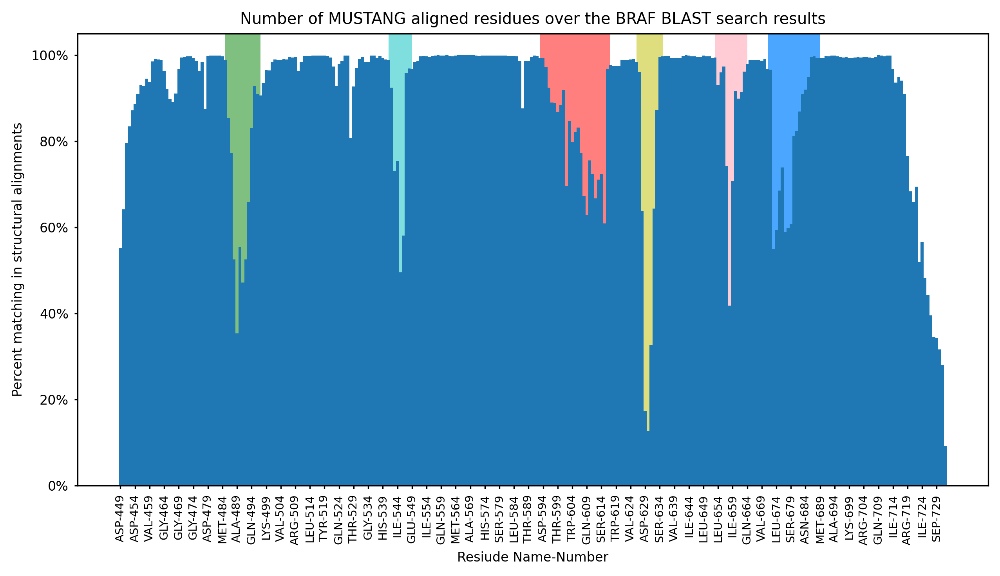

In [6]:
"""
Plotting the number of aligned residues over the BRAF BLAST search results to show what are the most conserved residues throughout the alignment
"""
from matplotlib.ticker import FuncFormatter
print(aligned)
seq1mag = len(aligned[0].seq1.replace("-",""))
counts = np.zeros(seq1mag)
for a in aligned:
    segment = make_seg(a)
    for i,(b,c) in enumerate(segment):
        if c != "-":
            counts[i] += 1
counts =  counts / max(counts)
# sns.set_theme(style="whitegrid")
fig,ax = plt.subplots(1,figsize=(10,5))
x = [*range(len(counts))]
ax.set_xticks(x[::5])
x_lbl = braf_res()
ax.set_xticklabels(x_lbl[::5],rotation=90,fontsize=7)
# subtract 11
ax.axvspan(36,48, facecolor='g', alpha=0.5)
ax.axvspan(92,100, facecolor='c', alpha=0.5)
ax.axvspan(144,168, facecolor='r', alpha=0.5)
ax.axvspan(177,186, facecolor='y', alpha=0.5)
ax.axvspan(204,215, facecolor='pink', alpha=0.8)
ax.axvspan(222,240, facecolor='dodgerblue', alpha=0.8)
ax.bar(x,counts,linewidth=0.05,width=1)
ax.yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y))) 
title = ax.set_title("Number of MUSTANG aligned residues over the BRAF BLAST search results")
ax1 = plt.xlabel("Resiude Name-Number")
ax1 = plt.ylabel("Percent matching in structural alignments")
ax.tick_params(length=2,color="black",direction="out")

In [7]:
"""
This cell finds PDBs with DFG and APE motifs aligned.
"""
from collections import Counter
import csv

# Initialize counters and lists
count = 0
new_aligned = []
bad = []

# First filtering loop
for k, a in enumerate(aligned):
    if a.seq1.find("DFG") == -1 or a.seq1.find("APE") == -1:
        bad.append(a)
        count += 1
    else:
        new_aligned.append(a)

print(count, "/", len(aligned), " don't match.")
print(f"Continuing with {len(new_aligned)} structures")

# Second filtering and analysis loop
counts = {}
counter = 0
new_aligned2 = []
aligning_segs = {}
lengths = []

for a in new_aligned:
    DFG_index = a.seq1.find("DFG")
    APE_index = a.seq1.find("APE")
    dfg = a.seq2[DFG_index]
    ape = a.seq2[APE_index]
    
    if dfg != "-" and ape != "-":
        counter += 1
        length = APE_index - DFG_index
        counts.setdefault(length, []).append((a.name, DFG_index, APE_index))
        new_aligned2.append(a)
        aligning_segs.setdefault(a.name,
                                 (a.seq2[DFG_index:DFG_index+3],
                                  a.seq2[APE_index:APE_index+3],
                                  a.seq2[DFG_index:APE_index+3]))
        lengths.append(len(a.seq2[DFG_index:APE_index+3]))

print(f"{counter} structures with an alignment to the D and A")

# Write to CSV
with open('alignment_results.csv', mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['Name', 'Seq1 Segment', 'Seq2 Segment', 'Status'])

    # Write new_aligned2
    for a in new_aligned2:
        DFG_index = a.seq1.find("DFG")
        APE_index = a.seq1.find("APE")
        seq1_segment = a.seq1[DFG_index:APE_index+3]
        seq2_segment = a.seq2[DFG_index:APE_index+3]
        writer.writerow([a.name, seq1_segment, seq2_segment, 'Aligned'])

    # Write bad
    for a in bad:
        writer.writerow([a.name, '', '', 'Not Aligned'])

171 / 3845  don't match.
Continuing with 3674 structures
3608 structures with an alignment to the D and A


Code for aligning the ends of the activation loop

In [ ]:
import pymol
from pymol import cmd
from glob import glob
import os
from Bio.PDB import PDBParser, PPBuilder

# Paths
pdb_dir = "Results/activation_segments/mustangs/"
reference_pdb = "6UAN_chainD.pdb"
output_dir = "Results/activation_segments/mustangs_realigned/"
image_output_path = "Results/aligned_loops.png"

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)

# Load the reference structure
cmd.load(reference_pdb, "6UAN_chainD")

# Create selections for the reference structure
cmd.select("6UAN_chainD_dfg_selection", "6UAN_chainD and resi 594-596 and name CA")
cmd.select("6UAN_chainD_ape_selection", "6UAN_chainD and resi 621-623 and name CA")
cmd.select("6UAN_chainD_ends_selection", "6UAN_chainD and (resi 594-596 or resi 621-623) and name CA")

def extract_atom_sequence(pdb_file):
    """Extract sequence from atomic coordinates for the first chain found in the PDB file."""
    parser = PDBParser(QUIET=True)
    structure = parser.get_structure('PDB', pdb_file)
    sequence_id = []
    for model in structure:
        for chain in model:
            ppb = PPBuilder()
            sequence = ''
            for pp in ppb.build_peptides(chain):
                sequence += pp.get_sequence()
                for residue in pp:
                    sequence_id.append(residue.get_id()[1])
            # print(sequence_id)
            # print(sequence)
            return str(sequence), sequence_id
    return None

def find_motif_indices(seq, seq_id, motif):
    index = seq.find(motif)
    if index == -1:
        return None
    ind = seq_id[index-1]
    return ind, ind + len(motif)

def print_residues_in_selection(selection_name):
    model = cmd.get_model(selection_name)
    residues = set((atom.resi, atom.resn) for atom in model.atom)
    print(f"Residues in {selection_name}: {sorted(residues)}")

def process_structure(pdb_file, ref_name="6UAN_chainD"):
    pdb_code = os.path.basename(pdb_file).split('.')[0]
    cmd.load(pdb_file, pdb_code)

    # Extract sequence from atomic coordinates
    seq, seq_id = extract_atom_sequence(pdb_file)
    if seq is None:
        print(f"Skipping {pdb_code} due to inability to extract sequence.")
        return
    print(f"Sequence for {pdb_code}: {seq}")

    # Find indices for DFG and APE
    dfg_indices = find_motif_indices(seq, seq_id, "DFG")
    ape_indices = find_motif_indices(seq, seq_id, "APE")

    print("DFG CHECK",dfg_indices)
    print("APE CHECK",ape_indices)

    if not dfg_indices or not ape_indices:
        print(f"Skipping {pdb_code} due to missing motifs.")
        return

    # Create selections using sequence indices
    dfg_residues = list(range(dfg_indices[0] + 1, dfg_indices[1] + 1))
    ape_residues = list(range(ape_indices[0] + 1, ape_indices[1] + 1))

    # Create selections
    cmd.select(f"{pdb_code}_dfg_selection", f"{pdb_code} and resi {dfg_residues[0]}-{dfg_residues[-1]} and name CA")
    cmd.select(f"{pdb_code}_ape_selection", f"{pdb_code} and resi {ape_residues[0]}-{ape_residues[-1]} and name CA")
    cmd.select(f"{pdb_code}_ends_selection", f"{pdb_code} and (resi {dfg_residues[0]}-{dfg_residues[-1]} or resi {ape_residues[0]}-{ape_residues[-1]}) and name CA")

    # Print residues in selections
    print_residues_in_selection(f"{pdb_code}_dfg_selection")
    print_residues_in_selection(f"{pdb_code}_ape_selection")
    print_residues_in_selection(f"{pdb_code}_ends_selection")

    # RMSD before alignment
    rms_dfg_before = cmd.rms_cur(f"{pdb_code}_dfg_selection", f"{ref_name}_dfg_selection", matchmaker=-1)
    rms_ape_before = cmd.rms_cur(f"{pdb_code}_ape_selection", f"{ref_name}_ape_selection", matchmaker=-1)
    rms_ends_before = cmd.rms_cur(f"{pdb_code}_ends_selection", f"{ref_name}_ends_selection", matchmaker=-1)

    print(f"Before alignment RMSD for {pdb_code}: DFG={rms_dfg_before}, APE={rms_ape_before}, ENDS={rms_ends_before}")

    # Aligning
    cmd.align(f"{pdb_code}_ends_selection", f"{ref_name}_ends_selection", cycles=0, transform=1)

    # Save aligned structure
    aligned_pdb_path = os.path.join(output_dir, f"{pdb_code}_aligned.pdb")
    cmd.save(aligned_pdb_path, pdb_code)
    print(f"Saved aligned structure to {aligned_pdb_path}")

    # RMSD after alignment
    rms_dfg_after = cmd.rms_cur(f"{pdb_code}_dfg_selection", f"{ref_name}_dfg_selection", matchmaker=-1)
    rms_ape_after = cmd.rms_cur(f"{pdb_code}_ape_selection", f"{ref_name}_ape_selection", matchmaker=-1)
    rms_ends_after = cmd.rms_cur(f"{pdb_code}_ends_selection", f"{ref_name}_ends_selection", matchmaker=-1)

    print(f"After alignment RMSD for {pdb_code}: DFG={rms_dfg_after}, APE={rms_ape_after}, ENDS={rms_ends_after}\n")

# Load all PDB files and process them
fps = glob(pdb_dir + "/*/*.pdb")
for fp in fps:
    print(fp)
    process_structure(fp)

# Visualize and color
cmd.select("all_loops", "byres 6UAN_chainD_ends_selection")
cmd.color("red", "6UAN_chainD and 6UAN_chainD_ends_selection")
cmd.color("white", "not 6UAN_chainD and all_loops")

# Set visualization style
cmd.show("cartoon")
cmd.hide("lines")

# Save the image
cmd.png(image_output_path, width=1200, height=800, dpi=300, ray=1)
print(f"Image saved to {image_output_path}")

cmd.quit()

Results/activation_segments/mustangs\1A9U_A\1A9U_A.pdb
Sequence for 1A9U_A: ERPTFYRQELNKTIWEVPERYQNLSPVGSGAYGSVCAAFDTKTGLRVAVKKLSRPFQSIIHAKRTYRELRLLKHMKHENVIGLLDVFTPARSLEEFNDVYLVTHLMGADLNNIVKCQKLTDDHVQFLIYQILRGLKYIHSADIIHRDLKPSNLAVNEDCELKILDFGLARHTDDEMTGYVATRWYRAPEIMLNWMHYNQTVDIWSVGCIMAELLTGRTLFPGTDHIDQLKLILRLVGTPGAELLKKISSESARNYIQSLTQMPKMNFANVFIGANPLAVDLLEKMLVLDSDKRITAAQALAHAYFAQYHDPDDEPVADPYDQSFESRDLLIDEWKSLTYDEVISFVPPPLD
DFG CHECK (167, 170)
APE CHECK (189, 192)
Residues in 1A9U_A_dfg_selection: [('168', 'ASP'), ('169', 'PHE'), ('170', 'GLY')]
Residues in 1A9U_A_ape_selection: [('190', 'ALA'), ('191', 'PRO'), ('192', 'GLU')]
Residues in 1A9U_A_ends_selection: [('168', 'ASP'), ('169', 'PHE'), ('170', 'GLY'), ('190', 'ALA'), ('191', 'PRO'), ('192', 'GLU')]
Before alignment RMSD for 1A9U_A: DFG=3.9300243854522705, APE=2.793308734893799, ENDS=3.409374237060547
Saved aligned structure to Results/activation_segments/mustangs_realigned/1A9U_A_aligned.pdb
After alignment RMSD for 1A9U_A: DF

In [3]:
import os
from glob import glob
from pymol import cmd
from Bio.PDB import PDBParser, PPBuilder

# Paths
pdb_dir = "Results/activation_segments/mustangs/"
reference_pdb = "6UAN_chainD.pdb"
output_dir = "Results/activation_segments/mustangs_realigned/"
image_output_path = "Results/aligned_loops.png"

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)

# Load the reference structure and set up its selections
cmd.load(reference_pdb, "6UAN_chainD")
cmd.select("6UAN_chainD_dfg_selection", "6UAN_chainD and resi 594-596 and name CA")
cmd.select("6UAN_chainD_ape_selection", "6UAN_chainD and resi 621-623 and name CA")
cmd.select("6UAN_chainD_ends_selection", "6UAN_chainD and (resi 594-596 or resi 621-623) and name CA")


def extract_atom_sequence(pdb_file):
    """
    Extracts the amino acid sequences of all chains from a PDB file and returns the sequence 
    and corresponding residue numbers of the first chain.
    This implementation parses all models and chains in one go to avoid repeatedly creating PPBuilder objects for each chain.
    Returns:
        (sequence, sequence_ids)
    """
    parser = PDBParser(QUIET=True)
    structure = parser.get_structure('PDB', pdb_file)
    ppb = PPBuilder()  # Create a global PPBuilder object
    sequence = ""
    sequence_ids = []
    # Iterate over all chains in the first model (only the first chain is used)
    for model in structure:
        for chain in model:
            for pp in ppb.build_peptides(chain):
                sequence_fragment = str(pp.get_sequence())
                sequence += sequence_fragment
                # For each residue in the peptide fragment, record its actual PDB residue number
                for residue in pp:
                    sequence_ids.append(residue.get_id()[1])
            return sequence, sequence_ids
    return None, None


def find_motif_indices(seq, seq_ids, motif):
    """
    Finds the specified motif in the given sequence and returns the corresponding PDB residue number range 
    using the residue number list.
    Note: It is assumed that the order in seq_ids corresponds to the character order in seq.
    """
    index = seq.find(motif)
    if index == -1:
        return None
    # Directly use the matched position in the residue number list to get the corresponding PDB residue number
    start_pdb_num = seq_ids[index]
    end_pdb_num = start_pdb_num + len(motif) - 1
    return start_pdb_num, end_pdb_num


def print_residues_in_selection(selection_name):
    model = cmd.get_model(selection_name)
    residues = sorted(set((atom.resi, atom.resn) for atom in model.atom))
    print(f"Residues in {selection_name}: {residues}")


def process_structure(pdb_file, ref_name="6UAN_chainD"):
    pdb_code = os.path.basename(pdb_file).split('.')[0]
    cmd.load(pdb_file, pdb_code)

    # Parse and extract the sequence and residue numbers (to avoid redundant parsing)
    seq, seq_ids = extract_atom_sequence(pdb_file)
    if not seq:
        print(f"Skipping {pdb_code} due to inability to extract sequence.")
        return
    print(f"Sequence for {pdb_code}: {seq}")

    # Find the PDB residue number ranges corresponding to the DFG and APE motifs based on the sequence
    dfg_range = find_motif_indices(seq, seq_ids, "DFG")
    ape_range = find_motif_indices(seq, seq_ids, "APE")
    print("DFG CHECK", dfg_range)
    print("APE CHECK", ape_range)
    if not dfg_range or not ape_range:
        print(f"Skipping {pdb_code} due to missing motifs.")
        return

    # Construct selection strings; note that here we use the range directly without adding 1
    cmd.select(f"{pdb_code}_dfg_selection", f"{pdb_code} and resi {dfg_range[0]}-{dfg_range[1]} and name CA")
    cmd.select(f"{pdb_code}_ape_selection", f"{pdb_code} and resi {ape_range[0]}-{ape_range[1]} and name CA")
    cmd.select(f"{pdb_code}_ends_selection", f"{pdb_code} and (resi {dfg_range[0]}-{dfg_range[1]} or resi {ape_range[0]}-{ape_range[1]}) and name CA")

    # Print the information of the selected residues
    print_residues_in_selection(f"{pdb_code}_dfg_selection")
    print_residues_in_selection(f"{pdb_code}_ape_selection")
    print_residues_in_selection(f"{pdb_code}_ends_selection")

    # Calculate the RMSD before alignment
    rms_dfg_before = cmd.rms_cur(f"{pdb_code}_dfg_selection", f"{ref_name}_dfg_selection", matchmaker=-1)
    rms_ape_before = cmd.rms_cur(f"{pdb_code}_ape_selection", f"{ref_name}_ape_selection", matchmaker=-1)
    rms_ends_before = cmd.rms_cur(f"{pdb_code}_ends_selection", f"{ref_name}_ends_selection", matchmaker=-1)
    print(f"Before alignment RMSD for {pdb_code}: DFG={rms_dfg_before}, APE={rms_ape_before}, ENDS={rms_ends_before}")

    # Align the structure
    cmd.align(f"{pdb_code}_ends_selection", f"{ref_name}_ends_selection", cycles=0, transform=1)

    # Save the aligned structure
    aligned_pdb_path = os.path.join(output_dir, f"{pdb_code}_aligned.pdb")
    cmd.save(aligned_pdb_path, pdb_code)
    print(f"Saved aligned structure to {aligned_pdb_path}")

    # Calculate the RMSD after alignment
    rms_dfg_after = cmd.rms_cur(f"{pdb_code}_dfg_selection", f"{ref_name}_dfg_selection", matchmaker=-1)
    rms_ape_after = cmd.rms_cur(f"{pdb_code}_ape_selection", f"{ref_name}_ape_selection", matchmaker=-1)
    rms_ends_after = cmd.rms_cur(f"{pdb_code}_ends_selection", f"{ref_name}_ends_selection", matchmaker=-1)
    print(f"After alignment RMSD for {pdb_code}: DFG={rms_dfg_after}, APE={rms_ape_after}, ENDS={rms_ends_after}\n")

In [ ]:
# Iterate over all PDB files and process them
# (Optionally, multithreading/multiprocessing can be used for large datasets,
# but be aware of PyMOL command thread safety.)
fps = glob(os.path.join(pdb_dir, "*", "*.pdb"))
for fp in fps:
    print(fp)
    process_structure(fp)

In [3]:
cmd.quit()

: 

In [1]:
# Visualization and coloring
import glob
from pymol import cmd

aligned_files = glob.glob("Results/activation_segments/mustangs_realigned/*.pdb")

PDB_6UAN_chainD = glob.glob("6UAN_chainD.pdb")
cmd.load(PDB_6UAN_chainD[0], "6UAN_chainD")
cmd.select("6UAN_chainD_dfg_selection", "6UAN_chainD and resi 594-596 and name CA")
cmd.select("6UAN_chainD_ape_selection", "6UAN_chainD and resi 621-623 and name CA")
cmd.select("6UAN_chainD_ends_selection", "6UAN_chainD and (resi 594-596 or resi 621-623) and name CA")
print(f"Loaded {PDB_6UAN_chainD[0]} as 6UAN_chainD")

for pdb_file in aligned_files[0:1]:
    pdb_name = pdb_file.split("/")[-1].split(".")[0]
    cmd.load(pdb_file, pdb_name)
    print(f"Loaded {pdb_file} as {pdb_name}")

cmd.select("all_loops", "byres 6UAN_chainD_ends_selection")
cmd.color("red", "6UAN_chainD and 6UAN_chainD_ends_selection")
cmd.color("white", "not 6UAN_chainD and all_loops")
cmd.show("cartoon")
cmd.hide("lines")

# Save image
image_output_path = "Results/aligned_loops2.png"
cmd.png(image_output_path, width=1200, height=800, dpi=300, ray=1)
print(f"Image saved to {image_output_path}")

Loaded 6UAN_chainD.pdb as 6UAN_chainD
Loaded Results/activation_segments/mustangs_realigned\1A9U_A_aligned.pdb as mustangs_realigned\1A9U_A_aligned
Image saved to Results/aligned_loops2.png


In [2]:
cmd.quit()

: 

Code for secondary structure alignment

In [2]:
import os
import shutil
from glob import glob

import mdtraj as md
from pymol import cmd
from collections import defaultdict, Counter

###############################################################################
# PART A: Utility functions
###############################################################################
def find_dfg_motif_index(residues):
    """
    Find the mdtraj residue index of 'ASP' in the DFG motif (ASP,PHE,GLY).
    Returns None if not found.
    """
    for i in range(len(residues) - 2):
        if (residues[i].name.startswith('ASP') and
            residues[i+1].name.startswith('PHE') and
            residues[i+2].name.startswith('GLY')):
            return i
    return None

def find_ape_motif_index(residues):
    """
    Find the mdtraj residue index of 'GLU' in the APE motif (ALA,PRO,GLU).
    Returns None if not found.
    """
    for i in range(len(residues) - 2):
        if (residues[i].name.startswith('ALA') and
            residues[i+1].name.startswith('PRO') and
            residues[i+2].name.startswith('GLU')):
            return i + 2
    return None

def make_resi_selection(object_name, residue_indices):
    """
    Convert a list of PDB residue numbers (not zero-based mdtraj indices)
    to a PyMOL selection of CA atoms:
    e.g. "object_name and name CA and (resi 10 or resi 11 or ...)".
    """
    if not residue_indices:
        return f"{object_name} and name CA"
    parts = [f"resi {resi_num}" for resi_num in residue_indices]
    joined = " or ".join(parts)
    return f"{object_name} and name CA and ({joined})"


###############################################################################
# PART B: Calculate secondary structure conservation with offset logic
###############################################################################
def calculate_secondary_structure_conservation(
    directory,
    reference_pdb,
    max_structures=800
):
    """
    1) Load reference, locate D/E => dRef, eRef. 
       Define slices: [dRef-46..dRef], [eRef..eRef+9].
    2) For each structure's D/E => dStruct, eStruct => offsets. 
       Gather DSSP for that same region in the target.
    3) Determine "conserved residues" by global frequency > 0.97, not coil, 
       matching reference assignment.
    4) Return a dict => { "pdbfile": { 
         "ref_indices": [...], "targ_indices": [...],
         "conserved_info": [ (refIdx, refName, structIdx, structName), ... ] 
       } }
    5) Also copy those PDBs into "Results/activation_segments/mustangs_conserved_secondary".
    6) Print the per-residue index & name for both reference and each structure 
       that passes the final test.
    """
    print("[INFO] Loading reference structure...")
    ref_traj = md.load(reference_pdb)
    ref_residues = list(ref_traj.topology.residues)
    ref_dssp = md.compute_dssp(ref_traj)[0]
    
    # DEBUG
    print(f"[DEBUG] Reference has {len(ref_residues)} residues.")
    
    # Find D/E in the reference
    dRef = find_dfg_motif_index(ref_residues)
    eRef = find_ape_motif_index(ref_residues)
    print(f"[DEBUG] Found DFG motif at ref residue index = {dRef}")
    print(f"[DEBUG] Found APE motif at ref residue index = {eRef}")
    
    if dRef is None or eRef is None:
        print("[WARNING] Reference doesn't have DFG or APE motif. Aborting.")
        return {}

    if dRef < 46 or (eRef + 9) >= len(ref_residues):
        print("[WARNING] Reference is too short for D-46..D, E..E+9 slices. Aborting.")
        return {}

    # Reference slices
    ref_d_slice = ref_residues[dRef - 46 : dRef + 1]  # e.g. 46 residues plus D
    ref_e_slice = ref_residues[eRef : eRef + 10]      # E..E+9
    all_ref_slice = ref_d_slice + ref_e_slice
    
    # DEBUG
    print("[DEBUG] Reference D-slice (indices):", [r.index for r in ref_d_slice])
    print("[DEBUG] Reference E-slice (indices):", [r.index for r in ref_e_slice])

    # Store reference assignment & names. Also store PDB numbering for each residue.
    reference_assignments = {}
    reference_names = {}
    reference_resnums = {}
    for r in all_ref_slice:
        reference_assignments[r] = ref_dssp[r.index]
        reference_names[r] = r.name
        # This is the actual PDB residue number from the topology
        reference_resnums[r] = r.resSeq

    # DEBUG: Print out the reference secondary structure for that slice
    for r in all_ref_slice:
        print(f"[DEBUG] Ref Slice Residue: idx={r.index}, name={r.name}, SS={reference_assignments[r]}")

    structure_assignments = {}
    structure_resnames = {}
    motif_map = {}
    structure_resnums = {}  # (sid, referenceResidue) -> target's PDB numbering

    def enough_structures_so_far():
        # If we have enough structures for the first residue in ref_d_slice
        if not ref_d_slice:
            return True
        first_r = ref_d_slice[0]
        used_ids = {sid for (sid, rr) in structure_assignments if rr == first_r}
        return len(used_ids) >= max_structures

    # Collect from directory
    subdirs = [d for d in os.listdir(directory) if os.path.isdir(os.path.join(directory, d))]
    print(f"[DEBUG] Found {len(subdirs)} subdirectories in {directory}")

    for subdir in subdirs:
        if enough_structures_so_far():
            break
        sub_path = os.path.join(directory, subdir)
        pdb_files = [f for f in os.listdir(sub_path) if f.endswith(".pdb")]
        
        # DEBUG
        print(f"[DEBUG] Checking subdirectory: {subdir}, found {len(pdb_files)} pdb files")

        for pdb_file in pdb_files:
            if enough_structures_so_far():
                break

            full_path = os.path.join(sub_path, pdb_file)
            traj = md.load(full_path)
            residues = list(traj.topology.residues)

            # DEBUG
            print(f"[DEBUG] Loading {pdb_file}: total residues={len(residues)}")

            dS = find_dfg_motif_index(residues)
            eS = find_ape_motif_index(residues)
            if dS is None or eS is None:
                print(f"[DEBUG] {pdb_file}: missing DFG or APE motif.")
                continue
            if dS < 46 or (eS + 9) >= len(residues):
                print(f"[DEBUG] {pdb_file}: cannot slice [D-46..D], [E..E+9], skipping.")
                continue

            dssp_vals = md.compute_dssp(traj)[0]
            struct_d_slice = residues[dS - 46 : dS + 1]
            struct_e_slice = residues[eS : eS + 10]

            # DEBUG
            print(f"[DEBUG] {pdb_file}: D-slice indices={[r.index for r in struct_d_slice]}")
            print(f"[DEBUG] {pdb_file}: E-slice indices={[r.index for r in struct_e_slice]}")

            sid = f"{subdir}/{pdb_file}"
            motif_map[sid] = (dS, eS)

            # Build mapping from the reference's D/E slice to the target's
            for i, rRef in enumerate(ref_d_slice):
                sRes = struct_d_slice[i]
                structure_assignments[(sid, rRef)] = dssp_vals[sRes.index]
                structure_resnames[(sid, rRef)] = (sRes.name, sRes.index)
                # Store the PDB residue number for actual PyMOL selection
                structure_resnums[(sid, rRef)] = sRes.resSeq

            for i, rRef in enumerate(ref_e_slice):
                sRes = struct_e_slice[i]
                structure_assignments[(sid, rRef)] = dssp_vals[sRes.index]
                structure_resnames[(sid, rRef)] = (sRes.name, sRes.index)
                # Store the PDB residue number
                structure_resnums[(sid, rRef)] = sRes.resSeq

    # Analyze global frequency
    residue_to_assigns = defaultdict(list)
    for (sid, rRef), dchar in structure_assignments.items():
        if rRef in all_ref_slice:
            residue_to_assigns[rRef].append(dchar)

    print("[DEBUG] Counting assignments per reference residue across all structures...")

    def analyze_conservation(data):
        out = {}
        for r, assigns in data.items():
            if not assigns:
                out[r] = {"most_common": "-", "frequency": 0.0}
            else:
                c = Counter(assigns)
                mc, cnt = c.most_common(1)[0]
                freq = cnt / len(assigns)
                out[r] = {"most_common": mc, "frequency": freq}
        return out

    conservation = analyze_conservation(residue_to_assigns)

    # Decide which residues are "conserved"
    conserved_residues = []
    for rRef in all_ref_slice:
        if rRef not in conservation:
            continue
        mc = conservation[rRef]["most_common"]
        freq = conservation[rRef]["frequency"]
        print(f"[DEBUG] Residue rRef.idx={rRef.index}, refSS={reference_assignments[rRef]}, most_common={mc}, freq={freq:.3f}")

        if freq > 0.97 and mc != 'C' and mc == reference_assignments[rRef]:
            conserved_residues.append(rRef)
    conserved_residues.sort(key=lambda x: x.index)

    print("\n[INFO] Conserved residues in the reference:")
    for rRef in conserved_residues:
        mc = conservation[rRef]["most_common"]
        freq = conservation[rRef]["frequency"]
        print(f"  RefIndex={rRef.index}, Name={rRef.name}, freq={freq:.3f}, SS={mc}")

    target_dir = "Results/activation_segments/mustangs_conserved_secondary"
    os.makedirs(target_dir, exist_ok=True)

    all_struct_ids = {s for (s, rr) in structure_assignments}
    selected_structures_dict = {}

    dRef_start = dRef - 46
    dRef_end   = dRef
    eRef_start = eRef
    eRef_end   = eRef + 9
    
    print(f"[DEBUG] Reference slices: D-slice=({dRef_start}..{dRef_end}), E-slice=({eRef_start}..{eRef_end})")

    # Check each structure for "pass"
    for sid in all_struct_ids:
        pass_all = True
        for rRef in conserved_residues:
            if (sid, rRef) not in structure_assignments:
                pass_all = False
                break
            if structure_assignments[(sid, rRef)] != reference_assignments[rRef]:
                pass_all = False
                break
        
        if not pass_all:
            continue

        subd, pdbfile = sid.split('/', 1)
        dS, eS = motif_map[sid]
        offsetD = dS - dRef
        offsetE = eS - eRef
        
        print(f"[DEBUG] PASSING structure: {sid}; dS={dS}, eS={eS}, offsetD={offsetD}, offsetE={offsetE}")

        ref_list  = []
        targ_list = []
        info_list = []

        for rRef in conserved_residues:
            iRef = rRef.index
            rRefName = rRef.name

            # Original offset logic to see which slice it's in
            if dRef_start <= iRef <= dRef_end:
                iTarg = iRef + offsetD
            elif eRef_start <= iRef <= eRef_end:
                iTarg = iRef + offsetE
            else:
                continue

            # Instead of the zero-based indices, we put the actual PDB numbering:
            pdbRefNum = reference_resnums[rRef]
            if (sid, rRef) in structure_resnums:
                pdbTargNum = structure_resnums[(sid, rRef)]
            else:
                pdbTargNum = iTarg  # fallback (unlikely)

            # For PyMOL alignment, we want the real PDB numbers
            ref_list.append(pdbRefNum)
            targ_list.append(pdbTargNum)

            # Keep the same print statement data
            if (sid, rRef) in structure_resnames:
                (targetName, targetIdx) = structure_resnames[(sid, rRef)]
            else:
                targetName = "???"
                targetIdx = iTarg

            # info_list is the data in your final print statement
            info_list.append((iRef, rRefName, targetIdx, targetName))

        selected_structures_dict[pdbfile] = {
            "ref_indices": ref_list,
            "targ_indices": targ_list,
            "conserved_info": info_list
        }

        src_path = os.path.join(directory, subd, pdbfile)
        dst_path = os.path.join(target_dir, pdbfile)
        if os.path.isfile(src_path):
            shutil.copy2(src_path, dst_path)

    print("\n[INFO] Final conserved structures & residues (reference -> target):")
    for pdbfile, val in selected_structures_dict.items():
        print(f"  Structure: {pdbfile}")
        for (iRef, nmRef, iTarg, nmTarg) in val["conserved_info"]:
            print(f"    RefIdx={iRef}({nmRef}) => TargIdx={iTarg}({nmTarg})")

    return selected_structures_dict


###############################################################################
# PART C: Realign structures in PyMOL using the offset-based indices
###############################################################################
def realign_conserved_structures(
    selected_structures_dict,
    reference_pdb,
    source_dir="Results/activation_segments/mustangs_conserved_secondary",
    output_dir="Results/activation_segments/mustangs_realigned_secondary",
    reference_object_name="reference"
):
    """
    For each structure in 'selected_structures_dict':
      - We have a list of 'ref_indices' for the reference 
        and 'targ_indices' for the target. 
      - Load them in PyMOL, build two selections, do alignment, save.
    Also prints the before/after RMS.
    """

    os.makedirs(output_dir, exist_ok=True)
    
    # DEBUG
    print(f"[DEBUG] Realign: reference={reference_pdb}, source={source_dir}, output={output_dir}")

    # Load reference
    cmd.load(reference_pdb, reference_object_name)
    print("Num atoms in ref sel:", cmd.count_atoms(f"{reference_object_name} and name CA"))
    cmd.select("checkIndex", f"{reference_object_name} and resi 500 and name CA")
    print("Check residue 500:", cmd.count_atoms("checkIndex"))

    cmd.hide("everything", reference_object_name)
    cmd.show("cartoon", reference_object_name)
    cmd.color("cyan", reference_object_name)

    all_pdbs = glob(os.path.join(source_dir, "*.pdb"))
    print(f"[INFO] Found {len(all_pdbs)} .pdb in {source_dir}")

    def process_structure(pdb_path, ref_list, targ_list):
        pdb_file = os.path.basename(pdb_path)
        obj_name = os.path.splitext(pdb_file)[0]
        cmd.load(pdb_path, obj_name)

        # Now ref_list/targ_list are PDB residue numbers. 
        sel_ref  = make_resi_selection(reference_object_name, ref_list)
        sel_targ = make_resi_selection(obj_name, targ_list)

        # DEBUG
        print(f"[DEBUG] process_structure => {pdb_file}")
        print(f"[DEBUG] - ref_list={ref_list}")
        print(f"[DEBUG] - targ_list={targ_list}")
        print(f"[DEBUG] - sel_ref={sel_ref}")
        print(f"[DEBUG] - sel_targ={sel_targ}")

        n_ref  = cmd.count_atoms(sel_ref)
        n_targ = cmd.count_atoms(sel_targ)
        if n_ref != n_targ or n_ref == 0:
            print(f"  [WARNING] {pdb_file}: mismatch in selection sizes ({n_ref} vs {n_targ}). Skipping.")
            cmd.delete(obj_name)
            return

        rms_before = cmd.rms_cur(sel_targ, sel_ref, matchmaker=-1)
        print(f"  RMS before alignment for {pdb_file}: {rms_before:.3f} Å")

        cmd.super(sel_targ, sel_ref)

        rms_after = cmd.rms_cur(sel_targ, sel_ref, matchmaker=-1)
        print(f"  RMS after alignment for {pdb_file}: {rms_after:.3f} Å")

        out_pdb = os.path.join(output_dir, pdb_file)
        cmd.save(out_pdb, obj_name)
        print(f"  [INFO] Saved aligned => {out_pdb}")

        cmd.delete(obj_name)

    for pdb_path in all_pdbs:
        pdb_file = os.path.basename(pdb_path)
        if pdb_file in selected_structures_dict:
            ref_list  = selected_structures_dict[pdb_file]["ref_indices"]
            targ_list = selected_structures_dict[pdb_file]["targ_indices"]
            print(f"\n[INFO] Aligning {pdb_file} with {len(ref_list)} 'conserved' residues.")
            process_structure(pdb_path, ref_list, targ_list)
        else:
            print(f"[INFO] Skipping {pdb_file} (not in dictionary).")

    out_img = os.path.join(output_dir, "aligned_loops_offset.png")
    cmd.png(out_img, width=1200, height=800, dpi=300, ray=1)
    print(f"\n[INFO] Saved alignment image => {out_img}")

    # If you prefer to quit PyMOL automatically, uncomment the next line:
    # cmd.quit()


###############################################################################
# PART D: Example usage
###############################################################################
if __name__ == "__main__":

    # 1) Identify "conserved" residues across all structures
    #    and produce offset-based indexes for each structure.
    selected_structs = calculate_secondary_structure_conservation(
        directory="Results/activation_segments/mustangs",
        reference_pdb="6UAN_chainD.pdb",
        max_structures=4000
    )

    # 2) Realign those structures in PyMOL
    realign_conserved_structures(
        selected_structures_dict=selected_structs,
        reference_pdb="6UAN_chainD.pdb",
        source_dir="Results/activation_segments/mustangs_conserved_secondary",
        output_dir="Results/activation_segments/mustangs_realigned_secondary",
        reference_object_name="reference"
    )



[INFO] Loading reference structure...
[DEBUG] Reference has 285 residues.
[DEBUG] Found DFG motif at ref residue index = 145
[DEBUG] Found APE motif at ref residue index = 174
[DEBUG] Reference D-slice (indices): [99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145]
[DEBUG] Reference E-slice (indices): [174, 175, 176, 177, 178, 179, 180, 181, 182, 183]
[DEBUG] Ref Slice Residue: idx=99, name=PHE, SS=C
[DEBUG] Ref Slice Residue: idx=100, name=GLU, SS=C
[DEBUG] Ref Slice Residue: idx=101, name=MET, SS=C
[DEBUG] Ref Slice Residue: idx=102, name=ILE, SS=C
[DEBUG] Ref Slice Residue: idx=103, name=LYS, SS=C
[DEBUG] Ref Slice Residue: idx=104, name=LEU, SS=C
[DEBUG] Ref Slice Residue: idx=105, name=ILE, SS=H
[DEBUG] Ref Slice Residue: idx=106, name=ASP, SS=H
[DEBUG] Ref Slice Residue: idx=107, name=ILE, SS=H
[DEBUG

In [1]:
import biobox as bb
import glob
import numpy as np

################################################################################
# Code to save only the first and last CA atoms in activation segment PDB files 
# both before and after Mustang realignment, for quick verification.
################################################################################
# --- BEFORE ENDS REALIGNMENT ---
files_before = f"Results/activation_segments/mustangs/*/*.pdb"

start_before = []
end_before = []

for f in glob.glob(files_before):
    M = bb.Molecule(f)
    pts = M.atomselect("*", "*", "CA")
    start_before.append(pts[0])
    end_before.append(pts[-1])

M_start_before = bb.Structure(p=np.array(start_before))
M_end_before = bb.Structure(p=np.array(end_before))

M_start_before.write_pdb("start_CA_beforeReAlign.pdb")
M_end_before.write_pdb("end_CA_beforeReAlign.pdb")

# --- AFTER ENDS REALIGNMENT ---
files_after = f"Results/activation_segments/mustangs_realigned/*.pdb"
start_after = []
end_after = []

for f in glob.glob(files_after):
    M = bb.Molecule(f)
    pts = M.atomselect("*", "*", "CA")
    start_after.append(pts[0])
    end_after.append(pts[-1])

M_start_after = bb.Structure(p=np.array(start_after))
M_end_after = bb.Structure(p=np.array(end_after))

M_start_after.write_pdb("start_CA_afterReAlign.pdb")
M_end_after.write_pdb("end_CA_afterReAlign.pdb")

# --- AFTER SCONDARY STRUCTURE REALIGNMENT ---
files_after = f"Results/activation_segments/mustangs_conserved_secondary/*.pdb"
start_after = []
end_after = []

for f in glob.glob(files_after):
    M = bb.Molecule(f)
    pts = M.atomselect("*", "*", "CA")
    start_after.append(pts[0])
    end_after.append(pts[-1])

M_start_after = bb.Structure(p=np.array(start_after))
M_end_after = bb.Structure(p=np.array(end_after))

M_start_after.write_pdb("start_CA_afterReAlign_secondary.pdb")
M_end_after.write_pdb("end_CA_afterReAlign.pdb_secondary.pdb")


In [15]:
import mdtraj as md
import os
from glob import glob
from tqdm.notebook import tqdm

###############################################################################
# Function to load a PDB file and strip it down to CA atoms from a specified
# start_residue to an end_residue (indices are 0-based).
###############################################################################
def strip_to_ca(pdb_path, start_residue, end_residue):
    """
    Loads the PDB, extracts CA atoms for residues in the specified slice,
    and returns an mdtraj.Trajectory object with just those atoms.
    """
    pdb = md.load(pdb_path)
    print(f"Loaded PDB: {pdb_path}")

    # Extract CA atoms within the specified range of residues
    atom_indices = [
        atom.index 
        for res in pdb.top._residues[start_residue:end_residue] 
        for atom in res.atoms 
        if atom.name == "CA"
    ]
    print(f"Atom indices for CA: {atom_indices}")

    return pdb.atom_slice(atom_indices)

###############################################################################
# Function to process alignments by looking for the DFG and APE motifs in seq1,
# verifying alignment in seq2, and saving out the PDB stripped to CA atoms only.
###############################################################################
def process_alignments(pdb_dir, target_dir, alignments):
    """
    Parameters
    ----------
    pdb_dir : str
        Directory where the PDB files are stored (e.g., mustangs or mustangs_realigned).
    target_dir : str
        Directory where stripped PDBs will be saved.
    alignments : list
        A list of alignment objects, each with attributes like:
          - name
          - seq1 (aligned sequence 1)
          - seq2 (aligned sequence 2)
    """
    # Ensure the target directory exists
    os.makedirs(target_dir, exist_ok=True)
    print(f"\nProcessing:\n  PDB directory = {pdb_dir}\n  Target directory = {target_dir}")

    # Find all PDB files in pdb_dir
    pdb_files = glob(os.path.join(pdb_dir, "*.pdb"))
    print(f"Found PDB files: {pdb_files}")

    # Process each alignment in alignments
    for align_obj in tqdm(alignments, desc="Processing alignments"):
        print(f"\nChecking alignment: {align_obj.name}")
        match_found = False
        matching_fp = ""

        # Look for a matching PDB file
        for fp in pdb_files:
            if align_obj.name in fp and "pdb" in fp:
                match_found = True
                matching_fp = fp
                print(f"Match found for {align_obj.name} in file: {fp}")
                break
        
        if not match_found:
            print(f"No match found for {align_obj.name}, skipping.")
            continue

        # Indices of DFG and APE in seq1
        DFG_index = align_obj.seq1.find("DFG")
        APE_index = align_obj.seq1.find("APE")
        print(f"DFG index (in seq1): {DFG_index} | APE index (in seq1): {APE_index}")

        # Skip if DFG/APE motifs are not found
        if DFG_index == -1 or APE_index == -1:
            print(f"Skipping file {matching_fp} as it does not contain the DFG or APE motifs in seq1.")
            continue

        # Check if the same segment (DFG) is also aligned in seq2
        # (i.e., we want seq2 to also have the substring "DFG" in the same place):
        if align_obj.seq2[DFG_index:DFG_index + 3] != "DFG":
            print(f"Skipping file {matching_fp} as the DFG motif is not aligned properly in seq2.")
            continue

        # Adjust DFG and APE indices to account for gaps in seq2
        DFG_index_adjusted = DFG_index - sum([1 for a in align_obj.seq2[:DFG_index] if a == "-"])
        APE_index_adjusted = APE_index - sum([1 for a in align_obj.seq2[:APE_index] if a == "-"])
        print(f"Adjusted DFG index: {DFG_index_adjusted} | Adjusted APE index: {APE_index_adjusted}")

        # Strip to CA atoms between the adjusted DFG and APE (including the 3 residues of "APE")
        stripped = strip_to_ca(matching_fp, DFG_index_adjusted, APE_index_adjusted + 3)

        # Construct the file name and save the stripped pdb
        new_name = os.path.join(target_dir, os.path.basename(matching_fp))
        print(f"Saving stripped PDB to: {new_name}")
        stripped.save(new_name)
        
import pandas as pd
def get_alignments_from_df(path = "alignment_results.csv"):
    df = pd.read_csv(path)
    print(df)
    new_aligned2 = df.loc[df['Status']=="Aligned"].apply(
        lambda x: alignment(x['Name'],x['Seq1 Segment'],x['Seq2 Segment']),
        axis=1
    ).tolist()
    return new_aligned2



###############################################################################
# Example usage
###############################################################################
if __name__ == "__main__":

    
    new_aligned2 = get_alignments_from_df()

    # 1) Process for the ends realigned directory
    pdb_dir_realigned = "Results/activation_segments/mustangs_realigned/"
    target_dir_realigned = f"Results/activation_segments/CA_segments/mustangs_endsRealignment"
    process_alignments(pdb_dir_realigned, target_dir_realigned, new_aligned2)

    # 2) Process for the non-realigned Mustang directory
    pdb_dir_no_realign = "Results/activation_segments/mustangs/*/"
    target_dir_no_realign = "Results/activation_segments/CA_segments/mustangs_noRealignment"
    process_alignments(pdb_dir_no_realign, target_dir_no_realign, new_aligned2)

    # 3) Process for the secondary structure realigned directory
    pdb_dir_second_realign = "Results/activation_segments/mustangs_conserved_secondary/"
    target_dir_second_realign = "Results/activation_segments/CA_segments/mustangs_secondaryRealignment"
    process_alignments(pdb_dir_second_realign, target_dir_second_realign, new_aligned2)


               Name                          Seq1 Segment  \
0            1A9U_A       DFGLATVKSRWSGSHQFEQL-SGSILWMAPE   
1            1AD5_A        DFGLATVKSRWSGSHQFEQLSGSILWMAPE   
2            1AD5_B       DFGLATVKSRWSGSHQFEQ-LSGSILWMAPE   
3            1AGW_A  DFGLATVKSRWSGSHQFEQLS------GSILWMAPE   
4     1APM_E_filled        DFGLATVKSRWSGSHQFEQLSGSILWMAPE   
...             ...                                   ...   
3774  8UDT_B_filled                                   NaN   
3775  8UDT_C_filled                                   NaN   
3776  8UVY_A_filled                                   NaN   
3777  8UW2_A_filled                                   NaN   
3778  8UW9_A_filled                                   NaN   

                              Seq2 Segment       Status  
0          DFG------LARHTDDEMTGYVATRWYRAPE      Aligned  
1           DFGLARVG----------AK-FPIKWTAPE      Aligned  
2          DFGLARVG-----------AK-FPIKWTAPE      Aligned  
3     DF-GLAR-DIHH----IDYYKKTTNGRLP

Processing alignments:   0%|          | 0/3608 [00:00<?, ?it/s]


Checking alignment: 1A9U_A
Match found for 1A9U_A in file: Results/activation_segments/mustangs_realigned\1A9U_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 28
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\1A9U_A_aligned.pdb
Atom indices for CA: [1, 10, 21, 28, 35, 46, 58, 69, 78, 87, 95, 103, 112, 119, 127, 141, 150, 157, 164, 173, 184, 196, 205, 213, 221]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\1A9U_A_aligned.pdb

Checking alignment: 1AD5_A
Match found for 1AD5_A in file: Results/activation_segments/mustangs_realigned\1AD5_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 16
Loaded PDB: Results/activation_segments/mustangs_realigned\1AD5_A_aligned.pdb
Atom indices for CA: [1, 9, 15, 24, 33, 41, 49, 55, 64, 78, 87, 101, 111, 117, 126, 139, 152, 162, 171]
Saving stripped PDB to: Results/activation_segments/C

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM      9  N   VAL A   1      80.177 118.858 126.311  1.00  0.00           N  , ATOM      8  CE  MET A   1      85.351 113.922 125.446  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     25  N   LEU A   2      79.860 117.084 128.228  1.00  0.00           N  , ATOM     24  OE2 GLU A   2      77.048 116.718 119.898  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     41  N   PRO A   3      81.417 119.032 130.092  1.00  0.00           N  , ATOM     40  OD1 ASN A   3      83.894 121.516 120.300  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\1WBO_A_aligned.pdb
Atom indices for CA: [1, 10, 21, 28, 35, 46, 58, 69, 78, 87, 95, 103, 112, 119, 127, 141, 150, 157, 164, 173, 184, 196, 205, 213, 221]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\1WBO_A_aligned.pdb

Checking alignment: 1WBS_A
Match found for 1WBS_A in file: Results/activation_segments/mustangs_realigned\1WBS_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\1WBS_A_aligned.pdb
Atom indices for CA: [1, 10, 21, 28, 35, 46, 58, 69, 78, 87, 95, 103, 112, 119, 127, 141, 150, 157, 164, 173, 184, 196, 205, 213, 221]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\1WBS_A_aligned.pdb

Checking alignment: 1WBW_A
Match found for 1WBW_A in file: Results/activation_segments/mustangs_realigned\1WBW_A_aligned.pdb
DFG index 

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM      9  N   MET A   1      90.291 133.266 138.584  1.00  0.00           N  , ATOM      8  CD2 LEU A   1      97.456 133.133 141.034  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     25  N   SER A   2      88.126 131.878 137.919  1.00  0.00           N  , ATOM     24  CE  MET A   2      94.615 139.432 135.662  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     40  N   HIS A   3     101.777 137.599 139.996  1.00  0.00           N  , ATOM     39  OE1 GLN A   3      89.500 124.841 135.859  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\1YRP_A_aligned.pdb
Atom indices for CA: [1, 7, 14, 25, 36, 45, 54, 62, 69, 78, 86, 96, 108, 117, 125, 129, 138, 147, 155, 159, 165, 169, 178, 189, 194, 202, 209]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\1YRP_A_aligned.pdb

Checking alignment: 1YRP_B
Match found for 1YRP_B in file: Results/activation_segments/mustangs_realigned\1YRP_B_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 24
Loaded PDB: Results/activation_segments/mustangs_realigned\1YRP_B_aligned.pdb
Atom indices for CA: [1, 7, 14, 25, 36, 45, 54, 62, 69, 78, 86, 96, 108, 117, 125, 129, 138, 147, 155, 159, 165, 169, 178, 189, 194, 202, 209]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\1YRP_B_aligned.pdb

Checking alignment: 1YVJ_A_filled
Match found for 1YVJ_A_filled in file: Results/activation_segments/mustangs_realigned

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM      9  N   VAL A   1      80.079 118.988 125.975  1.00  0.00           N  , ATOM      8  CE  MET A   1      85.563 113.645 125.024  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     25  N   LEU A   2      79.894 117.108 127.835  1.00  0.00           N  , ATOM     24  OE2 GLU A   2      79.373 118.110 117.471  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     41  N   PRO A   3      81.346 118.704 129.752  1.00  0.00           N  , ATOM     40  OD1 ASN A   3      84.184 121.844 120.332  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\2BPM_A_aligned.pdb
Atom indices for CA: [1, 9, 16, 25, 33, 41, 48, 59, 68, 77, 84, 93, 102, 110, 114, 123, 127, 134, 146, 150, 157, 164, 176, 185, 190, 201, 209, 218]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\2BPM_A_aligned.pdb

Checking alignment: 2BPM_C
Match found for 2BPM_C in file: Results/activation_segments/mustangs_realigned\2BPM_C_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 28
Adjusted DFG index: 0 | Adjusted APE index: 25
Loaded PDB: Results/activation_segments/mustangs_realigned\2BPM_C_aligned.pdb
Atom indices for CA: [1, 9, 18, 26, 37, 46, 55, 62, 71, 80, 88, 92, 101, 105, 112, 124, 128, 135, 142, 154, 163, 168, 179, 187, 196, 204, 211, 215]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\2BPM_C_aligned.pdb

Checking alignment: 2BR1_A
Match found for 2BR1_A in file: Results/activation_segments/mustangs_realigned\2BR

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM      9  N   VAL A   1      80.385 119.396 125.411  1.00  0.00           N  , ATOM      8  CE  MET A   1      85.186 113.940 125.012  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     25  N   LEU A   2      80.171 117.785 127.409  1.00  0.00           N  , ATOM     24  OE2 GLU A   2      79.011 118.169 117.155  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     41  N   PRO A   3      81.869 119.497 129.015  1.00  0.00           N  , ATOM     40  OD1 ASN A   3      84.182 121.499 119.238  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en


Checking alignment: 2C5O_C
Match found for 2C5O_C in file: Results/activation_segments/mustangs_realigned\2C5O_C_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 28
Adjusted DFG index: 0 | Adjusted APE index: 25
Loaded PDB: Results/activation_segments/mustangs_realigned\2C5O_C_aligned.pdb
Atom indices for CA: [1, 9, 18, 26, 37, 46, 55, 62, 71, 80, 88, 92, 101, 105, 112, 124, 128, 135, 142, 154, 163, 168, 179, 187, 196, 204, 211, 215]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\2C5O_C_aligned.pdb

Checking alignment: 2C5V_A
Match found for 2C5V_A in file: Results/activation_segments/mustangs_realigned\2C5V_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 28
Adjusted DFG index: 0 | Adjusted APE index: 25
Loaded PDB: Results/activation_segments/mustangs_realigned\2C5V_A_aligned.pdb
Atom indices for CA: [1, 9, 18, 26, 37, 46, 55, 62, 71, 80, 88, 92, 101, 105, 112, 124, 128, 135, 142, 154, 163, 168, 179, 187, 196, 204, 211, 2

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     10  N   MET A   1      86.487 135.483 133.423  1.00  0.00           N  , ATOM      9  H   LEU A   1      91.309 138.912 134.730  1.00  0.00           H  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     28  N   SER A   2      84.521 133.611 133.102  1.00  0.00           N  , ATOM     27  H   MET A   2      95.616 140.165 133.706  1.00  0.00           H  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     45  N   HIS A   3      97.404 140.370 135.180  1.00  0.00           N  , ATOM     44  H   GLN A   3      82.749 130.358 131.490  1.00  0.00           H  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\2NO3_A_aligned.pdb
Atom indices for CA: [1, 9, 17, 28, 40, 46, 53, 62, 70, 74, 82, 88, 95, 106, 113, 120, 128, 133, 144, 156, 165, 173, 181, 190, 197, 205, 209]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\2NO3_A_aligned.pdb

Checking alignment: 2NO3_B
Match found for 2NO3_B in file: Results/activation_segments/mustangs_realigned\2NO3_B_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 29
Adjusted DFG index: 0 | Adjusted APE index: 24
Loaded PDB: Results/activation_segments/mustangs_realigned\2NO3_B_aligned.pdb
Atom indices for CA: [1, 9, 17, 25, 36, 48, 54, 61, 70, 78, 82, 90, 96, 103, 114, 121, 128, 136, 141, 152, 164, 173, 181, 189, 198, 205, 213]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\2NO3_B_aligned.pdb

Checking alignment: 2NRU_A_filled
Match found for 2NRU_A_filled in file: Results/activation_segments/mustangs_realigned\2

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM      9  N   VAL A   1      80.870 119.700 126.372  1.00  0.00           N  , ATOM      8  CE  MET A   1      85.707 113.744 125.426  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     25  N   LEU A   2      80.735 118.078 128.600  1.00  0.00           N  , ATOM     24  OE2 GLU A   2      79.191 117.932 118.235  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     41  N   PRO A   3      82.284 119.538 130.417  1.00  0.00           N  , ATOM     40  OD1 ASN A   3      84.614 121.738 120.781  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\2WIP_A_aligned.pdb
Atom indices for CA: [1, 9, 16, 25, 33, 41, 48, 59, 68, 77, 84, 93, 102, 110, 114, 121, 128, 140, 149, 154, 165, 173, 182, 190, 197, 201, 210, 217]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\2WIP_A_aligned.pdb

Checking alignment: 2WIP_C
Match found for 2WIP_C in file: Results/activation_segments/mustangs_realigned\2WIP_C_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 30
Adjusted DFG index: 0 | Adjusted APE index: 25
Loaded PDB: Results/activation_segments/mustangs_realigned\2WIP_C_aligned.pdb
Atom indices for CA: [1, 9, 18, 26, 37, 46, 55, 62, 71, 80, 88, 92, 99, 106, 118, 127, 132, 143, 151, 160, 168, 175, 179, 188, 195, 202, 207, 215]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\2WIP_C_aligned.pdb

Checking alignment: 2WMA_A_filled
Match found for 2WMA_A_filled in file: Results/activation_segments/mustangs_

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM      9  N   VAL A   1      80.009 119.415 125.554  1.00  0.00           N  , ATOM      8  CE  MET A   1      85.014 113.753 124.801  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     25  N   LEU A   2      79.855 117.611 127.543  1.00  0.00           N  , ATOM     24  OE2 GLU A   2      78.790 118.491 116.693  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     41  N   PRO A   3      81.306 119.241 129.478  1.00  0.00           N  , ATOM     40  OD1 ASN A   3      83.834 121.709 119.658  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en


Checking alignment: 2WXV_A
Match found for 2WXV_A in file: Results/activation_segments/mustangs_realigned\2WXV_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 25
Loaded PDB: Results/activation_segments/mustangs_realigned\2WXV_A_aligned.pdb
Atom indices for CA: [1, 9, 16, 25, 33, 41, 48, 59, 68, 77, 84, 93, 102, 110, 114, 123, 127, 134, 146, 150, 157, 164, 176, 185, 190, 201, 209, 218]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\2WXV_A_aligned.pdb

Checking alignment: 2WXV_C
Match found for 2WXV_C in file: Results/activation_segments/mustangs_realigned\2WXV_C_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 25
Loaded PDB: Results/activation_segments/mustangs_realigned\2WXV_C_aligned.pdb
Atom indices for CA: [1, 9, 18, 26, 37, 46, 55, 62, 71, 80, 88, 92, 101, 105, 112, 124, 128, 135, 142, 154, 163, 168, 179, 187, 196, 204, 211, 2

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM      9  N   VAL A   1      80.497 119.389 126.245  1.00  0.00           N  , ATOM      8  CE  MET A   1      85.003 113.762 125.765  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     25  N   LEU A   2      80.387 117.936 128.483  1.00  0.00           N  , ATOM     24  OE2 GLU A   2      78.868 118.421 117.980  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     41  N   PRO A   3      81.716 119.654 130.245  1.00  0.00           N  , ATOM     40  OD1 ASN A   3      84.412 121.546 120.369  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\2X0G_A_aligned.pdb
Atom indices for CA: [1, 8, 19, 30, 39, 48, 56, 63, 71, 79, 91, 103, 111, 118, 122, 131, 140, 148, 152, 158, 162, 171, 182, 187, 194, 201, 210]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\2X0G_A_aligned.pdb

Checking alignment: 2X1N_A
Match found for 2X1N_A in file: Results/activation_segments/mustangs_realigned\2X1N_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 28
Adjusted DFG index: 0 | Adjusted APE index: 25
Loaded PDB: Results/activation_segments/mustangs_realigned\2X1N_A_aligned.pdb
Atom indices for CA: [1, 9, 18, 26, 37, 46, 55, 62, 71, 80, 88, 92, 101, 105, 112, 124, 128, 135, 142, 154, 163, 168, 179, 187, 196, 204, 211, 215]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\2X1N_A_aligned.pdb

Checking alignment: 2X1N_C
Match found for 2X1N_C in file: Results/activation_segments/mustangs_realigned\2X1N_C_

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     10  N   MET A   1      81.571 115.288 125.382  1.00  0.00           N  , ATOM      9  OE2 GLU A   1      88.874 119.262 124.991  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     27  N   PRO A   2      84.903 123.301 130.392  1.00  0.00           N  , ATOM     26  OE2 GLU A   2      76.802 114.515 124.154  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     42  N   SER A   3      87.465 125.798 130.066  1.00  0.00           N  , ATOM     41  OD1 ASN A   3      83.338 120.333 124.178  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\3PXF_A_aligned.pdb
Atom indices for CA: [1, 10, 18, 27, 34, 42, 48, 59, 68, 77, 84, 93, 102, 110, 114, 123, 127, 134, 146, 150, 157, 164, 176, 185, 190, 201, 209, 218]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\3PXF_A_aligned.pdb

Checking alignment: 3PXQ_A
Match found for 3PXQ_A in file: Results/activation_segments/mustangs_realigned\3PXQ_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 30
Adjusted DFG index: 0 | Adjusted APE index: 25
Loaded PDB: Results/activation_segments/mustangs_realigned\3PXQ_A_aligned.pdb
Atom indices for CA: [1, 10, 18, 27, 34, 42, 48, 59, 68, 77, 84, 93, 102, 110, 114, 123, 127, 134, 146, 150, 157, 164, 176, 185, 190, 201, 209, 218]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\3PXQ_A_aligned.pdb

Checking alignment: 3PXR_A
Match found for 3PXR_A in file: Results/activation_segments/mustangs_realigned\3

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     10  N   MET A   1      81.451 115.000 125.449  1.00  0.00           N  , ATOM      9  OE2 GLU A   1      88.764 118.995 125.268  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     27  N   PRO A   2      83.667 122.956 130.281  1.00  0.00           N  , ATOM     26  OE2 GLU A   2      76.699 113.849 124.051  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     42  N   SER A   3      85.810 124.128 127.746  1.00  0.00           N  , ATOM     41  OD1 ASN A   3      82.978 120.292 124.325  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\3PY1_A_aligned.pdb
Atom indices for CA: [1, 10, 18, 27, 34, 42, 48, 59, 68, 77, 84, 93, 102, 110, 114, 123, 127, 134, 146, 150, 157, 164, 176, 185, 190, 201, 209, 218]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\3PY1_A_aligned.pdb

Checking alignment: 3PY3_A_filled
Match found for 3PY3_A_filled in file: Results/activation_segments/mustangs_realigned\3PY3_A_filled_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\3PY3_A_filled_aligned.pdb
Atom indices for CA: [1, 9, 13, 19, 25, 35, 45, 55, 65, 75, 85, 91, 97, 101, 109, 116, 123, 134, 138, 144, 154, 162, 168, 177, 186]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\3PY3_A_filled_aligned.pdb

Checking alignment: 3PYY_A
Match found for 3PYY_A in file: Results/activation_segments/mu

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM    926  N   MET A 294      83.309 118.635 122.097  1.00  0.00           N  , ATOM    925  OE2 GLU A 294     118.019 107.669 121.573  1.00  0.00           O-1)
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\3Q53_A_filled_aligned.pdb
Atom indices for CA: [1, 9, 15, 23, 32, 41, 49, 57, 66, 75, 83, 94, 100, 108, 115, 121, 128, 132, 140, 147, 156, 165, 174, 186, 193, 204, 215, 224]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\3Q53_A_filled_aligned.pdb

Checking alignment: 3Q5I_A
Match found for 3Q5I_A in file: Results/activation_segments/mustangs_realigned\3Q5I_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 24
Loaded PDB: Results/activation_segments/mustangs_realigned\3Q5I_A_aligned.pdb
Atom indices for CA: [1, 5, 13, 19, 27, 35, 47, 58, 67, 71, 79, 84, 92, 100, 107, 111, 119, 131, 138, 149, 154, 163, 168, 172, 177, 185, 189]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\3Q5I_A_aligned.pdb

Checking alignment: 3QAL_E_filled
Match found for 3QAL_E_filled in file: Results/activation_segments/

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM    920  N   MET A 294      83.314 118.494 121.749  1.00  0.00           N  , ATOM    919  OE2 GLU A 294     119.397 106.284 122.258  1.00  0.00           O-1)
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\3SXR_B_aligned.pdb
Atom indices for CA: [1, 5, 15, 23, 32, 40, 49, 60, 69, 78, 86, 93, 101, 109, 118, 127, 135, 142, 149, 158, 166, 170, 179, 193, 202, 206, 215, 227, 235]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\3SXR_B_aligned.pdb

Checking alignment: 3SXS_A
Match found for 3SXS_A in file: Results/activation_segments/mustangs_realigned\3SXS_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 29
Adjusted DFG index: 0 | Adjusted APE index: 26
Loaded PDB: Results/activation_segments/mustangs_realigned\3SXS_A_aligned.pdb
Atom indices for CA: [1, 5, 15, 23, 32, 40, 49, 60, 69, 78, 86, 93, 101, 109, 118, 127, 135, 139, 145, 149, 158, 169, 173, 180, 187, 196, 204, 208, 217]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\3SXS_A_aligned.pdb

Checking alignment: 3T3U_A
Match found for 3T3U_A in file: Results/activation_segments/mustangs_rea

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM    926  N   MET A 294      83.620 118.915 121.552  1.00  0.00           N  , ATOM    925  OE2 GLU A 294     117.983 107.096 121.115  1.00  0.00           O-1)
  warnings.warn(



Checking alignment: 4AXA_A_filled
Match found for 4AXA_A_filled in file: Results/activation_segments/mustangs_realigned\4AXA_A_filled_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\4AXA_A_filled_aligned.pdb
Atom indices for CA: [1, 9, 13, 21, 26, 31, 36, 41, 50, 59, 63, 69, 78, 87, 96, 102, 109, 118, 127, 138, 146, 151, 160, 165, 174]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\4AXA_A_filled_aligned.pdb

Checking alignment: 4AZF_A_filled
Match found for 4AZF_A_filled in file: Results/activation_segments/mustangs_realigned\4AZF_A_filled_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\4AZF_A_filled_aligned.pdb
Atom indices for CA: [1, 9, 19, 29, 39, 49, 59, 69, 75, 79, 83, 90, 98, 106, 110, 117, 126, 134, 14

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     10  N   MET A   1      81.542 113.215 122.561  1.00  0.00           N  , ATOM      9  OE1 GLN A   1      85.059 119.189 126.579  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     23  N   PHE A   2      83.956 116.189 131.784  1.00  0.00           N  , ATOM     22  CB  GLU A   2      79.232 115.399 118.923  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     43  N   TYR A   3      86.244 118.803 132.962  1.00  0.00           N  , ATOM     42  NZ  LYS A   3      86.006 116.070 122.202  1.00  0.00           N+1)
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\4BCK_A_filled_aligned.pdb
Atom indices for CA: [1, 5, 11, 19, 28, 36, 47, 56, 65, 72, 81, 90, 98, 102, 111, 115, 122, 134, 138, 145, 152, 164, 173, 178, 189, 197, 206, 214]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\4BCK_A_filled_aligned.pdb

Checking alignment: 4BCK_C_filled
Match found for 4BCK_C_filled in file: Results/activation_segments/mustangs_realigned\4BCK_C_filled_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 25
Loaded PDB: Results/activation_segments/mustangs_realigned\4BCK_C_filled_aligned.pdb
Atom indices for CA: [1, 5, 11, 19, 28, 36, 47, 56, 65, 72, 81, 90, 98, 102, 111, 115, 122, 134, 138, 145, 152, 164, 173, 178, 189, 197, 206, 214]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\4BCK_C_filled_aligned.pdb

Checking alignment: 4BCM_A_filled
Match found for 4BCM_A_fille

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     10  N   MET A   1      81.418 114.867 124.931  1.00  0.00           N  , ATOM      9  OE2 GLU A   1      88.565 120.328 124.791  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     27  N   PRO A   2      85.138 123.167 130.013  1.00  0.00           N  , ATOM     26  OE2 GLU A   2      76.746 114.198 123.904  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     42  N   SER A   3      88.035 124.904 130.828  1.00  0.00           N  , ATOM     41  OD1 ASN A   3      81.822 120.212 122.381  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\4F09_A_filled_aligned.pdb
Atom indices for CA: [1, 5, 11, 17, 21, 26, 37, 46, 54, 65, 73, 80, 87, 96, 107, 116, 125, 136, 146, 154, 163, 174, 182, 191, 200, 208, 212, 221, 225, 233, 244]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\4F09_A_filled_aligned.pdb

Checking alignment: 4F0F_A
Match found for 4F0F_A in file: Results/activation_segments/mustangs_realigned\4F0F_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\4F0F_A_aligned.pdb
Atom indices for CA: [1, 6, 11, 18, 25, 33, 38, 46, 54, 63, 71, 80, 92, 101, 110, 119, 127, 131, 140, 144, 148, 159, 163, 171, 178]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\4F0F_A_aligned.pdb

Checking alignment: 4F1O_A
Match found for 4F1O_A in file: Results/activation_segments/mustangs_re

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     10  N   MET A   1      80.139 111.750 123.237  1.00  0.00           N  , ATOM      9  OE2 GLU A   1      78.912 120.189 126.247  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     27  N   PRO A   2      76.644 112.804 126.593  1.00  0.00           N  , ATOM     26  OE2 GLU A   2      75.006 111.219 119.418  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     42  N   SER A   3      77.064 110.850 128.769  1.00  0.00           N  , ATOM     41  OD1 ASN A   3      80.152 117.123 119.859  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\4GFM_A_filled_aligned.pdb
Atom indices for CA: [1, 5, 11, 17, 21, 26, 37, 46, 54, 65, 73, 80, 87, 96, 107, 116, 125, 136, 146, 154, 163, 174, 182, 191, 200, 208, 212, 221, 225, 233, 244]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\4GFM_A_filled_aligned.pdb

Checking alignment: 4GFO_A
Match found for 4GFO_A in file: Results/activation_segments/mustangs_realigned\4GFO_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 30
Adjusted DFG index: 0 | Adjusted APE index: 28
Loaded PDB: Results/activation_segments/mustangs_realigned\4GFO_A_aligned.pdb
Atom indices for CA: [1, 8, 15, 26, 36, 45, 56, 68, 76, 85, 94, 102, 113, 121, 129, 133, 142, 146, 156, 167, 171, 180, 187, 193, 201, 213, 219, 231, 239, 246, 253]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\4GFO_A_aligned.pdb

Checking alignment: 4GH2_A_filled
Match found for 4GH2_A_filled in

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   2013  N   GLY A 284      49.299 100.987 171.386  1.00  0.00           N  , ATOM   2012  OE1 GLN A 284     122.710 115.209 149.864  1.00  0.00           O  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\4RZ7_A_aligned.pdb
Atom indices for CA: [1, 6, 17, 23, 31, 40, 45, 53, 59, 68, 73, 78, 86, 97, 101, 110, 115, 122, 127, 135, 144, 152, 162, 170, 179]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\4RZ7_A_aligned.pdb

Checking alignment: 4RZV_B
Match found for 4RZV_B in file: Results/activation_segments/mustangs_realigned\4RZV_B_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 27
Loaded PDB: Results/activation_segments/mustangs_realigned\4RZV_B_aligned.pdb
Atom indices for CA: [1, 9, 23, 32, 40, 47, 55, 59, 68, 76, 83, 90, 94, 103, 114, 122, 126, 132, 136, 142, 153, 157, 164, 171, 183, 192, 196, 205, 219, 229]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\4RZV_B_aligned.pdb

Checking alignment: 4S2Z_A
Match found for 4S2Z_A in file: Results/activation_segments/mustangs_realigned\4S2Z_A_alig

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   2234  N   THR A 284      81.059 125.185 128.099  1.00  0.00           N  , ATOM   2233  CD2 LEU A 284     127.662  97.038 113.462  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\5CKW_B_aligned.pdb
Atom indices for CA: [1, 9, 18, 26, 34, 45, 56, 66, 75, 83, 92, 98, 106, 113, 117, 125, 133, 142, 151, 156, 164, 173, 181, 189, 197]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5CKW_B_aligned.pdb

Checking alignment: 5CLR_A
Match found for 5CLR_A in file: Results/activation_segments/mustangs_realigned\5CLR_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\5CLR_A_aligned.pdb
Atom indices for CA: [1, 10, 18, 26, 37, 48, 58, 67, 75, 84, 93, 98, 106, 115, 123, 131, 139, 148, 155, 163, 167, 175, 184, 188, 196]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5CLR_A_aligned.pdb

Checking alignment: 5CLR_B
Match found for 5CLR_B in file: Results/activation_segments/mustangs_realigned\5CLR_B_aligned.pdb
DFG index (in

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   2138  N   THR A 284      86.587 130.272 133.008  1.00  0.00           N  , ATOM   2137  CD2 LEU A 284     128.234  98.674 113.857  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\5CY3_A_aligned.pdb
Atom indices for CA: [1, 8, 17, 26, 33, 45, 53, 61, 72, 77, 85, 93, 100, 108, 117, 125, 131, 136, 144, 148, 154, 158, 166, 177, 181, 188, 195, 204, 213, 217, 229]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5CY3_A_aligned.pdb

Checking alignment: 5CYI_A_filled
Match found for 5CYI_A_filled in file: Results/activation_segments/mustangs_realigned\5CYI_A_filled_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 25
Loaded PDB: Results/activation_segments/mustangs_realigned\5CYI_A_filled_aligned.pdb
Atom indices for CA: [1, 5, 12, 20, 24, 30, 38, 47, 55, 66, 75, 84, 91, 100, 109, 117, 121, 130, 134, 141, 153, 157, 164, 171, 183, 192, 197, 208]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5CYI_A_filled_aligned.pdb

Checking alignment: 5CYI_C_filled
Match found for 5CYI_C_fil

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   2089  N   GLY A 284      48.500 100.460 170.699  1.00  0.00           N  , ATOM   2088  OE1 GLN A 284     122.541 114.469 151.021  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   2134  N   GLY A 284      48.634 101.142 171.114  1.00  0.00           N  , ATOM   2133  OE1 GLN A 284     122.764 114.944 150.423  1.00  0.00           O  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\5DYL_A_aligned.pdb
Atom indices for CA: [1, 6, 17, 23, 31, 36, 45, 54, 59, 64, 72, 77, 81, 90, 95, 102, 110, 118, 127, 135, 145, 153, 162, 170, 181]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5DYL_A_aligned.pdb

Checking alignment: 5DZC_A
Match found for 5DZC_A in file: Results/activation_segments/mustangs_realigned\5DZC_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\5DZC_A_aligned.pdb
Atom indices for CA: [1, 7, 18, 24, 32, 37, 46, 55, 60, 65, 73, 79, 84, 92, 98, 102, 111, 116, 123, 131, 139, 148, 156, 166, 174]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5DZC_A_aligned.pdb

Checking alignment: 5E1E_A_filled
Match found for 5E1E_A_filled in file: Results/activation_segments/mustangs_realigned\5E1E_A_filled_aligned.pdb

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM      9  N   MET A   1      88.450 130.418 138.669  1.00  0.00           N  , ATOM      8  CD2 LEU A   1      93.416 131.194 143.818  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     25  N   SER A   2      86.255 129.086 137.712  1.00  0.00           N  , ATOM     24  CE  MET A   2     100.276 133.698 142.525  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\5EZR_A_aligned.pdb
Atom indices for CA: [1, 6, 11, 16, 21, 26, 31, 36, 41, 49, 57, 61, 66, 71, 78, 86, 94, 99, 107, 117, 122, 127, 132, 139, 144]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5EZR_A_aligned.pdb

Checking alignment: 5EZV_A_filled
Match found for 5EZV_A_filled in file: Results/activation_segments/mustangs_realigned\5EZV_A_filled_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 24
Loaded PDB: Results/activation_segments/mustangs_realigned\5EZV_A_filled_aligned.pdb
Atom indices for CA: [1, 9, 13, 19, 25, 35, 45, 55, 65, 75, 85, 95, 101, 110, 118, 125, 130, 139, 148, 157, 166, 176, 184, 188, 199, 206, 215]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5EZV_A_filled_aligned.pdb

Checking alignment: 5EZV_C_filled
Match found for 5EZV_C_filled in file: Results/activation_segments

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   2109  N   GLY A 284      48.999 100.835 170.593  1.00  0.00           N  , ATOM   2108  OE1 GLN A 284     122.404 114.789 150.726  1.00  0.00           O  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\5F0A_A_aligned.pdb
Atom indices for CA: [1, 9, 20, 26, 34, 43, 52, 61, 66, 71, 79, 84, 89, 93, 102, 107, 114, 122, 130, 139, 147, 157, 165, 174, 182]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5F0A_A_aligned.pdb

Checking alignment: 5F1Z_A
Match found for 5F1Z_A in file: Results/activation_segments/mustangs_realigned\5F1Z_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 30
Skipping file Results/activation_segments/mustangs_realigned\5F1Z_A_aligned.pdb as the DFG motif is not aligned properly in seq2.

Checking alignment: 5F20_A
Match found for 5F20_A in file: Results/activation_segments/mustangs_realigned\5F20_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 30
Adjusted DFG index: 0 | Adjusted APE index: 28
Loaded PDB: Results/activation_segments/mustangs_realigned\5F20_A_aligned.pdb
Atom indices for CA: [1, 9, 16, 23, 30, 41, 51, 60, 71, 83, 91, 100, 109, 117,

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.268  99.877 139.123  1.00  0.00           N  , ATOM   1115  CE  MET A 285      83.496  97.756 124.916  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\5J1V_A_aligned.pdb
Atom indices for CA: [1, 7, 17, 25, 33, 39, 48, 54, 58, 66, 73, 81, 87, 92, 103, 115, 124, 132, 139, 147, 154, 162, 166, 175, 179]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5J1V_A_aligned.pdb

Checking alignment: 5J1V_B
Match found for 5J1V_B in file: Results/activation_segments/mustangs_realigned\5J1V_B_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 32
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\5J1V_B_aligned.pdb
Atom indices for CA: [1, 7, 17, 25, 33, 39, 48, 54, 58, 66, 73, 81, 87, 92, 103, 115, 124, 132, 139, 147, 154, 162, 166, 175, 179]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5J1V_B_aligned.pdb

Checking alignment: 5J1V_C_filled
Match found for 5J1V_C_filled in file: Results/activation_segments/mustangs_realigned\5J1V_C_filled_aligned.p

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.230  99.869 139.113  1.00  0.00           N  , ATOM   1115  CE  MET A 285      83.428  98.302 124.640  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.274 100.004 138.931  1.00  0.00           N  , ATOM   1115  CE  MET A 285      83.226  97.806 124.870  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.266  99.978 139.001  1.00  0.00           N  , ATOM   1115  CE  MET A 285      83.195  98.475 124.540  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\5J1W_B_aligned.pdb
Atom indices for CA: [1, 7, 17, 25, 33, 39, 48, 54, 58, 66, 73, 81, 87, 92, 103, 115, 124, 132, 139, 147, 154, 162, 166, 175, 179]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5J1W_B_aligned.pdb

Checking alignment: 5J1W_C
Match found for 5J1W_C in file: Results/activation_segments/mustangs_realigned\5J1W_C_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 31
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\5J1W_C_aligned.pdb
Atom indices for CA: [1, 7, 17, 25, 33, 39, 48, 54, 58, 66, 73, 81, 87, 92, 103, 115, 124, 132, 139, 147, 154, 162, 166, 175, 179]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5J1W_C_aligned.pdb

Checking alignment: 5J5T_A_filled
Match found for 5J5T_A_filled in file: Results/activation_segments/mustangs_realigned\5J5T_A_filled_aligned.p

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.336 100.086 138.978  1.00  0.00           N  , ATOM   1115  CE  MET A 285      83.271  97.757 124.909  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\5JR7_C_filled_aligned.pdb
Atom indices for CA: [1, 5, 13, 18, 23, 28, 33, 42, 51, 55, 61, 70, 79, 88, 94, 101, 110, 119, 130, 138, 143, 152, 157, 166, 175]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5JR7_C_filled_aligned.pdb

Checking alignment: 5JZJ_A
Match found for 5JZJ_A in file: Results/activation_segments/mustangs_realigned\5JZJ_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\5JZJ_A_aligned.pdb
Atom indices for CA: [1, 6, 13, 19, 24, 33, 37, 48, 53, 61, 68, 73, 80, 88, 95, 104, 115, 127, 136, 143, 147, 158, 165, 173, 177]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5JZJ_A_aligned.pdb

Checking alignment: 5JZJ_B
Match found for 5JZJ_B in file: Results/activation_segments/mustangs_realigned\5JZJ_B_aligned.pdb
DFG in

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     10  N   MET A   1      80.896 105.028 118.389  1.00  0.00           N  , ATOM      9  OE2 GLU A   1      75.929 108.200 119.648  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     27  N   PRO A   2      78.468 100.523 116.388  1.00  0.00           N  , ATOM     26  OE2 GLU A   2      77.587 107.220 112.477  1.00  0.00           O-1)
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\5N1F_A_filled_aligned.pdb
Atom indices for CA: [1, 5, 15, 23, 27, 35, 40, 45, 50, 55, 64, 73, 77, 81, 90, 99, 108, 114, 121, 130, 139, 150, 158, 163, 172]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5N1F_A_filled_aligned.pdb

Checking alignment: 5N1G_A_filled
Match found for 5N1G_A_filled in file: Results/activation_segments/mustangs_realigned\5N1G_A_filled_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\5N1G_A_filled_aligned.pdb
Atom indices for CA: [1, 5, 15, 23, 27, 35, 40, 45, 50, 55, 64, 73, 77, 81, 90, 99, 108, 114, 121, 130, 139, 150, 158, 163, 172]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5N1G_A_filled_aligned.pdb

Checking alignment: 5N1H_A_filled
Match found for 5N1H_A_filled in file: Results/activation_segmen

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM      5  N   MET A   1      78.576 107.912 111.276  1.00  0.00           N  , ATOM      4  O   GLY A   1      81.724 107.375 112.182  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     19  N   LEU A   2      82.635 104.647 117.264  1.00  0.00           N  , ATOM     18  OE2 GLU A   2      77.674 106.747 116.804  1.00  0.00           O-1)
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     35  N   PRO A   3      80.829 104.374 119.366  1.00  0.00           N  , ATOM     34  OD1 ASN A   3      80.227 112.121 119.330  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\5OT3_A_filled_aligned.pdb
Atom indices for CA: [1, 5, 15, 23, 27, 35, 40, 45, 50, 55, 64, 73, 77, 81, 90, 99, 108, 114, 121, 130, 139, 150, 158, 163, 172]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5OT3_A_filled_aligned.pdb

Checking alignment: 5OTG_A_filled
Match found for 5OTG_A_filled in file: Results/activation_segments/mustangs_realigned\5OTG_A_filled_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\5OTG_A_filled_aligned.pdb
Atom indices for CA: [1, 5, 15, 23, 27, 35, 40, 45, 50, 55, 64, 73, 77, 81, 90, 99, 108, 114, 121, 130, 139, 150, 158, 163, 172]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\5OTG_A_filled_aligned.pdb

Checking alignment: 5OUA_A_filled
Match found for 5OUA_A_filled in file: Results/activation_segmen

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1115  N   THR A 285     105.196  99.848 138.988  1.00  0.00           N  , ATOM   1114  CE  MET A 285      84.274  98.265 122.834  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\6FT8_A_aligned.pdb
Atom indices for CA: [1, 6, 16, 24, 32, 38, 47, 53, 57, 65, 72, 80, 86, 91, 102, 114, 123, 131, 138, 146, 153, 161, 165, 174, 178]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6FT8_A_aligned.pdb

Checking alignment: 6FT9_A
Match found for 6FT9_A in file: Results/activation_segments/mustangs_realigned\6FT9_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 29
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\6FT9_A_aligned.pdb
Atom indices for CA: [1, 11, 19, 27, 33, 42, 48, 52, 60, 67, 75, 81, 86, 97, 109, 118, 126, 133, 141, 148, 156, 160, 169, 173, 178]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6FT9_A_aligned.pdb

Checking alignment: 6FT9_B
Match found for 6FT9_B in file: Results/activation_segments/mustangs_realigned\6FT9_B_aligned.pdb
DFG index (in seq

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1102  N   MET A 284      79.263  96.094 122.809  1.00  0.00           N  , ATOM   1101  CD2 LEU A 284     102.423 103.119 139.384  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1115  N   THR A 285     105.360  99.933 138.975  1.00  0.00           N  , ATOM   1114  CE  MET A 285      84.043  98.092 124.044  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1115  N   THR A 285     105.514  99.988 138.977  1.00  0.00           N  , ATOM   1114  CE  MET A 285      84.022  97.303 124.913  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\6FYI_A_aligned.pdb
Atom indices for CA: [1, 10, 14, 24, 32, 40, 52, 62, 69, 73, 81, 95, 103, 112, 121, 132, 144, 153, 161, 168, 174, 181, 189, 193, 202]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6FYI_A_aligned.pdb

Checking alignment: 6FYK_A
Match found for 6FYK_A in file: Results/activation_segments/mustangs_realigned\6FYK_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 32
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\6FYK_A_aligned.pdb
Atom indices for CA: [1, 7, 18, 29, 34, 43, 49, 56, 65, 73, 81, 86, 95, 99, 109, 117, 125, 137, 147, 154, 158, 166, 180, 188, 197]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6FYK_A_aligned.pdb

Checking alignment: 6FYK_B
Match found for 6FYK_B in file: Results/activation_segments/mustangs_realigned\6FYK_B_aligned.pdb
DFG index (in s

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1106  N   THR A 285     105.492  99.993 138.898  1.00  0.00           N  , ATOM   1105  CE  MET A 285      83.873  97.602 125.366  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.512  99.918 138.943  1.00  0.00           N  , ATOM   1115  CE  MET A 285      83.803  98.147 124.830  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\6G33_C_aligned.pdb
Atom indices for CA: [1, 7, 17, 25, 33, 39, 48, 54, 58, 66, 73, 81, 87, 92, 103, 115, 124, 132, 139, 147, 154, 162, 166, 175, 179]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6G33_C_aligned.pdb

Checking alignment: 6G4Y_B
Match found for 6G4Y_B in file: Results/activation_segments/mustangs_realigned\6G4Y_B_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 33
Adjusted DFG index: 0 | Adjusted APE index: 30
Loaded PDB: Results/activation_segments/mustangs_realigned\6G4Y_B_aligned.pdb
Atom indices for CA: [1, 8, 15, 24, 33, 45, 53, 60, 70, 75, 83, 92, 96, 102, 109, 115, 121, 125, 134, 139, 149, 155, 163, 168, 174, 182, 187, 196, 203, 217, 223, 231, 239]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6G4Y_B_aligned.pdb

Checking alignment: 6G4Z_B
Match found for 6G4Z_B in file: Results/activation_segments/mustangs_realig

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.331  99.921 138.789  1.00  0.00           N  , ATOM   1115  CE  MET A 285      84.117  97.773 124.407  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\6I5I_A_aligned.pdb
Atom indices for CA: [1, 7, 17, 25, 33, 39, 48, 54, 58, 66, 73, 81, 87, 92, 103, 115, 124, 132, 139, 147, 154, 162, 166, 175, 179]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6I5I_A_aligned.pdb

Checking alignment: 6I5K_A
Match found for 6I5K_A in file: Results/activation_segments/mustangs_realigned\6I5K_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\6I5K_A_aligned.pdb
Atom indices for CA: [1, 7, 17, 25, 33, 39, 48, 54, 58, 66, 73, 81, 87, 92, 103, 115, 124, 132, 139, 147, 154, 162, 166, 175, 179]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6I5K_A_aligned.pdb

Checking alignment: 6I5K_B
Match found for 6I5K_B in file: Results/activation_segments/mustangs_realigned\6I5K_B_aligned.pdb
DFG index (in seq1

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.400 100.032 138.990  1.00  0.00           N  , ATOM   1115  CE  MET A 285      83.963  97.138 124.099  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.286 100.003 138.982  1.00  0.00           N  , ATOM   1115  CE  MET A 285      83.948  98.102 123.225  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.236 100.053 138.962  1.00  0.00           N  , ATOM   1115  CE  MET A 285      83.986  97.362 123.762  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\6I5L_B_aligned.pdb
Atom indices for CA: [1, 7, 17, 25, 33, 39, 48, 54, 58, 66, 73, 81, 87, 92, 103, 115, 124, 132, 139, 147, 154, 162, 166, 175, 179]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6I5L_B_aligned.pdb

Checking alignment: 6I5L_C
Match found for 6I5L_C in file: Results/activation_segments/mustangs_realigned\6I5L_C_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 29
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\6I5L_C_aligned.pdb
Atom indices for CA: [1, 7, 17, 25, 33, 39, 48, 54, 58, 66, 73, 81, 87, 92, 103, 115, 124, 132, 139, 147, 154, 162, 166, 175, 179]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6I5L_C_aligned.pdb

Checking alignment: 6I99_A
Match found for 6I99_A in file: Results/activation_segments/mustangs_realigned\6I99_A_aligned.pdb
DFG index (in seq1

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM      5  N   MET A   1      78.581 108.459 111.953  1.00  0.00           N  , ATOM      4  O   GLY A   1      81.412 107.457 112.607  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     15  N   LEU A   2      82.291 104.986 117.796  1.00  0.00           N  , ATOM     14  CB  GLU A   2      79.804 107.499 116.466  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     28  N   PRO A   3      80.647 104.757 120.010  1.00  0.00           N  , ATOM     27  OD1 ASN A   3      81.789 112.457 121.438  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\6YL6_A_aligned.pdb
Atom indices for CA: [1, 5, 10, 15, 20, 28, 35, 39, 50, 59, 68, 75, 84, 93, 101, 105, 114, 118, 125, 137, 141, 148, 155, 167, 176, 181, 192, 200]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6YL6_A_aligned.pdb

Checking alignment: 6YLK_A
Match found for 6YLK_A in file: Results/activation_segments/mustangs_realigned\6YLK_A_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 31
Adjusted DFG index: 0 | Adjusted APE index: 25
Loaded PDB: Results/activation_segments/mustangs_realigned\6YLK_A_aligned.pdb
Atom indices for CA: [1, 5, 13, 18, 26, 34, 41, 45, 56, 61, 70, 77, 86, 91, 99, 103, 112, 116, 123, 135, 139, 146, 153, 165, 174, 179, 190, 198]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6YLK_A_aligned.pdb

Checking alignment: 6YNA_A_filled
Match found for 6YNA_A_filled in file: Results/activation_segments/mustangs_real

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM      5  N   MET A   1      79.685 111.727 125.534  1.00  0.00           N  , ATOM      4  O   GLY A   1      77.420 113.581 125.431  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     18  N   LEU A   2      74.738 110.794 130.976  1.00  0.00           N  , ATOM     17  CB  GLU A   2      77.241 113.586 121.706  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM     34  N   PRO A   3      74.770 109.230 134.274  1.00  0.00           N  , ATOM     33  OD1 ASN A   3      81.246 115.647 123.864  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\en

Loaded PDB: Results/activation_segments/mustangs_realigned\6YNR_A_filled_aligned.pdb
Atom indices for CA: [1, 5, 15, 23, 27, 35, 40, 45, 50, 55, 64, 73, 77, 81, 90, 99, 108, 114, 121, 130, 139, 150, 158, 163, 172]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6YNR_A_filled_aligned.pdb

Checking alignment: 6YNT_A_filled
Match found for 6YNT_A_filled in file: Results/activation_segments/mustangs_realigned\6YNT_A_filled_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\6YNT_A_filled_aligned.pdb
Atom indices for CA: [1, 5, 15, 23, 27, 35, 40, 45, 50, 55, 64, 73, 77, 81, 90, 99, 108, 114, 121, 130, 139, 150, 158, 163, 172]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6YNT_A_filled_aligned.pdb

Checking alignment: 6YOT_A_filled
Match found for 6YOT_A_filled in file: Results/activation_segmen

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1115  N   THR A 285     105.331 100.004 138.908  1.00  0.00           N  , ATOM   1114  CE  MET A 285      83.644  97.326 125.078  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.491  99.992 138.926  1.00  0.00           N  , ATOM   1115  CE  MET A 285      83.645  97.272 125.290  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1115  N   THR A 285     105.346  99.979 139.002  1.00  0.00           N  , ATOM   1114  CE  MET A 285      83.603  98.148 124.344  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\6Z4Z_B_aligned.pdb
Atom indices for CA: [1, 7, 17, 25, 33, 39, 48, 54, 58, 66, 73, 81, 87, 92, 103, 115, 124, 132, 139, 147, 154, 162, 166, 175, 179]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6Z4Z_B_aligned.pdb

Checking alignment: 6Z4Z_C
Match found for 6Z4Z_C in file: Results/activation_segments/mustangs_realigned\6Z4Z_C_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 29
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\6Z4Z_C_aligned.pdb
Atom indices for CA: [1, 6, 16, 24, 32, 38, 47, 53, 57, 65, 72, 80, 86, 91, 102, 114, 123, 131, 138, 146, 153, 161, 165, 174, 178]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\6Z4Z_C_aligned.pdb

Checking alignment: 6Z50_A
Match found for 6Z50_A in file: Results/activation_segments/mustangs_realigned\6Z50_A_aligned.pdb
DFG index (in seq1

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.353 100.058 138.949  1.00  0.00           N  , ATOM   1115  CE  MET A 285      84.011  97.228 124.351  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.500 100.037 138.867  1.00  0.00           N  , ATOM   1115  CE  MET A 285      83.994  97.152 124.723  1.00  0.00           C  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   1116  N   THR A 285     105.422 100.002 138.931  1.00  0.00           N  , ATOM   1115  CE  MET A 285      83.936  98.122 123.862  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\7OPG_A_aligned.pdb
Atom indices for CA: [1, 7, 17, 25, 33, 39, 48, 54, 58, 66, 73, 81, 87, 92, 103, 115, 124, 132, 139, 147, 154, 162, 166, 175, 179]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\7OPG_A_aligned.pdb

Checking alignment: 7OPG_B
Match found for 7OPG_B in file: Results/activation_segments/mustangs_realigned\7OPG_B_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 29
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\7OPG_B_aligned.pdb
Atom indices for CA: [1, 7, 17, 25, 33, 39, 48, 54, 58, 66, 73, 81, 87, 92, 103, 115, 124, 132, 139, 147, 154, 162, 166, 175, 179]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\7OPG_B_aligned.pdb

Checking alignment: 7OPG_C
Match found for 7OPG_C in file: Results/activation_segments/mustangs_realigned\7OPG_C_aligned.pdb
DFG index (in seq1

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   2282  N   PRO A 284     127.063 100.385 129.419  1.00  0.00           N  , ATOM   2281  CZ  PHE A 284      78.616 118.338 125.296  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\7S47_A_aligned.pdb
Atom indices for CA: [1, 7, 17, 26, 35, 46, 57, 62, 67, 75, 84, 92, 99, 106, 114, 121, 125, 133, 140, 151, 157, 169, 177, 185, 193, 204, 212, 221]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\7S47_A_aligned.pdb

Checking alignment: 7S48_A_filled
Match found for 7S48_A_filled in file: Results/activation_segments/mustangs_realigned\7S48_A_filled_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 28
Adjusted DFG index: 0 | Adjusted APE index: 25
Loaded PDB: Results/activation_segments/mustangs_realigned\7S48_A_filled_aligned.pdb
Atom indices for CA: [1, 9, 13, 19, 25, 35, 45, 55, 65, 75, 85, 91, 97, 101, 109, 116, 123, 134, 138, 144, 154, 162, 171, 179, 187, 199, 210, 219]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\7S48_A_filled_aligned.pdb

Checking alignment: 7S4T_A
Match found for 7S4T_A in file: Results/activatio

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   2184  N   PRO A 284     126.930 100.618 129.804  1.00  0.00           N  , ATOM   2183  CB  PHE A 284      79.845 111.854 127.069  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\8FE2_A_filled_aligned.pdb
Atom indices for CA: [1, 5, 14, 22, 34, 46, 55, 62, 70, 74, 82, 87, 98, 102, 107, 113, 121, 130, 139, 147, 156, 167, 172, 184, 195]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\8FE2_A_filled_aligned.pdb

Checking alignment: 8FE2_B_filled
Match found for 8FE2_B_filled in file: Results/activation_segments/mustangs_realigned\8FE2_B_filled_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_realigned\8FE2_B_filled_aligned.pdb
Atom indices for CA: [1, 5, 14, 22, 34, 46, 55, 62, 70, 74, 82, 87, 98, 102, 107, 113, 121, 130, 139, 147, 156, 167, 172, 184, 195]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\8FE2_B_filled_aligned.pdb

Checking alignment: 8FE5_A_filled
Match found for 8FE5_A_filled in file: Results/activation_

d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM      5  N   MET A   1      78.398 103.125 153.726  1.00  0.00           N  , ATOM      4  O   GLY A   1      79.010 102.889 150.559  1.00  0.00           O  )
  warnings.warn(
d:\miniforge3\envs\proj\Lib\site-packages\mdtraj\formats\pdb\pdbstructure.py:673: UserWarning: WARNING: two consecutive residues with same number (ATOM   2253  N   SER A 285      76.917 102.797 151.374  1.00  0.00           N  , ATOM   2252  CD2 LEU A 285      99.804 125.439 117.014  1.00  0.00           C  )
  warnings.warn(


Loaded PDB: Results/activation_segments/mustangs_realigned\8FJZ_B_filled_aligned.pdb
Atom indices for CA: [1, 9, 14, 20, 30, 40, 50, 60, 70, 80, 88, 100, 108, 112, 117, 124, 131, 140, 148, 156, 168, 179, 188, 192, 198, 206, 214, 221, 228, 236, 243]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\8FJZ_B_filled_aligned.pdb

Checking alignment: 8FJZ_C
Match found for 8FJZ_C in file: Results/activation_segments/mustangs_realigned\8FJZ_C_aligned.pdb
DFG index (in seq1): 0 | APE index (in seq1): 32
Adjusted DFG index: 0 | Adjusted APE index: 10
Loaded PDB: Results/activation_segments/mustangs_realigned\8FJZ_C_aligned.pdb
Atom indices for CA: [1, 9, 16, 24, 32, 43, 51, 62, 70, 77, 88, 96, 106]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_endsRealignment\8FJZ_C_aligned.pdb

Checking alignment: 8FJZ_E
Match found for 8FJZ_E in file: Results/activation_segments/mustangs_realigned\8FJZ_E_aligned.pdb
DFG index (in seq1): 0 | APE 

Processing alignments:   0%|          | 0/3608 [00:00<?, ?it/s]


Checking alignment: 1A9U_A
Match found for 1A9U_A in file: Results/activation_segments/mustangs\1A9U_A\1A9U_A.pdb
DFG index (in seq1): 0 | APE index (in seq1): 28
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs\1A9U_A\1A9U_A.pdb
Atom indices for CA: [1, 10, 21, 28, 35, 46, 58, 69, 78, 87, 95, 103, 112, 119, 127, 141, 150, 157, 164, 173, 184, 196, 205, 213, 221]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_noRealignment\1A9U_A.pdb

Checking alignment: 1AD5_A
Match found for 1AD5_A in file: Results/activation_segments/mustangs\1AD5_A\1AD5_A.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 16
Loaded PDB: Results/activation_segments/mustangs\1AD5_A\1AD5_A.pdb
Atom indices for CA: [1, 9, 15, 24, 33, 41, 49, 55, 64, 78, 87, 101, 111, 117, 126, 139, 152, 162, 171]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_noRealignment\1AD5_A.pdb

Checking

Processing alignments:   0%|          | 0/3608 [00:00<?, ?it/s]


Checking alignment: 1A9U_A
Match found for 1A9U_A in file: Results/activation_segments/mustangs_conserved_secondary\1A9U_A.pdb
DFG index (in seq1): 0 | APE index (in seq1): 28
Adjusted DFG index: 0 | Adjusted APE index: 22
Loaded PDB: Results/activation_segments/mustangs_conserved_secondary\1A9U_A.pdb
Atom indices for CA: [1, 10, 21, 28, 35, 46, 58, 69, 78, 87, 95, 103, 112, 119, 127, 141, 150, 157, 164, 173, 184, 196, 205, 213, 221]
Saving stripped PDB to: Results/activation_segments/CA_segments/mustangs_secondaryRealignment\1A9U_A.pdb

Checking alignment: 1AD5_A
Match found for 1AD5_A in file: Results/activation_segments/mustangs_conserved_secondary\1AD5_A.pdb
DFG index (in seq1): 0 | APE index (in seq1): 27
Adjusted DFG index: 0 | Adjusted APE index: 16
Loaded PDB: Results/activation_segments/mustangs_conserved_secondary\1AD5_A.pdb
Atom indices for CA: [1, 9, 15, 24, 33, 41, 49, 55, 64, 78, 87, 101, 111, 117, 126, 139, 152, 162, 171]
Saving stripped PDB to: Results/activation_segme

In [16]:
import os
from Bio import PDB
import numpy as np
from scipy.interpolate import interp1d
import tempfile
import mdtraj as md

def fitting_code(fp_or_traj, save_path):
    # Function to read PDB file or trajectory object and get model
    def read_structure(input_data):
        if isinstance(input_data, str):
            # If input is a string, treat it as a file path
            parser = PDB.PDBParser(QUIET=True)
            structure = parser.get_structure('structure', input_data)
        elif isinstance(input_data, md.Trajectory):
            # If input is a trajectory, save to temp PDB and read
            with tempfile.NamedTemporaryFile(suffix=".pdb", delete=False) as tmpfile:
                input_data.save(tmpfile.name)
                tmpfile.close()
                parser = PDB.PDBParser(QUIET=True)
                structure = parser.get_structure('structure', tmpfile.name)
            os.unlink(tmpfile.name)
        else:
            raise ValueError("Unsupported input type. Provide a file path or md.Trajectory.")
        return structure[0]

    # Read the template for CA atoms configuration
    template_model = read_structure('template.pdb')
    Nnew = len([atom for atom in template_model.get_atoms() if atom.get_id() == 'CA'])

    # Read input PDB file or trajectory
    my_model = read_structure(fp_or_traj)
    atom_list = [atom for atom in my_model.get_atoms() if atom.get_id() == 'CA']

    # Coordinates for each CA atom
    avg = np.array([atom.coord for atom in atom_list])
    n = len(atom_list)

    # Fit cubic interpolation for each axis (x, y, z)
    dims = ['x', 'y', 'z']
    fits = {}
    for j, dim in enumerate(dims):
        fits[dim] = interp1d(np.arange(n), avg[:, j], kind='cubic', fill_value='extrapolate')

    # Create a finer grid of points (X) for interpolation
    X = np.arange(0, n - 1, 0.1) 
    # Gradient in each dimension
    dYdX = {dim: np.gradient(fits[dim](X)) for dim in dims}
    # Speed along path (magnitude of the gradient)
    Y = np.sqrt(sum(np.square(dYdX[dim]) for dim in dims))
    # Total arc length (area under the speed curve)
    L = np.trapz(Y, X)

    # Create an evenly spaced set of arc lengths (Li)
    Li = np.linspace(0, L, Nnew)

    # Precompute partial arc length at each step in X
    flen = np.array([np.trapz(Y[:ibig], X[:ibig]) for ibig in range(1, len(X))])

    # For each required point (Nnew), find the corresponding index in X
    pt = np.zeros(Nnew, dtype=int)
    for i in range(Nnew):
        pt[i] = np.argmin(np.abs(flen - Li[i]))

    # Interpolated 3D coordinates for each new point
    new_coords = np.array([[fits[dim](X[pt[i]]) for dim in dims] for i in range(Nnew)])

    # Update the template CA positions with interpolated coordinates
    ca_index = 0
    for atom in template_model.get_atoms():
        if atom.get_id() == 'CA':
            atom.set_coord(new_coords[ca_index])
            ca_index += 1

    # Save the updated structure
    try:
        with open(save_path, "w") as file:
            io = PDB.PDBIO()
            io.set_structure(template_model)
            io.save(file)
        print(f'Successfully saved the structure to {save_path}')
    except Exception as e:
        print(f"Error during file save: {e}")


###############################################################################
# Process two different input/output directory pairs:
#   1) mustangs_endsRealignment
#   2) mustangs_noRealignment
###############################################################################

cases = [
    (
       "Results/activation_segments/CA_segments/mustangs_endsRealignment/",
       "Results/fitted_matlab_segments/mustangs_endsRealignment/"
    ),
    (
       "Results/activation_segments/CA_segments/mustangs_noRealignment/",
       "Results/fitted_matlab_segments/mustangs_noRealignment/"
    ),
    (
       "Results/activation_segments/CA_segments/mustangs_secondaryRealignment",
       "Results/fitted_matlab_segments/mustangs_conserved_secondary/"
    )
]

for input_dir, output_dir in cases:
    # Ensure the output directory exists
    os.makedirs(output_dir, exist_ok=True)
    print(f"\nProcessing directory:\n  Input:  {input_dir}\n  Output: {output_dir}")

    # Process each PDB file in the input directory
    for file_name in os.listdir(input_dir):
        if file_name.endswith('.pdb'):
            input_file_path = os.path.join(input_dir, file_name)
            output_file_path = os.path.join(output_dir, file_name)
            fitting_code(input_file_path, output_file_path)



Processing directory:
  Input:  Results/activation_segments/CA_segments/mustangs_endsRealignment/
  Output: Results/fitted_matlab_segments/mustangs_endsRealignment/
Successfully saved the structure to Results/fitted_matlab_segments/mustangs_endsRealignment/1A9U_A_aligned.pdb
Successfully saved the structure to Results/fitted_matlab_segments/mustangs_endsRealignment/1AD5_A_aligned.pdb
Successfully saved the structure to Results/fitted_matlab_segments/mustangs_endsRealignment/1AD5_B_aligned.pdb
Successfully saved the structure to Results/fitted_matlab_segments/mustangs_endsRealignment/1APM_E_filled_aligned.pdb
Successfully saved the structure to Results/fitted_matlab_segments/mustangs_endsRealignment/1ATP_E_filled_aligned.pdb
Successfully saved the structure to Results/fitted_matlab_segments/mustangs_endsRealignment/1BI7_A_aligned.pdb
Successfully saved the structure to Results/fitted_matlab_segments/mustangs_endsRealignment/1BI8_A_aligned.pdb
Successfully saved the structure to Results

[]

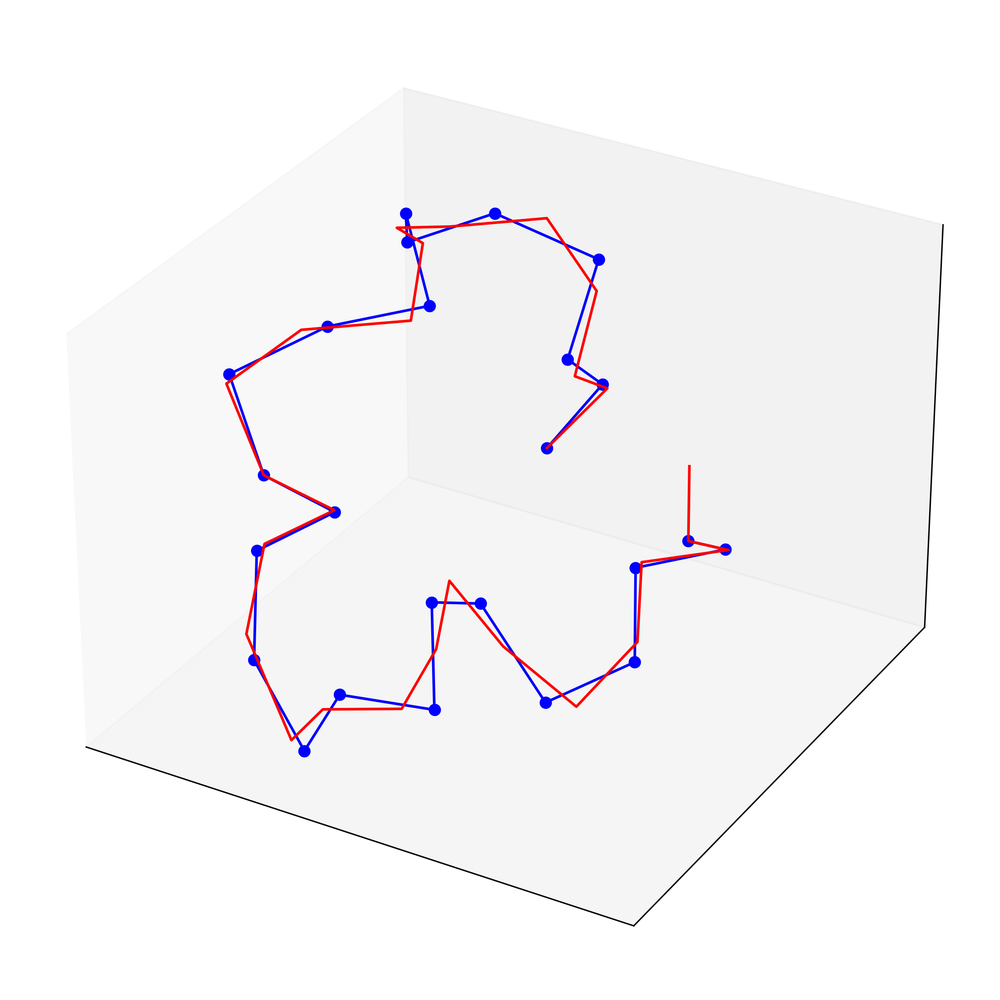

In [23]:
#This code requires same numbering of residues in all structures and that is why it is run after fitting
from matplotlib import pyplot as plt
from mpl_toolkits import mplot3d
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

import mdtraj as md


# Usage Example
xyz = md.load("Results/activation_segments/CA_segments/mustang/1A9U_A.pdb")

DFG = xyz.top.to_fasta()[0].find("DFG")
APE = xyz.top.to_fasta()[0].find("APE")+2
atoms = sum([[atom.index for atom in res.atoms if atom.name == "CA"] for res in xyz.top._residues[:]],[])

coords = xyz.xyz[0,atoms].T
x = coords[0]
y = coords[1]
z = coords[2]
new_coords = md.load("Results/fitted_matlab_segments/mustangs_noRealignment/1A9U_A.pdb")

atoms = sum([[atom.index for atom in res.atoms if atom.name == "CA"] for res in new_coords.top._residues[:]],[])
new_coords = new_coords.xyz[0,atoms].T
xp = new_coords[0]
yp = new_coords[1]
zp = new_coords[2]

fig = plt.figure(figsize=(10,10))
ax = plt.axes(projection='3d')
ax.plot3D(x,y,z, 'blue',marker="o")
ax.plot3D(xp, yp, zp, 'red')
plt.tick_params(bottom=False, top=False, labelbottom=False)
ax.set_xticks([])
ax.set_yticks([])
ax.set_zticks([])

In [ ]:
from pymol import cmd
import os
from glob import glob
import numpy as np
import matplotlib.pyplot as plt
import shutil  # For copying non-outlier PDB files

###############################################################################
# Function to print details of a selection
###############################################################################
def print_selection_details(selection_name):
    print(f"Details for selection: {selection_name}")
    cmd.iterate(selection_name, "print(resi, resn, name)")
    count = cmd.count_atoms(selection_name)
    print(f"Number of atoms in {selection_name}: {count}")

###############################################################################
# Function to process a single directory of fitted PDBs
###############################################################################
def process_directory(fitted_pdb_dir, directory_label):
    """
    Processes all PDB files in 'fitted_pdb_dir', measuring:
      - Euclidean distance (single-atom) for first and last CA vs. reference
      - RMSD (3 CA) for first three and last three CA vs. reference
    
    If 'directory_label' is "Ends Realignment", then:
      - Create a new directory "mustangs_endsRealignment_noOutliers/" with all
        structures from 'fitted_pdb_dir' except those that have distance > 3 Å
        for either the first or the last atom.
      - Mark y=3 Å on the single-atom violin plot with a red dotted line labeled "outlier cutoff".
    """
    # Re-initialize PyMOL to clear out any previous state
    cmd.reinitialize()

    # Load reference structure (change path/name if needed)
    reference_pdb = "6UAN_chainD.pdb"
    cmd.load(reference_pdb, "6UAN_chainD")

    # Create selections for the reference structure
    cmd.select("6UAN_chainD_first_atom", "6UAN_chainD and resi 594 and name CA")
    cmd.select("6UAN_chainD_last_atom",  "6UAN_chainD and resi 623 and name CA")
    print_selection_details("6UAN_chainD_first_atom")
    print_selection_details("6UAN_chainD_last_atom")

    cmd.select("6UAN_chainD_first3", "6UAN_chainD and resi 594-596 and name CA")
    cmd.select("6UAN_chainD_last3",  "6UAN_chainD and resi 621-623 and name CA")
    print_selection_details("6UAN_chainD_first3")
    print_selection_details("6UAN_chainD_last3")

    # Prepare lists to store distances/RMSDs
    euclid_first_atom = []   # single CA (treated as Euclidean distance)
    euclid_last_atom  = []   # single CA (treated as Euclidean distance)
    rmsd_first3_atoms = []   # 3 CA
    rmsd_last3_atoms  = []   # 3 CA

    # Gather PDB files in specified fitted directory
    fitted_pdb_files = glob(os.path.join(fitted_pdb_dir, "*.pdb"))
    total_structures = len(fitted_pdb_files)
    print(f"\nProcessing directory ({directory_label}): {fitted_pdb_dir}")
    print(f"Found {total_structures} PDB files.\n")

    # Keep track of structures with large distances on first/last CA (> 2.5 Å, as originally coded)
    structures_with_large_euclid_first = []
    structures_with_large_euclid_last  = []

    # Loop over each fitted PDB
    for fitted_pdb_file in fitted_pdb_files:
        print(f"Processing file: {fitted_pdb_file}")
        pdb_code = os.path.basename(fitted_pdb_file).split('.')[0]

        # Load the fitted structure
        cmd.load(fitted_pdb_file, pdb_code)

        # Selections for single-atom
        cmd.select(f"{pdb_code}_first_atom", f"{pdb_code} and resi 593 and name CA")
        cmd.select(f"{pdb_code}_last_atom",  f"{pdb_code} and resi 619 and name CA")

        # Selections for 3-atom group
        cmd.select(f"{pdb_code}_first3_atoms", f"{pdb_code} and resi 593-595 and name CA")
        cmd.select(f"{pdb_code}_last3_atoms",  f"{pdb_code} and resi 617-619 and name CA")

        # Print selection details
        print_selection_details(f"{pdb_code}_first_atom")
        print_selection_details(f"{pdb_code}_last_atom")
        print_selection_details(f"{pdb_code}_first3_atoms")
        print_selection_details(f"{pdb_code}_last3_atoms")

        # Calculate Euclidean distance (single-atom “RMSD” from PyMOL is effectively the direct distance)
        # 1) First atom
        try:
            d_first = cmd.rms_cur(f"{pdb_code}_first_atom", "6UAN_chainD_first_atom", matchmaker=-1)
            print(f"Euclidean distance (first atom) for {pdb_code} vs. reference: {d_first:.2f} Å")
            euclid_first_atom.append(d_first)
            if d_first > 2.5:
                structures_with_large_euclid_first.append(pdb_code)
        except:
            print(f"Error calculating distance for {pdb_code}_first_atom")
            euclid_first_atom.append(np.nan)

        # 2) Last atom
        try:
            d_last = cmd.rms_cur(f"{pdb_code}_last_atom", "6UAN_chainD_last_atom", matchmaker=-1)
            print(f"Euclidean distance (last atom)  for {pdb_code} vs. reference: {d_last:.2f} Å")
            euclid_last_atom.append(d_last)
            if d_last > 2.5:
                structures_with_large_euclid_last.append(pdb_code)
        except:
            print(f"Error calculating distance for {pdb_code}_last_atom")
            euclid_last_atom.append(np.nan)

        # Calculate RMSD for 3 atoms
        # 3) First three atoms
        try:
            rms_first3 = cmd.rms_cur(f"{pdb_code}_first3_atoms", "6UAN_chainD_first3", matchmaker=-1)
            print(f"RMSD (first 3 atoms) for {pdb_code} vs. reference: {rms_first3:.2f} Å")
            rmsd_first3_atoms.append(rms_first3)
        except:
            print(f"Error calculating RMSD for {pdb_code}_first3_atoms")
            rmsd_first3_atoms.append(np.nan)

        # 4) Last three atoms
        try:
            rms_last3 = cmd.rms_cur(f"{pdb_code}_last3_atoms", "6UAN_chainD_last3", matchmaker=-1)
            print(f"RMSD (last 3 atoms)  for {pdb_code} vs. reference: {rms_last3:.2f} Å")
            rmsd_last3_atoms.append(rms_last3)
        except:
            print(f"Error calculating RMSD for {pdb_code}_last3_atoms")
            rmsd_last3_atoms.append(np.nan)

        # Remove the loaded structure from PyMOL to keep things tidy
        cmd.delete(pdb_code)
        cmd.delete(f"{pdb_code}_first_atom")
        cmd.delete(f"{pdb_code}_last_atom")
        cmd.delete(f"{pdb_code}_first3_atoms")
        cmd.delete(f"{pdb_code}_last3_atoms")

    # Summaries for large distances from single-atom comparisons
    print("\nStructures with Euclidean distance > 2.5 Å (first atom):")
    print(structures_with_large_euclid_first)
    print("Structures with Euclidean distance > 2.5 Å (last atom):")
    print(structures_with_large_euclid_last)

    # Percentages
    num_large_first = len(structures_with_large_euclid_first)
    num_large_last  = len(structures_with_large_euclid_last)
    pct_large_first = (num_large_first / total_structures) * 100 if total_structures > 0 else 0.0
    pct_large_last  = (num_large_last / total_structures) * 100 if total_structures > 0 else 0.0
    print(f"\nNumber of structures > 2.5 Å (first atom): {num_large_first}")
    print(f"Percentage: {pct_large_first:.2f}%")
    print(f"Number of structures > 2.5 Å (last atom): {num_large_last}")
    print(f"Percentage: {pct_large_last:.2f}%")

    ############################################################################
    # Identify outliers for the 3 Å cutoff and copy non-outliers if "Ends Realignment"
    ############################################################################
    # We'll mark any structure outlier if first_atom > 3.0 OR last_atom > 3.0.
    outliers_3A = []
    for i, pdb_file in enumerate(fitted_pdb_files):
        if euclid_first_atom[i] > 3.0 or euclid_last_atom[i] > 3.0:
            outliers_3A.append(pdb_file)
    
    if directory_label == "Ends Realignment":
        # Make the new directory for non-outliers
        no_outliers_dir = "Results/fitted_matlab_segments/mustangs_endsRealignment_noOutliers/"
        os.makedirs(no_outliers_dir, exist_ok=True)

        # Copy all pdb files that are NOT outliers
        for i, pdb_file in enumerate(fitted_pdb_files):
            if pdb_file not in outliers_3A:
                shutil.copy2(pdb_file, no_outliers_dir)

    ###########################################################################
    # Plot 1: Single-atom as Euclidean distance (violin plot)
    ###########################################################################
    single_atom_data = [euclid_first_atom, euclid_last_atom]
    single_atom_labels = ["First Atom", "Last Atom"]

    fig_euclid, ax_euclid = plt.subplots()
    ax_euclid.violinplot(single_atom_data)
    ax_euclid.set_xticks(np.arange(1, len(single_atom_labels) + 1))
    ax_euclid.set_xticklabels(single_atom_labels)
    ax_euclid.set_ylabel("Euclidean Distance (Å)")
    ax_euclid.set_title(f"Single-Atom Comparison\n{directory_label}")
    ax_euclid.set_ylim(0, 5)  # Focus on 0–5 Å

    # If Ends Realignment, add a dotted red line at 3 Å labeled "outlier cutoff"
    if directory_label == "Ends Realignment":
        ax_euclid.axhline(y=3.0, color='red', linestyle=':', label='Outlier cutoff')
        ax_euclid.legend()

    # Save the figure in the same directory
    euclid_plot_path = os.path.join(fitted_pdb_dir, "single_atom_violin.png")
    fig_euclid.savefig(euclid_plot_path, dpi=300, bbox_inches="tight")
    plt.close(fig_euclid)

    ###########################################################################
    # Plot 2: Three-atom RMSD (violin plot)
    ###########################################################################
    triple_atom_data = [rmsd_first3_atoms, rmsd_last3_atoms]
    triple_atom_labels = ["First Three Atoms", "Last Three Atoms"]

    fig_rmsd, ax_rmsd = plt.subplots()
    ax_rmsd.violinplot(triple_atom_data)
    ax_rmsd.set_xticks(np.arange(1, len(triple_atom_labels) + 1))
    ax_rmsd.set_xticklabels(triple_atom_labels)
    ax_rmsd.set_ylabel("RMSD (Å)")
    ax_rmsd.set_title(f"Three-Atom Comparison\n{directory_label}")
    ax_rmsd.set_ylim(0, 5)

    # Save the figure in the same directory
    rmsd_plot_path = os.path.join(fitted_pdb_dir, "three_atom_violin.png")
    fig_rmsd.savefig(rmsd_plot_path, dpi=300, bbox_inches="tight")
    plt.close(fig_rmsd)

    # Finally, remove the reference structure so we can re-run for the next directory
    cmd.delete("6UAN_chainD")
    cmd.delete("6UAN_chainD_first_atom")
    cmd.delete("6UAN_chainD_last_atom")
    cmd.delete("6UAN_chainD_first3")
    cmd.delete("6UAN_chainD_last3")

###############################################################################
# Main script - process directories
###############################################################################
if __name__ == "__main__":
    cases = [
        ("Results/fitted_matlab_segments/mustangs_endsRealignment/", "Ends Realignment"),
        ("Results/fitted_matlab_segments/mustangs_noRealignment/",  "No Realignment"),
        ("Results/fitted_matlab_segments/mustangs_conserved_secondary/", "Secondary structure Realignment")
    ]

    # Process each directory
    for dpath, label in cases:
        process_directory(dpath, label)

    # cmd.quit()

In [11]:
# def braf_res():
#     folder = "Results/fitted_matlab_segments/DFGalignedTrials"
#     pdb_files = glob.glob(os.path.join(folder, "*.pdb"))
#     if not pdb_files:
#         raise IOError(f"No .pdb files found in '{folder}'.")

#     all_residues = set()  # to store unique residue names
#     for fp in pdb_files:
#         traj = md.load(fp)
#         top = traj.topology
#         for res in top.residues:
#             all_residues.add(res.name)

#     # Return a list, sorted for convenience
#     return sorted(list(all_residues))

# def PCA_on_files(file_list):
#     '''
#     Perform PCA on a list of files and returns components and projections
#     CHECKED
#     '''
#     print("Number of files to load:", len(file_list))
#     print("Files:", file_list)

#     # Get data
#     traj = md.join([md.load(f) for f in file_list])
# #     traj = trajs[0]
# #     for t in trajs[1:]:
# #         traj = traj.join(t)
#     xyz = traj.xyz.reshape(-1,3*traj.n_atoms)
#     # Perform PCA
#     pca = PCA(n_components=4) #WHY 4 AND NOT 2?
#     proj = pca.fit_transform(xyz)
#     return pca,proj

# def plot_scores(cur_pca,n_comps=4):
#     scores = cur_pca.components_.reshape(-1,27,3)[:n_comps]
#     x_labels = braf_res()
#     x_vals = [*range(len(scores[0]))]
#     col = ["red","blue","green","yellow"]
#     exp_var = cur_pca.explained_variance_
#     fig,axes = plt.subplots(n_comps,sharex=True)
    
#     for i in range(n_comps):
#         axes[i].plot(x_vals,norm(scores[i]*exp_var[i],axis=1),marker=".",c=col[i])
#     axes[i].set_xticks([*range(len(x_labels))])
#     _ = axes[i].set_xticklabels(x_labels,rotation=90)
#     plt.tight_layout()
#     return fig,axes

# # def pdb_id(fp):
# #     return fp.rsplit(".",1)[0].rsplit("/",1)[1]

# def pdb_id(fp):
#     # "/home/user/file.pdb" -> "file.pdb"
#     filename = os.path.basename(fp)
#     # "file.pdb" -> ("file", ".pdb")
#     base, ext = os.path.splitext(filename)
#     return base

In [19]:
def braf_res(folder):
    pdb_files = glob.glob(os.path.join(folder, "*.pdb"))
    if not pdb_files:
        raise IOError(f"No .pdb files found in '{folder}'.")

    all_residues = set()  # to store unique residue names
    for fp in pdb_files:
        traj = md.load(fp)
        top = traj.topology
        for res in top.residues:
            all_residues.add(res.name)

    # Return a list, sorted for convenience
    return sorted(list(all_residues))

def PCA_on_files(file_list):
    '''
    Perform PCA on a list of files and returns components and projections
    CHECKED
    '''
    print("Number of files to load:", len(file_list))
    print("Files:", file_list)

    # Get data
    traj = md.join([md.load(f) for f in file_list])
#     traj = trajs[0]
#     for t in trajs[1:]:
#         traj = traj.join(t)
    xyz = traj.xyz.reshape(-1,3*traj.n_atoms)
    # Perform PCA
    pca = PCA(n_components=4) #WHY 4 AND NOT 2?
    proj = pca.fit_transform(xyz)
    return pca,proj

def plot_scores(cur_pca,n_comps=4,folder="Results/fitted_matlab_segments/mustangs_endsRealignment"):
    scores = cur_pca.components_.reshape(-1,27,3)[:n_comps]
    x_labels = braf_res(folder)
    x_vals = [*range(len(scores[0]))]
    col = ["red","blue","green","yellow"]
    exp_var = cur_pca.explained_variance_
    fig,axes = plt.subplots(n_comps,sharex=True)
    
    for i in range(n_comps):
        axes[i].plot(x_vals,norm(scores[i]*exp_var[i],axis=1),marker=".",c=col[i])
    axes[i].set_xticks([*range(len(x_labels))])
    _ = axes[i].set_xticklabels(x_labels,rotation=90)
    plt.tight_layout()
    return fig,axes

# def pdb_id(fp):
#     return fp.rsplit(".",1)[0].rsplit("/",1)[1]

def pdb_id(fp):
    # "/home/user/file.pdb" -> "file.pdb"
    filename = os.path.basename(fp)
    # "file.pdb" -> ("file", ".pdb")
    base, ext = os.path.splitext(filename)
    return base


In [3]:
import numpy as np
import os
import mdtraj as md
import pickle as p
from matplotlib import pyplot as plt
from glob import glob
from sklearn.decomposition import PCA
from numpy.linalg import norm
import glob

ImportError: DLL load failed while importing _imaging: 找不到指定的模块。

In [29]:
"""
Load Files
"""
import sys
FITTED_PDB_PATH_PREFIX = "Results/fitted_matlab_segments/"
FITTED_PDB_PATH_ROOT = ["mustangs_noRealignment","mustangs_endsRealignment","mustangs_endsRealignment_noOutliers","mustangs_conserved_secondary"]

def load_files_and_plot(fun):
    for ROOT in FITTED_PDB_PATH_ROOT:
        PATH = FITTED_PDB_PATH_PREFIX+ROOT
        f = open('LOG-'+ROOT+'.txt', 'w')
        sys.stdout = f

        fits = sorted([os.path.abspath(fp) for fp in glob.glob(PATH + "/*.pdb")])
        names = [pdb_id(fp) for fp in fits]
        print(fits)
        """
        Perform PCA over all fits
        """
        all_pca,all_trans = PCA_on_files(fits)
        all_fig,all_axes = plot_scores(all_pca,folder=PATH)
        all_axes[0].set_title(f"PCA scores across all fitted PDBs--{ROOT}")
        plt.savefig(f"./scores--{ROOT}.png",bbox_inches='tight',dpi=600)
        explained_var_ratios = all_pca.explained_variance_ratio_ * 100
        for i, ratio in enumerate(explained_var_ratios, 1):
            print(f"PC{i} explains {ratio:.2f}% of the variance.")

        fun(all_trans, n_clusters=2,type=ROOT)
        sys.stdout = sys.__stdout__
        f.close()
        

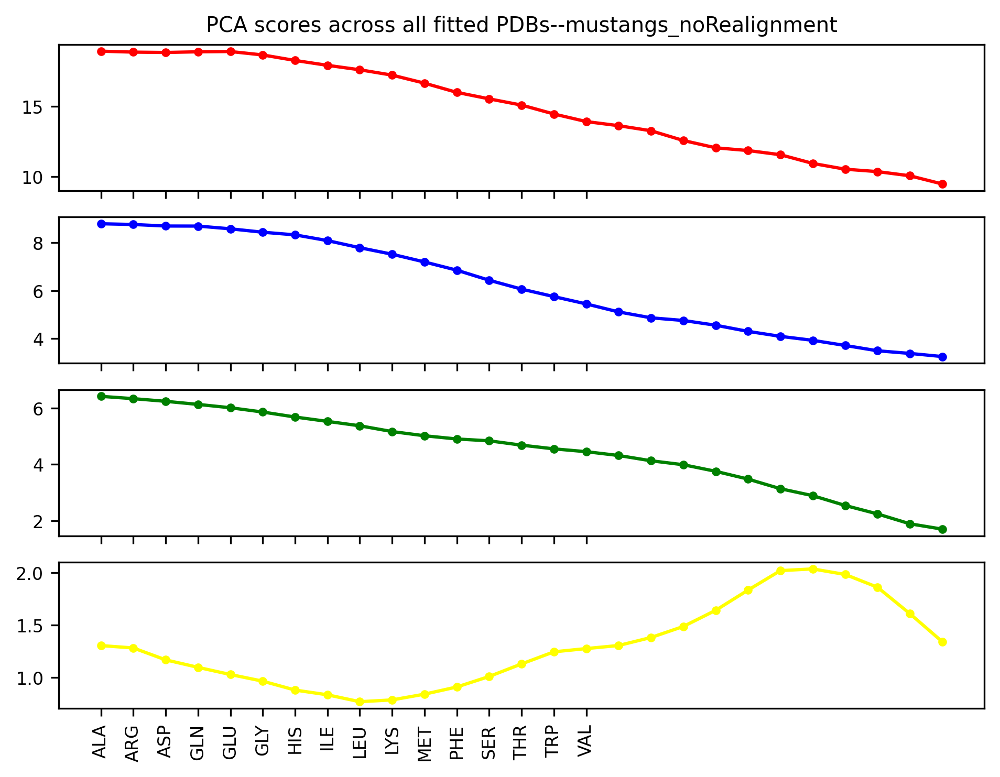

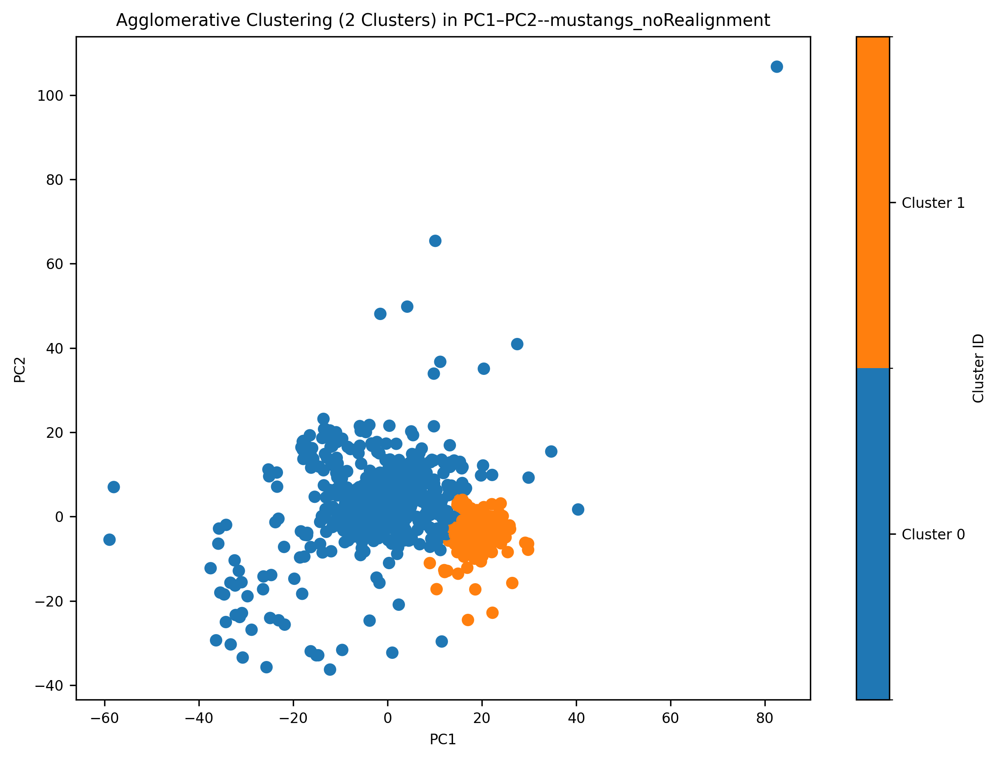

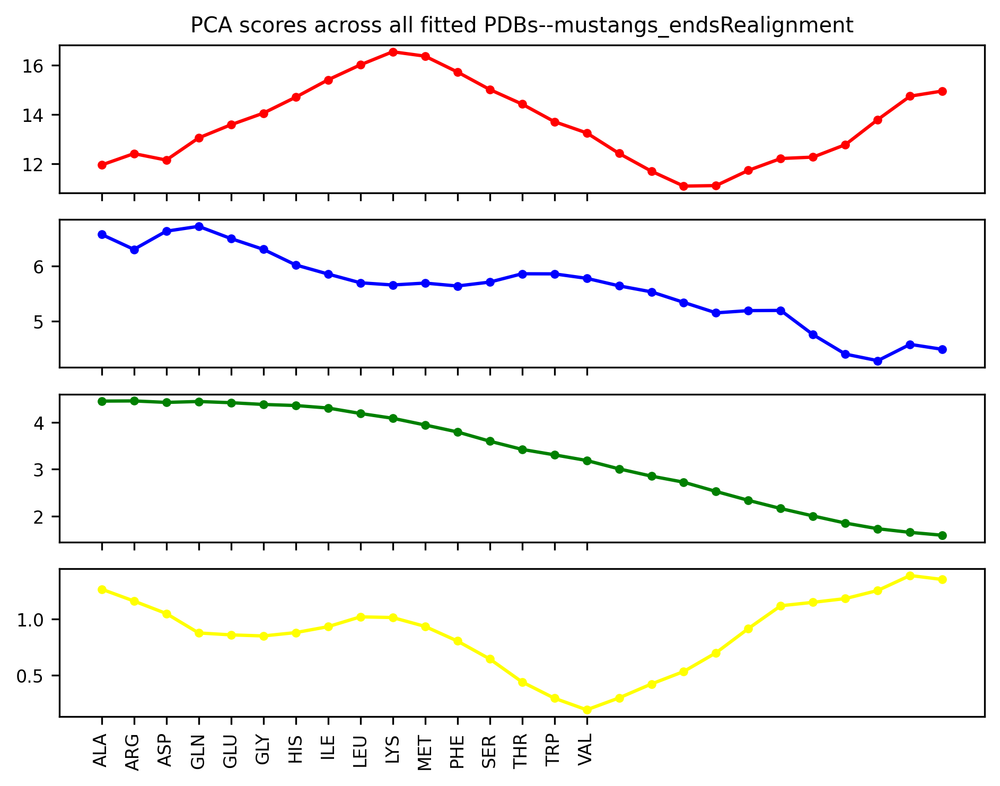

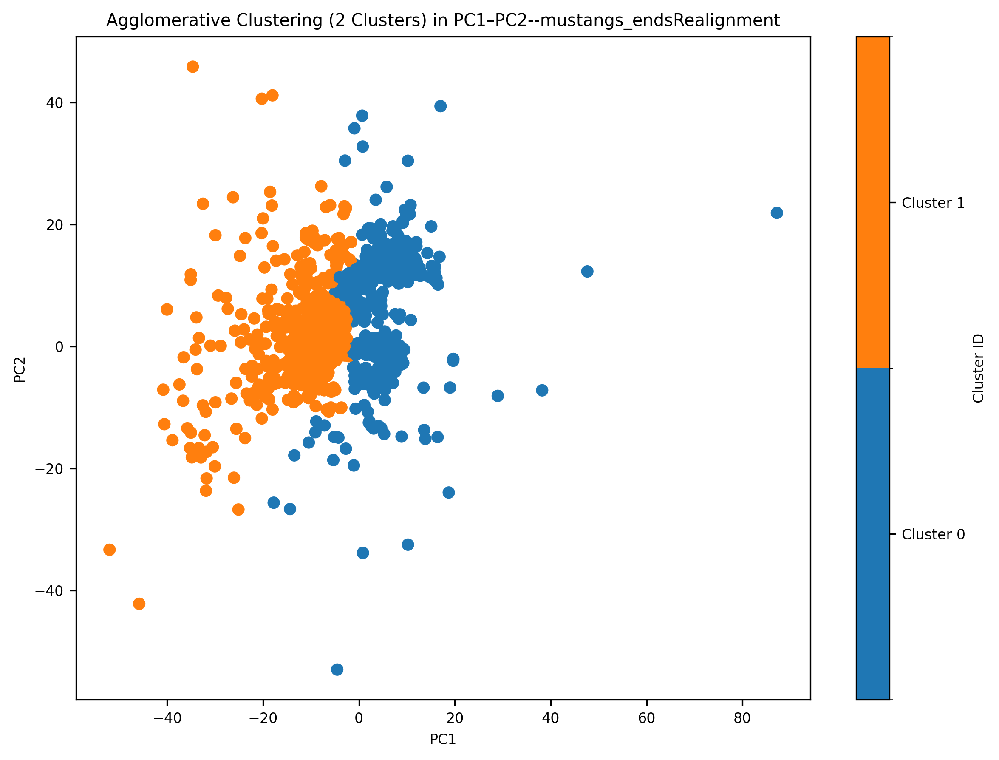

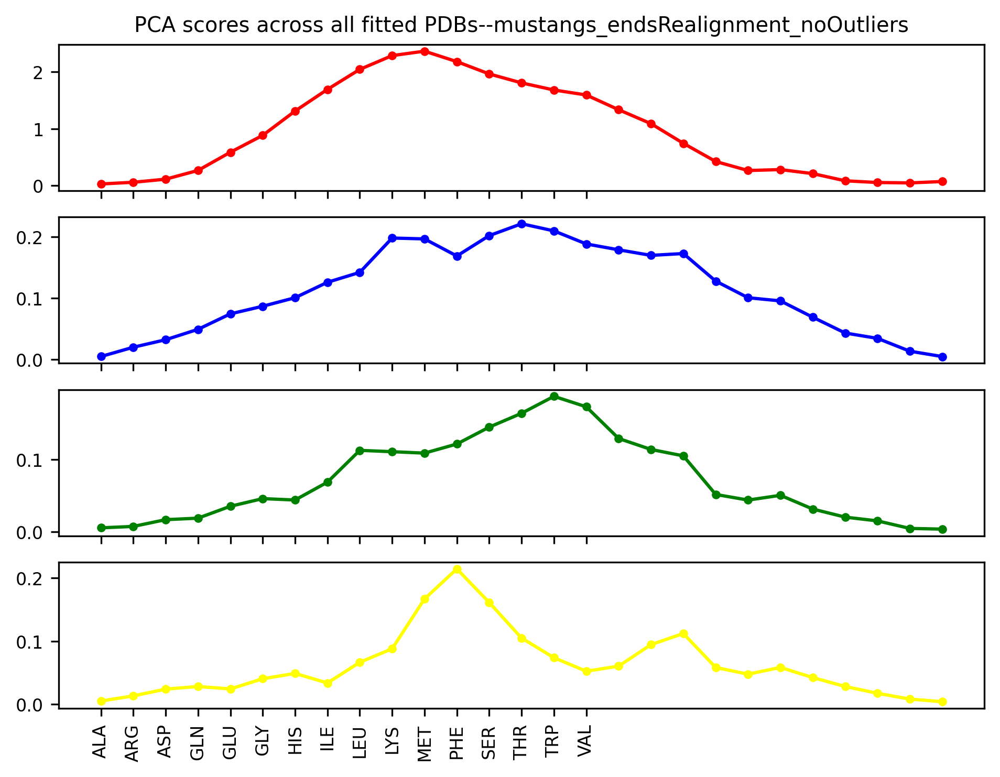

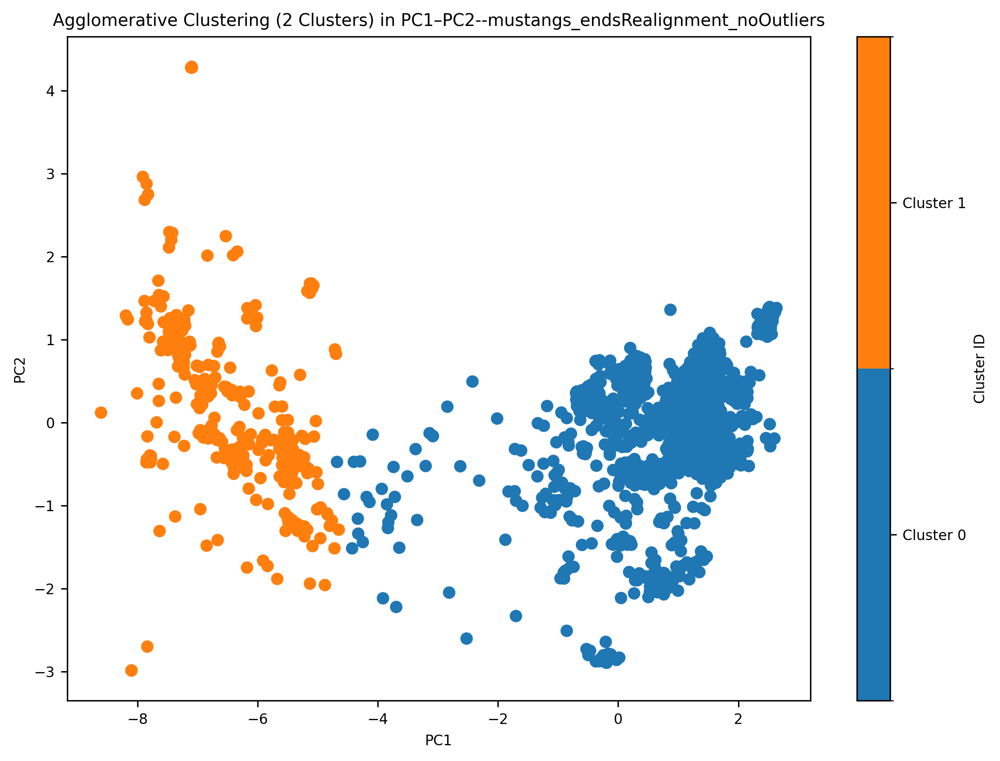

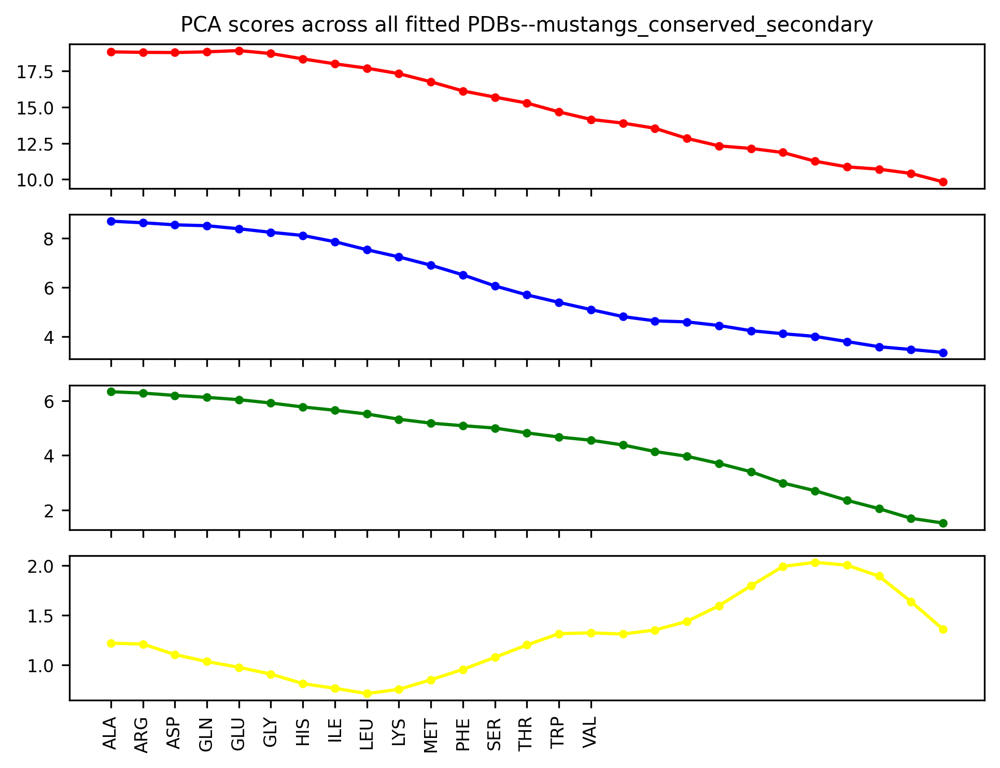

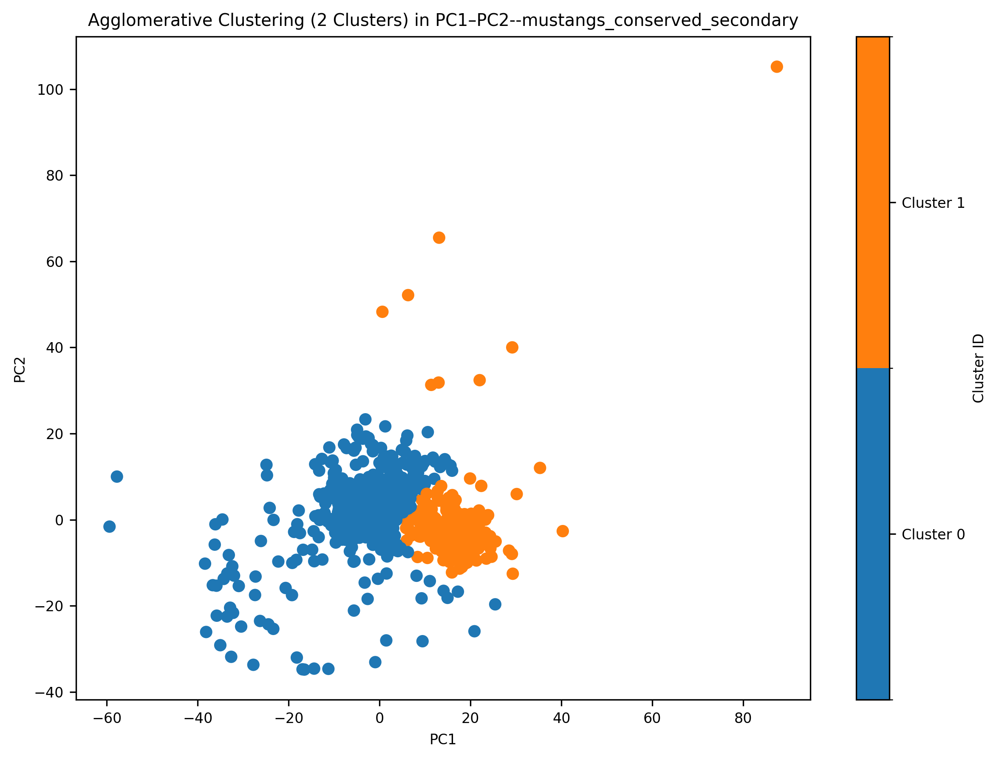

In [30]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.cluster import AgglomerativeClustering
from matplotlib.colors import BoundaryNorm

def cluster_and_plot(all_trans, n_clusters=2, type=""):
    """
    all_trans: 2D or more, where columns are principal components 
               (e.g., shape [num_samples, num_components]).
    n_clusters: number of clusters for AgglomerativeClustering.
    """
    # 1) Fit hierarchical clustering on first two PCs
    hier_clust = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    cluster_labels = hier_clust.fit_predict(all_trans[:, :2])
    
    # 2) Prepare discrete color boundaries: [0, 1, 2] if we have 2 clusters 
    #    or range(n_clusters+1) for a general number of clusters
    bounds = list(range(n_clusters + 1))  
    norm = BoundaryNorm(bounds, ncolors=n_clusters, clip=True)

    # 3) Plot PC1 vs. PC2, colored by cluster label
    fig, ax = plt.subplots(figsize=(8, 6))
    scatter = ax.scatter(
        all_trans[:, 0], 
        all_trans[:, 1],
        c=cluster_labels,
        cmap='tab10',   # or 'Set1', 'Paired', etc.
        norm=norm
    )
    
    # 4) Create a discrete colorbar
    #    Place ticks between integer boundaries (e.g., 0.5, 1.5 for 2 clusters)
    tick_positions = [x + 0.5 for x in range(n_clusters)]
    cbar = plt.colorbar(scatter, spacing="proportional", ticks=tick_positions)
    # Label each cluster
    cbar.ax.set_yticklabels([f"Cluster {i}" for i in range(n_clusters)])
    cbar.set_label("Cluster ID")

    # 5) Label axes, add title
    ax.set_xlabel("PC1")
    ax.set_ylabel("PC2")
    ax.set_title(f"Agglomerative Clustering ({n_clusters} Clusters) in PC1–PC2--{type}")
    
    plt.tight_layout()
    plt.savefig("hier_clustering_colored.png", dpi=300)


load_files_and_plot(cluster_and_plot)

In [1]:
import torch
availablity = torch.cuda.is_available()
print(f"GPU availablity: {availablity}")
if availablity:
    print(f"Pytorch cuda version: {torch.version.cuda}")

GPU availablity: True
Pytorch cuda version: 11.8


In [4]:
import sys, os
sys.path.insert(0, os.path.join(os.path.abspath(os.pardir),'src'))
from molearn.data import PDBData
from molearn.trainers import Trainer
from molearn.models.small_foldingnet import Small_AutoEncoder
import torch
import MDAnalysis as mda
import numpy as np
print(f"GPU availablity: {torch.cuda.is_available()}")

GPU availablity: True


In [3]:
import sys, os
sys.path.insert(0, os.path.join(os.path.abspath(os.pardir),'src'))
from molearn.data import PDBData
from molearn.trainers import Trainer
from molearn.models.small_foldingnet import Small_AutoEncoder
import torch
import MDAnalysis as mda
import numpy as np

def ifnotmake(dir_path):
    if not os.path.isdir(dir_path):
        os.makedirs(dir_path)
    return dir_path


def model_train(PREFIX,ROOT,TRIAL_PREFIX):

    data = PDBData()

    folder_name = PREFIX+ROOT+"/"
    ifnotmake(folder_name)

    # Get a sorted list of all files in the directory, EXCLUDING combined.pdb
    files = sorted([
        f for f in os.listdir(folder_name) 
        if os.path.isfile(os.path.join(folder_name, f)) and f != 'combined.pdb' and not f.endswith('.png')
    ])

    combined_file_path = os.path.join(folder_name, 'combined.pdb')

    # Open in write mode to overwrite or create a fresh combined.pdb
    with open(combined_file_path, 'w') as combined_file:
        for i, filename in enumerate(files):
            file_path = os.path.join(folder_name, filename)

            # Read content while filtering out lines starting with "MODEL" or "END"
            with open(file_path, 'r') as file:
                print(file_path)
                lines = file.readlines()
                lines = [line for line in lines if not line.startswith(("MODEL", "END"))]

            # Write "MODEL i", then filtered lines, then "ENDMDL"
            combined_file.write(f'MODEL {i}\n')
            combined_file.writelines(lines)
            combined_file.write('ENDMDL\n')
        
        combined_file.write('END\n')

    # Now import combined.pdb without having to delete it each run
    data.import_pdb(filename=combined_file_path)
    data.fix_terminal()
    data.atomselect(atoms=['CA', 'C', 'N', 'CB', 'O'])
    data.prepare_dataset()
    print(data._mol)

    ##### Prepare Trainer #####
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    trainer = Trainer(device=device)
    trainer.set_data(data, batch_size=8, validation_split=0.1, manual_seed=25)
    trainer.set_autoencoder(Small_AutoEncoder, out_points=data.dataset.shape[-1])
    trainer.prepare_optimiser()

    ##### Training Loop #####
    # Keep training until loss does not improve for 32 consecutive epochs
    # runkwargs = dict(
    #     log_filename='log_file.dat',
    #     log_folder='{TARGET_PREFIX}/xbb_foldingnet_checkpoints',
    #     checkpoint_folder='{TARGET_PREFIX}',
    # )
    trial_folder = TRIAL_PREFIX + ROOT
    ifnotmake(trial_folder+"/")
    LOG_FOLDER = 'xbb_foldingnet_checkpoints'
    runkwargs = dict(
        log_filename = 'log_file.dat',
        log_folder = trial_folder+"/"+LOG_FOLDER,
        checkpoint_folder = trial_folder,
    )
    best = 1e24
    while True:
        trainer.run(max_epochs=32 + trainer.epoch, **runkwargs)
        if not best > trainer.best:
            break
        best = trainer.best
    print(f'best {trainer.best}, best_filename {trainer.best_name}')

if __name__ == '__main__':
    PREFIX = "Results/fitted_matlab_segments/"
    TRIAL_PREFIX = 'Results/run_trial_BRAF/'
    ROOT = 'mustangs_endsRealignment_noOutliers'
    model_train(PREFIX,ROOT,TRIAL_PREFIX)

Results/fitted_matlab_segments/mustangs_endsRealignment_noOutliers/1A9U_A_aligned.pdb
Results/fitted_matlab_segments/mustangs_endsRealignment_noOutliers/1AD5_A_aligned.pdb
Results/fitted_matlab_segments/mustangs_endsRealignment_noOutliers/1AD5_B_aligned.pdb
Results/fitted_matlab_segments/mustangs_endsRealignment_noOutliers/1APM_E_filled_aligned.pdb
Results/fitted_matlab_segments/mustangs_endsRealignment_noOutliers/1ATP_E_filled_aligned.pdb
Results/fitted_matlab_segments/mustangs_endsRealignment_noOutliers/1BI7_A_aligned.pdb
Results/fitted_matlab_segments/mustangs_endsRealignment_noOutliers/1BI8_A_aligned.pdb
Results/fitted_matlab_segments/mustangs_endsRealignment_noOutliers/1BI8_C_aligned.pdb
Results/fitted_matlab_segments/mustangs_endsRealignment_noOutliers/1BKX_A_filled_aligned.pdb
Results/fitted_matlab_segments/mustangs_endsRealignment_noOutliers/1BL6_A_aligned.pdb
Results/fitted_matlab_segments/mustangs_endsRealignment_noOutliers/1BL7_A_aligned.pdb
Results/fitted_matlab_segments/mu

In [1]:
import sys, os
sys.path.insert(0, os.path.join(os.path.abspath(os.pardir),'src'))
from molearn.data import PDBData
from molearn.trainers import Trainer
from molearn.models.small_foldingnet import Small_AutoEncoder
import torch
import MDAnalysis as mda
import numpy as np
torch.cuda.is_available()

False

In [1]:
import molearn
from molearn.analysis.analyser import MolearnAnalysis
from molearn.data import PDBData
from molearn.models.small_foldingnet import Small_AutoEncoder

import pandas as pd

import torch
from copy import deepcopy
import biobox as bb
import numpy as np
import glob as glob

import MDAnalysis as mda

ROOT = "mustangs_endsRealignment_noOutliers"
file_pattern = 'Results/run_trial_BRAF/'+ROOT+'/checkpoint*.ckpt'
currenct_file = 0

print(glob.glob(file_pattern))
# Get a sorted list of all matching checkpoint files
matching_files = sorted(glob.glob(file_pattern))

# Check if we found any matches
if len(matching_files) == 0:
    raise FileNotFoundError(f"No files matched the pattern: {file_pattern}")

# Example 1: Grab the first matching file
networkfile = matching_files[currenct_file]

# Example 2 (Alternative): Grab the last matching file (e.g., if it’s the most recent)
# networkfile = matching_files[-1]

# Load the checkpoint
checkpoint = torch.load(networkfile, map_location=torch.device('cpu'))
net = Small_AutoEncoder(**checkpoint['network_kwargs'])
net.load_state_dict(checkpoint['model_state_dict'])

# Print some info
print("Matched files:", matching_files)
print("Using file:", networkfile)
print("Network kwargs:", checkpoint['network_kwargs'])

['Results/run_trial_BRAF/mustangs_endsRealignment_noOutliers\\checkpoint_1_epoch180_loss0.002382981964140473.ckpt', 'Results/run_trial_BRAF/mustangs_endsRealignment_noOutliers\\checkpoint_epoch150_loss0.0019345226057719902.ckpt']
Matched files: ['Results/run_trial_BRAF/mustangs_endsRealignment_noOutliers\\checkpoint_1_epoch180_loss0.002382981964140473.ckpt', 'Results/run_trial_BRAF/mustangs_endsRealignment_noOutliers\\checkpoint_epoch150_loss0.0019345226057719902.ckpt']
Using file: Results/run_trial_BRAF/mustangs_endsRealignment_noOutliers\checkpoint_1_epoch180_loss0.002382981964140473.ckpt
Network kwargs: {'out_points': 27}


In [2]:
PREFIX = 'Results/fitted_matlab_segments/'
ROOT = 'mustangs_endsRealignment_noOutliers/'

In [3]:
import os
data = PDBData()
folder_name = PREFIX+ROOT
combined_file_path = os.path.join(folder_name, 'combined.pdb')
data.import_pdb(filename=combined_file_path)
#data.import_pdb(f'data{os.sep}MurD_open_selection.pdb')
data.fix_terminal()
data.atomselect(atoms = ['CA', 'C', 'N', 'CB', 'O'])
data.prepare_dataset()

Dataset shape: torch.Size([3066, 3, 27])
mean: 110.87685043805482
 std: 20.4785281439029


In [4]:
MA = MolearnAnalysis()
MA.set_network(net)
data_train, data_valid = data.split(manual_seed=25)
MA.set_dataset("training", data_train)
MA.set_dataset("validation", data_valid)

def ifnotmake(dir_path):
    if not os.path.isdir(dir_path):
        os.makedirs(dir_path)
    return dir_path

In [5]:
ROOT = "mustangs_endsRealignment_noOutliers"

In [6]:
VERIFICATION_PREFIX = 'Results/run_trial_BRAF/'
TARGET_PREFIX = VERIFICATION_PREFIX+ROOT+'/'


data_train, data_valid = data.get_datasets(manual_seed=25)

indices = data.indices.numpy()

print(indices)

print(np.shape(data_train)[0])

train_indices = indices[:np.shape(data_train)[0]]

print(train_indices)

print(np.shape(data_train.numpy()))
ifnotmake(TARGET_PREFIX+'/getDatasetTrial/')
for i, index in enumerate(train_indices):

    print(index)

    data._mol.trajectory[index]  # Set the trajectory to the specific frame

    data._mol.select_atoms("name CA").write(f'{TARGET_PREFIX}/getDatasetTrial/s{i}.pdb')

[1160 1062 2132 ... 1191  687 2259]
2760
[1160 1062 2132 ... 2419  524 2787]
(2760, 3, 27)
1160
1062
2132
2603
845
2461
173
1335
3000
1759
295
329
176
1369
2907
920
1099
1408
1687
3055
2589
2207
334
2661
239
2935
1575
2290
505
290
805
2763
2885
120
1338
1679
915
2558
19
2674
1145
483
2484
169
2427
967
1011
2414
367
2693
2588
496
390
1461
1968
808
2222
2154
106
720
1642
2771
2235
1966
1859
2147
1434
832
2582
2396
2512
2802
1904
335
42
2050
2874
1646
2571
850
623
2513
2293
380
2887
2793
416
2939
1736
830
2561
2230
1414
978
2995
927
297
1727
2368
2298
2652
1973
2748
2694
3050
372
1287
1457
1041
2737
853
1312
1613
620
2537
44
2248
469
1833
1332
769
882
1951
553
531
187
2392
2462
459
2936
386
2389
579
93
1504
536
1353
129
2493
439
3009
3042
1761
1267
460
1164
1994
1104
140
70
1118
1964
1683
7
1150
2726
2452
1677
1991
2146
2157
2343
2288
1340
866
1493
382
1721
1931
2706
458
735
774
1685
834
2351
2328
1205
3003
1930
2698
440
2436
780
1825
2262
934
2953
2724
2423
1832
210
2079
734
2876
1032
14

In [7]:
directory_name = TARGET_PREFIX+'/decoded_train'

ifnotmake(directory_name)
# Use generate method which is public (no underscore)

latent_coords = MA.get_encoded('training')  # Example latent space coordinates

print(latent_coords)

crd_ref = MA.generate(latent_coords.numpy().reshape(1, len(latent_coords), 2), directory_name, relax=False)

encoding training: 100%|██████████████████████████████████████████████████████████| 2760/2760 [00:07<00:00, 392.87it/s]


tensor([[[ 18.2846],
         [171.4058]],

        [[116.9157],
         [-83.4904]],

        [[ 22.6324],
         [-52.3870]],

        ...,

        [[125.3043],
         [-82.7272]],

        [[ 38.4639],
         [-34.0543]],

        [[116.2439],
         [-77.6845]]])


Generating pdb files: 100%|███████████████████████████████████████████████████████| 2760/2760 [00:03<00:00, 834.83it/s]


In [8]:
print(list(MA.get_error('training', align=False)))

Decoding training: 100%|██████████████████████████████████████████████████████████| 2760/2760 [00:11<00:00, 232.68it/s]

[0.7704965124755225, 0.9350144958279051, 1.2798454767133411, 1.7975347269172242, 0.41023977461938016, 0.9234985690917116, 0.6227783559901813, 1.15491855703006, 1.2109375583370654, 0.5043233874832672, 0.2839124893793326, 3.632350752215959, 0.6082373684188234, 0.9652412340548372, 1.9916094925608914, 1.169084254168581, 0.28009308592230653, 3.5655017126777038, 1.425495585522035, 0.49078474240731085, 0.7432198585450743, 0.352265346914247, 3.6540277145105864, 1.1880438379147849, 0.8351759566180723, 0.7863522444714864, 0.5362283487336639, 0.8719603202675945, 0.47029696795976483, 0.560051285802183, 0.8411197979824366, 1.4104232840521307, 0.6569410718742116, 0.5532936568634043, 0.8796816120812675, 1.0771344190592023, 1.0424186196510483, 0.8122356886935278, 0.4819354534990056, 0.401645222747031, 0.8790347208703965, 0.6007744571070452, 0.982766498476748, 0.42699754054849925, 0.812095389192119, 1.315309185837809, 1.5772530329344423, 0.49589175352974385, 0.4022705274862567, 1.1312658438013101, 0.81

In [9]:
import os
import re
import MDAnalysis as mda
import MDAnalysis.analysis.rms as rms

# Directories
getDatasetTrial_dir = TARGET_PREFIX+'/getDatasetTrial/'
decoded_train_dir = TARGET_PREFIX+'/decoded_train'

# List all files in the directories
getDatasetTrial_files = os.listdir(getDatasetTrial_dir)
decoded_train_files = os.listdir(decoded_train_dir)

# Filter files that start with 's' in decoded_train
decoded_train_files = [f for f in decoded_train_files if f.startswith('s')]

# Function to extract the numerical part from a file name
def extract_number(file_name):
    match = re.search(r'\d+', file_name)
    return int(match.group()) if match else float('inf')

# Sort the file names based on the numerical part
getDatasetTrial_files.sort(key=extract_number)
decoded_train_files.sort(key=extract_number)

# Calculate RMSD for files with the same name
rmsd_values = {}

for file_name in getDatasetTrial_files:
    if file_name in decoded_train_files:
        # Load the universes
        u1 = mda.Universe(os.path.join(getDatasetTrial_dir, file_name))
        u2 = mda.Universe(os.path.join(decoded_train_dir, file_name))
        
        # Select CA atoms
        ag1 = u1.select_atoms("name CA")
        ag2 = u2.select_atoms("name CA")
        
        # Calculate RMSD
        rmsd_value = rms.rmsd(ag1.positions, ag2.positions)
        rmsd_values[file_name] = rmsd_value

# Print RMSD values in sorted order
for file_name in sorted(rmsd_values.keys(), key=extract_number):
    print(f"RMSD for {file_name}: {rmsd_values[file_name]}")


RMSD for s0.pdb: 0.7705175956759057
RMSD for s1.pdb: 0.9349791820187131
RMSD for s2.pdb: 1.2799200805198905
RMSD for s3.pdb: 1.7974716025618647
RMSD for s4.pdb: 0.4101898559243063
RMSD for s5.pdb: 0.9235066020123943
RMSD for s6.pdb: 0.6227978334687925
RMSD for s7.pdb: 1.1549297647724188
RMSD for s8.pdb: 1.2108879407404578
RMSD for s9.pdb: 0.5042918146496226
RMSD for s10.pdb: 0.28389526229817164
RMSD for s11.pdb: 3.632310137722826
RMSD for s12.pdb: 0.6081768186335844
RMSD for s13.pdb: 0.9653137070434318
RMSD for s14.pdb: 1.9917621700293482
RMSD for s15.pdb: 1.1690156468027681
RMSD for s16.pdb: 0.2801268911400721
RMSD for s17.pdb: 3.5654426926828786
RMSD for s18.pdb: 1.4254553168932074
RMSD for s19.pdb: 0.49077751545787623
RMSD for s20.pdb: 0.7432827200456548
RMSD for s21.pdb: 0.3522651483714193
RMSD for s22.pdb: 3.654086397580912
RMSD for s23.pdb: 1.1880150247521746
RMSD for s24.pdb: 0.8351663139825447
RMSD for s25.pdb: 0.7862279348147836
RMSD for s26.pdb: 0.5361961569507468
RMSD for s2

In [10]:
MA.batch_size = 8
MA.processes = 4

In [11]:
import cctbx

saveName = '_foldingnet_checkpoint'

#saveName = directory.replace('_foldingnet_checkpoint', '')
err_train = MA.get_error('training')
df_err_train = pd.DataFrame(err_train, columns=['err_train'])
df_err_train.to_csv(f'{TARGET_PREFIX}/err_train_{saveName}.csv', index=False)

err_test = MA.get_error('validation')
df_err_test = pd.DataFrame(err_test, columns=['err_test'])
df_err_test.to_csv(f'{TARGET_PREFIX}/err_valid_{saveName}.csv', index=False)

#DOPE score
dope_train_data = MA.get_dope('training')
dope_test_data = MA.get_dope('validation')

#dope_error_training=np.absolute(dope_train_data['dataset_dope']-dope_train_data['decoded_dope'])
#dope_error_test=np.absolute(dope_test_data['dataset_dope']-dope_test_data['decoded_dope'])

dope_training = dope_train_data['decoded_dope']
dope_test = dope_test_data['dataset_dope']

df_dope_train = pd.DataFrame(dope_training, columns=['dope_train'])
df_dope_train.to_csv(f'{TARGET_PREFIX}/dope_train_{saveName}.csv', index=False)
df_dope_test = pd.DataFrame(dope_test, columns=['dope_test'])
df_dope_test.to_csv(f'{TARGET_PREFIX}/dope_valid_{saveName}.csv', index=False)

# Ramachandran scores
rama_train_data = MA.get_ramachandran('training') 
rama_test_data = MA.get_ramachandran('validation')

Calc rama: 100%|█████████████████████████████████████████████████████████████████████████████| 306/306 [00:00<?, ?it/s]


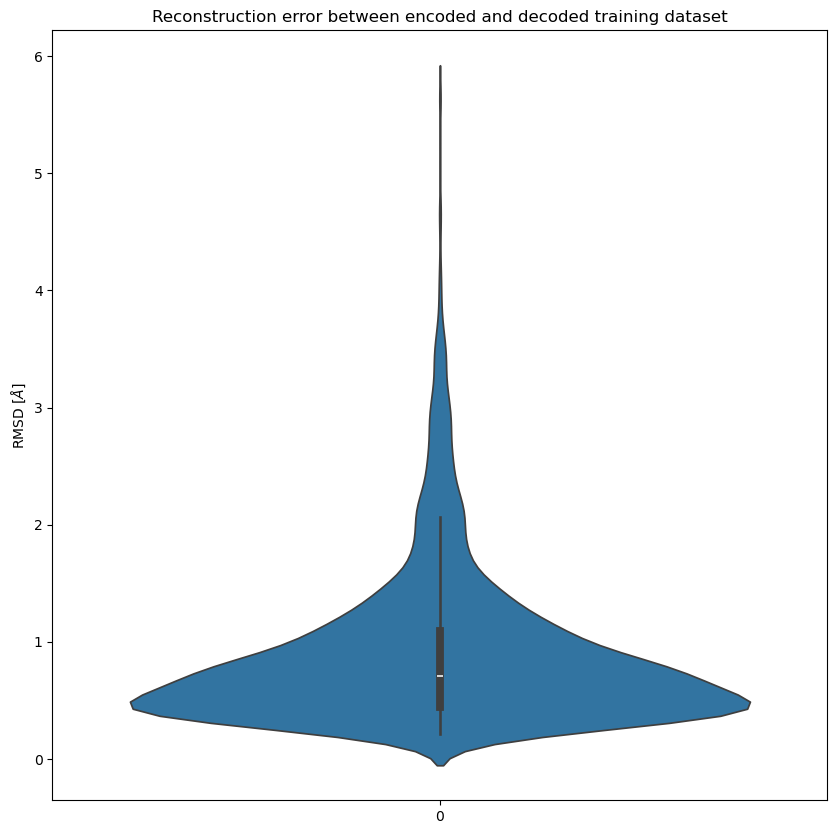

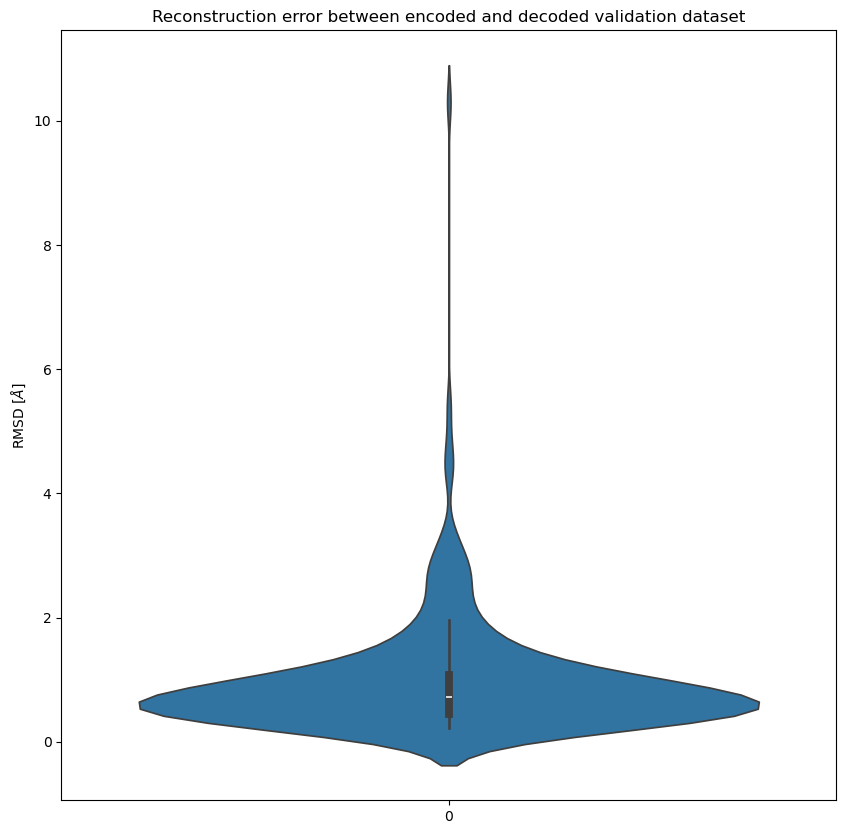

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt
data = [err_train]
f = plt.figure(figsize=(10, 10))
sns.violinplot(data)
plt.ylabel('RMSD [$\AA$]')
plt.title('Reconstruction error between encoded and decoded training dataset')
plt.show()
f.savefig(f'{TARGET_PREFIX}/err_train_{saveName}.png', dpi=300)


data = [err_test]
f = plt.figure(figsize=(10, 10))
sns.violinplot(data)
plt.ylabel('RMSD [$\AA$]')
plt.title('Reconstruction error between encoded and decoded validation dataset')
plt.show()
f.savefig(f'{TARGET_PREFIX}/err_test_{saveName}.png', dpi=300)

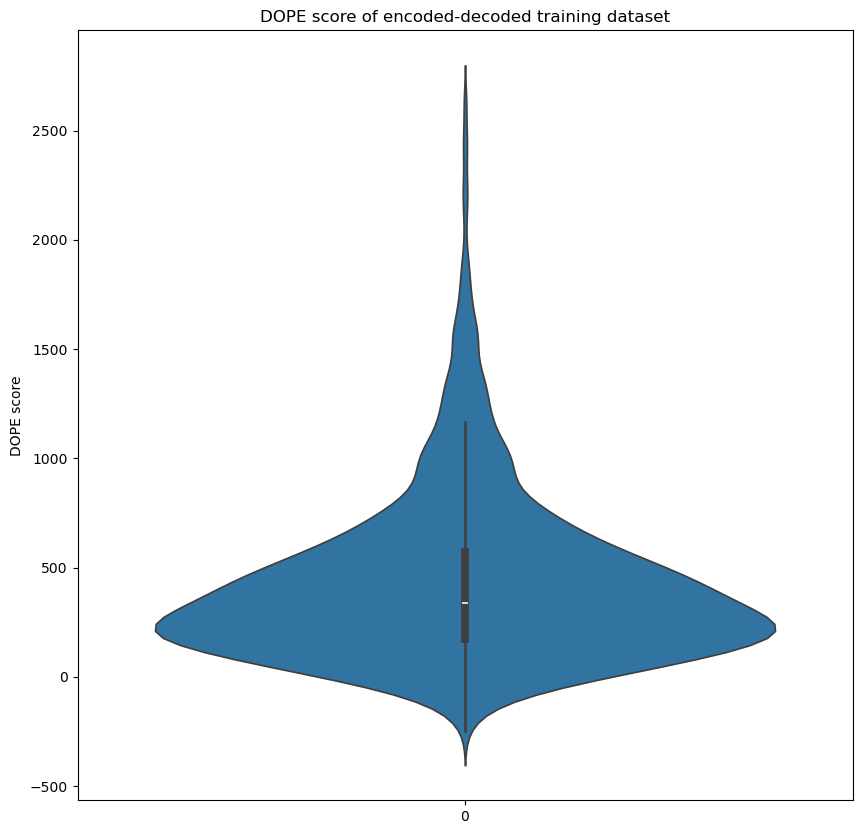

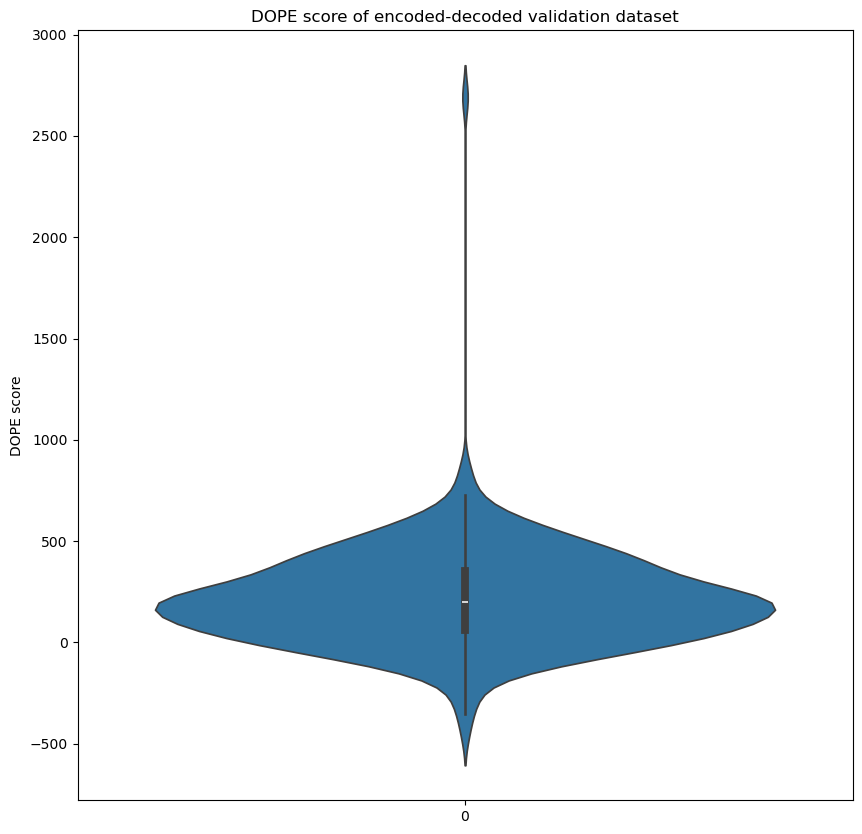

In [13]:
data = [dope_training]
f = plt.figure(figsize=(10, 10))
sns.violinplot(data)
plt.ylabel('DOPE score')
plt.title('DOPE score of encoded-decoded training dataset')
plt.show()
f.savefig(f'{TARGET_PREFIX}/dope_train_{saveName}.png', dpi=300)

data = [dope_test]
f = plt.figure(figsize=(10, 10))
sns.violinplot(data)
plt.ylabel('DOPE score')
plt.title('DOPE score of encoded-decoded validation dataset')
plt.show()
f.savefig(f'{TARGET_PREFIX}/dope_test_{saveName}.png', dpi=300)

In [14]:
MA.setup_grid(30)
landscape_err_latent, landscape_err_3d, xaxis, yaxis = MA.scan_error()
df_landscape_err_latent = pd.DataFrame(landscape_err_latent)
df_landscape_err_latent.to_csv(f'{TARGET_PREFIX}/landscape_err_latent_{saveName}.csv', index=False)
'''
df= pd.read_csv(f'landscape_err_latent_{saveName}.csv')
print(df.shape)
'''

df_landscape_err_3d = pd.DataFrame(landscape_err_3d)
df_landscape_err_3d.to_csv(f'{TARGET_PREFIX}/landscape_err_3d_{saveName}.csv', index=False)

df_xaxis = pd.DataFrame(xaxis)
df_xaxis.to_csv(f'{TARGET_PREFIX}/landscape_err_xaxis_{saveName}.csv', index=False)

df_yaxis = pd.DataFrame(yaxis)
df_yaxis.to_csv(f'{TARGET_PREFIX}/landscape_err_yaxis_{saveName}.csv', index=False)

Decoding grid_decoded: 100%|█████████████████████████████████████████████████████████| 113/113 [00:01<00:00, 72.65it/s]


In [15]:
landscape_dope_unrefined, xaxis, yaxis = MA.scan_dope(refine=False)
df_landscape_dope_unrefined = pd.DataFrame(landscape_dope_unrefined)
df_landscape_dope_unrefined.to_csv(f'landscape_dope_unrefined_{saveName}.csv', index=False)
df_xaxis_dope = pd.DataFrame(xaxis)
df_xaxis_dope.to_csv(f'{TARGET_PREFIX}/landscape_dope_xaxis_{saveName}.csv', index=False)

df_yaxis_dope = pd.DataFrame(yaxis)
df_yaxis_dope.to_csv(f'{TARGET_PREFIX}/landscape_dope_yaxis_{saveName}.csv', index=False)


Calc Dope: 100%|███████████████████████████████████████████████████████████████████| 900/900 [00:00<00:00, 1357.53it/s]


In [17]:
from molearn.analysis import MolearnGUI
MolearnGUI(MA);